In [1]:
!pip install setuptools


In [2]:
cd C:\Users\willi\actt\src


C:\Users\willi\actt\src


In [3]:
!python setup.py develop


running develop
running egg_info
writing CAN_objects.egg-info\PKG-INFO
writing dependency_links to CAN_objects.egg-info\dependency_links.txt
writing top-level names to CAN_objects.egg-info\top_level.txt
reading manifest file 'CAN_objects.egg-info\SOURCES.txt'
writing manifest file 'CAN_objects.egg-info\SOURCES.txt'
running build_ext
Creating c:\users\willi\miniconda3\lib\site-packages\CAN-objects.egg-link (link to .)
CAN-objects 0.4.0 is already the active version in easy-install.pth

Installed c:\users\willi\actt\src
Processing dependencies for CAN-objects==0.4.0
Finished processing dependencies for CAN-objects==0.4.0


C:\Users\willi\miniconda3\Lib\site-packages\setuptools\command\develop.py:40: EasyInstallDeprecationWarning: easy_install command is deprecated.
!!

        ********************************************************************************
        Please avoid running ``setup.py`` and ``easy_install``.
        Instead, use pypa/build, pypa/installer, pypa/build or
        other standards-based tools.

        See https://github.com/pypa/setuptools/issues/917 for details.
        ********************************************************************************

!!
  easy_install.initialize_options(self)
C:\Users\willi\miniconda3\Lib\site-packages\setuptools\_distutils\cmd.py:66: SetuptoolsDeprecationWarning: setup.py install is deprecated.
!!

        ********************************************************************************
        Please avoid running ``setup.py`` directly.
        Instead, use pypa/build, pypa/installer, pypa/build or
        other standards-based tools.

        

In [4]:
!pip install bitstring
!pip install seaborn
!pip install cantools
import os 
import sys
import numpy as np
from collections import defaultdict
import CAN_objects.aid_message
import matplotlib.pyplot as plt
%matplotlib inline
from generalFunctions import unpickle
import subprocess

import importlib
importlib.reload(CAN_objects.aid_message)

<module 'CAN_objects.aid_message' from 'C:\\Users\\willi\\actt\\src\\CAN_objects\\aid_message.py'>

In [5]:
import os
import sys

sys.path.insert(0, os.path.dirname(os.getcwd()) + "/code/")
!pip install opencv-python
!pip install helper_functions
import helper_functions
!pip install networkx
import networkx

!pip install tqdm
from tqdm import tqdm

import numpy as np
import pandas as pd
from scipy.integrate import quad

import matplotlib.pyplot as plt
%matplotlib inline

import json
import fnmatch
import scipy

!pip install scikit-learn
from sklearn.metrics import auc
from sklearn.covariance import EllipticEnvelope


In [62]:
# path for log file 'C:\Users\willi\OneDrive\Desktop\Research\oak_ridge_in_vehicle\road'
file = 'C:\\Users\\willi\\OneDrive\\Desktop\\Research\\oak_ridge_in_vehicle\\road\\ambient\\ambient_dyno_drive_basic_long.log'


### Calling out make_can_df

In [63]:
def make_can_df(log_filepath):

    can_df = pd.read_fwf(
        log_filepath, delimiter = ' '+ '#' + '('+')',
        skiprows = 1,skipfooter=1,
        usecols = [0,2,3],
        dtype = {0:'float64', 1:str, 2: str},
        names = ['time','pid', 'data'] )

    can_df.pid = can_df.pid.apply(lambda x: int(x,16))
    can_df.data = can_df.data.apply(lambda x: x.zfill(16)) #pad with 0s on the left for data with dlc < 8
    can_df.time = can_df.time - can_df.time.min()
    return can_df[can_df.pid<=0x700]

In [64]:
# Read the log file and parse the contents into a DataFrame
df = make_can_df(file)
df

,time,pid,data
0,0.000000,813,0000042758010000
1,0.001019,1694,0440047E1FC01542
2,0.001020,293,9000401F41BE7960
3,0.002916,737,0000000000000004
4,0.003937,852,1FFF40000003B680
...,...,...,...
2991265,1250.942507,1505,893FE00B0A000080
2991266,1250.942508,1413,0040000000020018
2991267,1250.943525,51,0007A0000E0007D0
2991268,1250.943526,628,00F208F7107C81DD


In [65]:
# Read the log file and parse the contents into a DataFrame
df = make_can_df(file)
df

       time   pid              data
0  0.000000   813  0000042758010000
1  0.001019  1694  0440047E1FC01542
2  0.001020   293  9000401F41BE7960
3  0.002916   737  0000000000000004
4  0.003937   852  1FFF40000003B680
Index(['time', 'pid', 'data'], dtype='object')


In [66]:
# Print the first few rows and the column names of the DataFrame
df = make_can_df(file)
print(df.head())
print(df.columns)


In [67]:
# Divide the sorted DataFrame into time slices of duration 10.0 and print each slice along with its label
time_slice_duration = 10.0
num_slices = int(df_sorted['time'].max() / time_slice_duration) + 1
for i in range(num_slices):
    start_time = i * time_slice_duration
    end_time = (i + 1) * time_slice_duration
    time_slice_label = f"Time Slice {i + 1}: ({start_time}, {end_time}]"
    time_slice_df = df_sorted[(df_sorted['time'] > start_time) & (df_sorted['time'] <= end_time)]
    print(f"{time_slice_label}\n{time_slice_df}\n")


Time Slice 1: (0.0, 10.0]
        time   pid              data
9       0.01  1255  0000001703520000
10      0.01   339  00000004000C0004
12      0.01   661  0000000000000840
13      0.01  1634  4F20000040000000
14      0.01  1668  54D580194147501E
...      ...   ...               ...
23919  10.00   737  0000000000000004
23920  10.00   852  1FF1C0000005A280
23921  10.00  1505  893FE00B0A016480
23922  10.00   354  00080593EA11F4CE
23923  10.00   167  0010FA69512820A0

[22405 rows x 3 columns]

Time Slice 2: (10.0, 20.0]
        time   pid              data
23924  10.01  1255  0000001703520000
23925  10.01   339  00000000000C000A
23927  10.01  1634  4F20000040000000
23928  10.01  1668  54D580194147501E
23929  10.01  1590  24760000EE8A8000
...      ...   ...               ...
47834  20.00   737  0000000000000004
47835  20.00   852  1FE2400000075680
47836  20.00  1505  893FE00B0A00B480
47837  20.00   354  000802D3EA11F4CE
47838  20.00   167  0010FAE9512820A0

[22405 rows x 3 columns]

Time 

Time Slice 31: (300.0, 310.0]
          time   pid              data
717389  300.01   661  0000000000001840
717390  300.01  1634  4F00000040000000
717391  300.01  1668  54D680194147901E
717392  300.01  1590  24760000EE8C8000
717393  300.01   727  100060D800000008
...        ...   ...               ...
741292  310.00   167  00510927911EA0A0
741293  310.00   722  000056BE8000000B
741294  310.00  1760  13E113CA13D713E0
741295  310.00   813  0000042758010000
741296  310.00    14  205E160208097CBC

[22399 rows x 3 columns]

Time Slice 32: (310.0, 320.0]
          time   pid              data
741297  310.01  1255  0000001A034F0000
741298  310.01   339  00000000000C000A
741300  310.01  1634  4E00000040000000
741301  310.01  1668  50D482994147901E
741302  310.01  1590  24762AC1058B7000
...        ...   ...               ...
765198  320.00  1372  116800001326300A
765199  320.00  1760  17E017D317FD17FA
765200  320.00   813  0000042758010000
765201  320.00    14  205DD60208097AF8
765202  320.00  

Time Slice 61: (600.0, 610.0]
           time   pid              data
1434663  600.01   412  046E2011820029A0
1434664  600.01   208  127C0460C70B2800
1434665  600.01    51  000380000C88A7D0
1434666  600.01   628  00F202FA107C8DB9
1434667  600.01   192  6000000000000000
...         ...   ...               ...
1458572  610.00  1668  50D779594165901E
1458573  610.00  1590  2476C700F008B000
1458574  610.00   727  100060D800000008
1458575  610.00   705  01F2CFC7C81F18F4
1458576  610.00   412  14642010C20029A0

[22406 rows x 3 columns]

Time Slice 62: (610.0, 620.0]
           time   pid              data
1458577  610.01   208  527C0460F60DEF00
1458578  610.01    51  0002A0000E89E7D0
1458579  610.01   628  00F20AF2107C8DAF
1458580  610.01   192  6000000000000000
1458581  610.01   996  00CC000005000000
...         ...   ...               ...
1482488  620.00  1634  4F80000040000000
1482489  620.00  1668  50D779594165901E
1482490  620.00  1590  2476C700F00AC000
1482491  620.00   727  100060D800

Time Slice 79: (780.0, 790.0]
           time  pid              data
1865189  780.01  727  100060D800000008
1865190  780.01  412  0482200F020028E0
1865191  780.01  208  12790462631E7900
1865192  780.01   51  1F8881FE3C8EA7D0
1865193  780.01  628  58F222FA107C8D95
...         ...  ...               ...
1889106  790.00  412  1492200B020029A0
1889107  790.00   14  2060160208097B66
1889108  790.00  208  527C0460E31EF100
1889109  790.00   51  000130000E8CC7D0
1889110  790.00  628  00F20AF2107C8D95

[22412 rows x 3 columns]

Time Slice 80: (790.0, 800.0]
           time   pid              data
1889111  790.01   737  0000000000000004
1889112  790.01   852  20AAC00000066A80
1889113  790.01  1505  892FA00B0A00AC80
1889114  790.01  1760  1ACA1AB31AD71AC5
1889115  790.01   192  6000000000000000
...         ...   ...               ...
1913014  800.00   208  127C0460AF1E2D00
1913015  800.00    14  205FD60208097AC8
1913016  800.00    51  000150000C8D07D0
1913017  800.00   628  00F202FA107C8D95
19130

Time Slice 106: (1050.0, 1060.0]
            time   pid              data
2510735  1050.01    51  000790000E8007D0
2510736  1050.01   628  00F20AF2107C8DCB
2510737  1050.01   961  7B551FBBE480292E
2510738  1050.01  1760  0597059105A305A1
2510739  1050.01   192  6000000000000000
...          ...   ...               ...
2534636  1060.00   412  05021FFF420029A0
2534637  1060.00   208  127C0464D3042300
2534638  1060.00    51  0007D0000C8007D0
2534639  1060.00   852  201600000000DE00
2534640  1060.00  1505  892A200B0A00B080

[22396 rows x 3 columns]

Time Slice 107: (1060.0, 1070.0]
            time   pid              data
2534641  1060.01   651  0000000000000000
2534642  1060.01   628  00F202FA107C8DD7
2534643  1060.01  1760  0396039603970396
2534644  1060.01   192  6000000000000000
2534645  1060.01   186  0698024410000278
...          ...   ...               ...
2558541  1070.00   208  527C04644803A700
2558542  1070.00    51  000790000E8007D0
2558543  1070.00   628  00F20AF2107C8DD9
25585

Time Slice 122: (1210.0, 1220.0]
            time  pid              data
2893293  1210.01  192  2000000000000000
2893294  1210.01  186  069802C410000280
2893295  1210.01  354  000801A3EA11F4CE
2893296  1210.01  167  0010FAE89125C0A0
2893297  1210.01  675  00000003FEC03C00
...          ...  ...               ...
2917204  1220.00   14  2061560208097576
2917205  1220.00  412  0460201342002960
2917206  1220.00  208  127B0C600F00EB00
2917207  1220.00   51  0007D0000C8007D0
2917208  1220.00  628  00F202FC107C8673

[22406 rows x 3 columns]

Time Slice 123: (1220.0, 1230.0]
            time   pid              data
2917209  1220.01  1760  00AD00A400B900B9
2917210  1220.01   192  2000000000000000
2917211  1220.01   186  069802441000029C
2917212  1220.01   354  00080093EA11F4CE
2917213  1220.01   167  2010F9E88125B0A0
...          ...   ...               ...
2941123  1230.00    14  2061160208097558
2941124  1230.00  1590  24762400F089D000
2941125  1230.00   727  100060D800000008
2941126  1230.00 

### Building graphs for each time window

C:\Users\willi\AppData\Local\Temp\ipykernel_44268\2154935427.py:32: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(i)


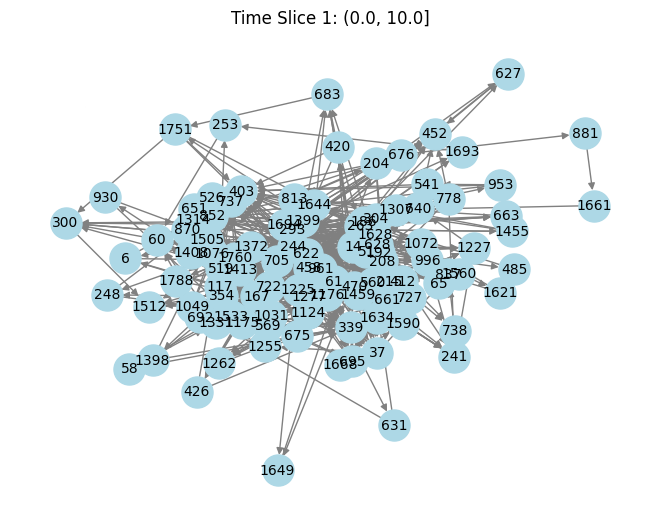

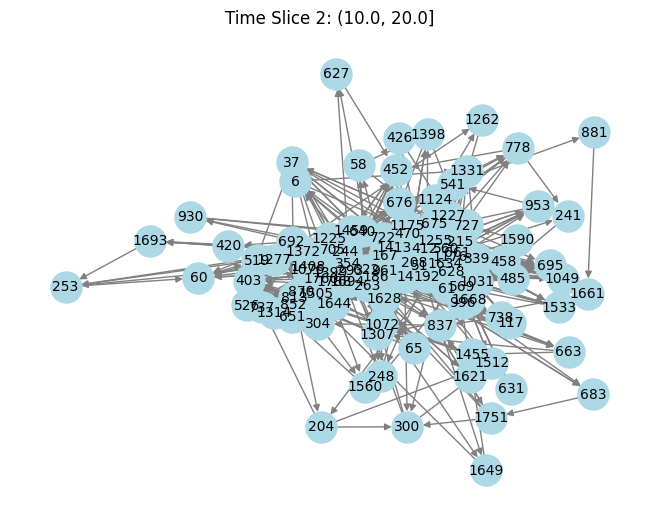

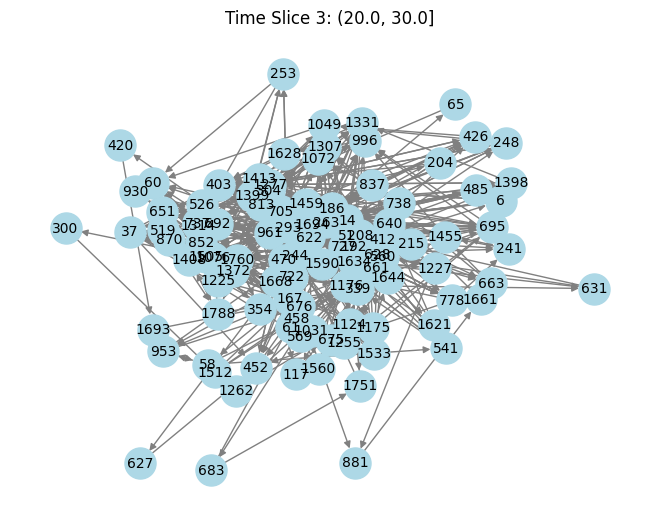

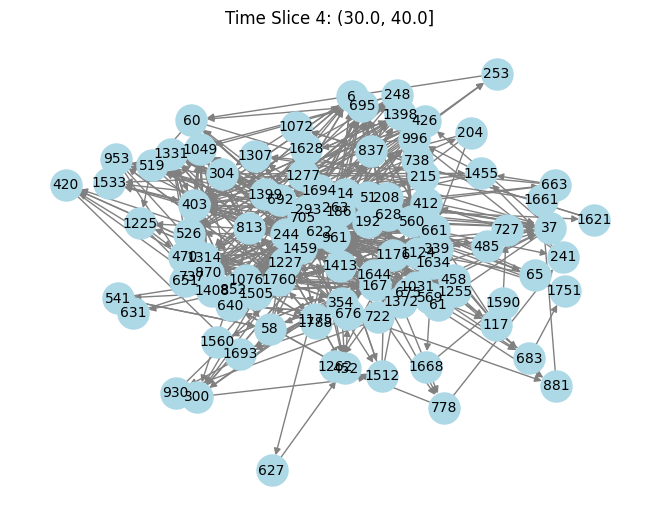

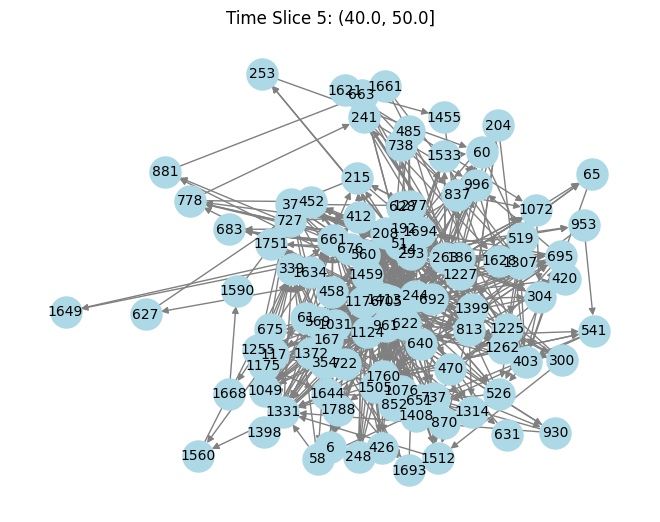

...

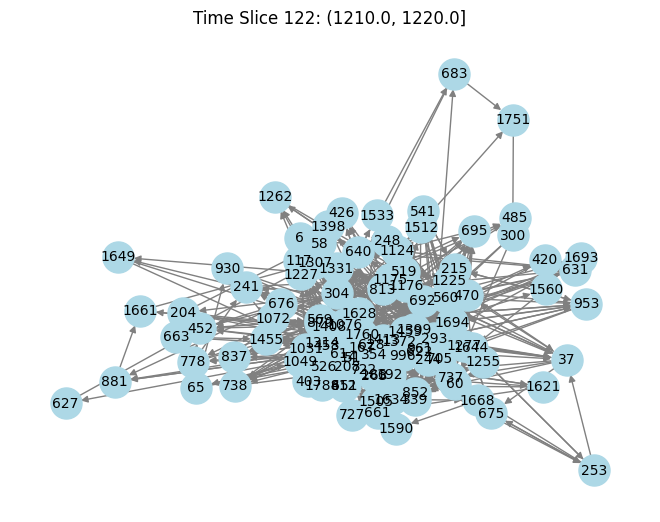

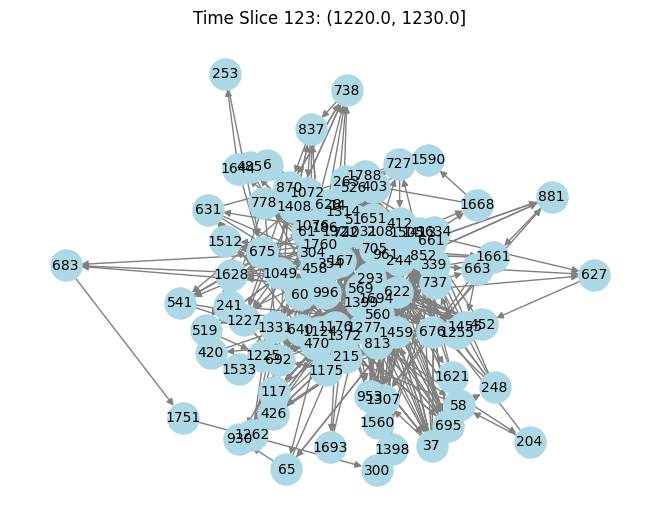

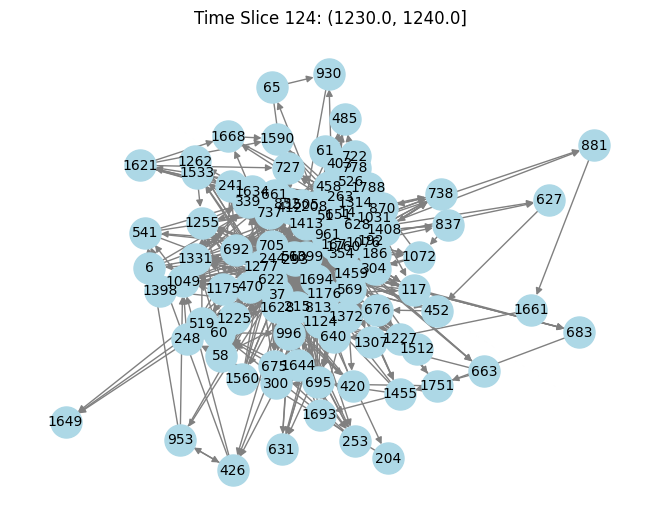

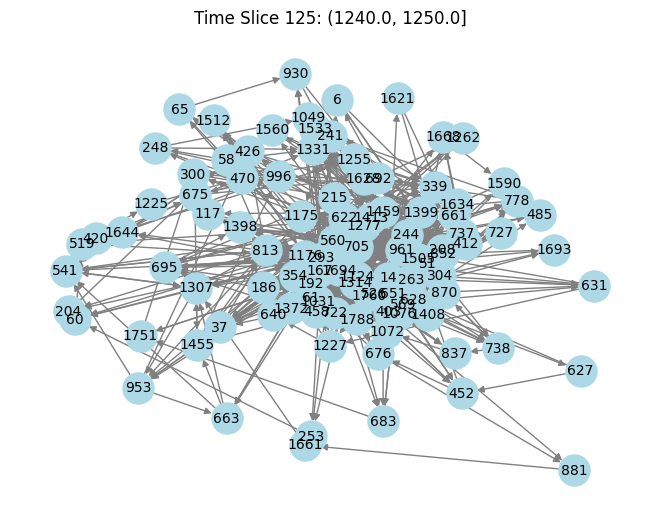

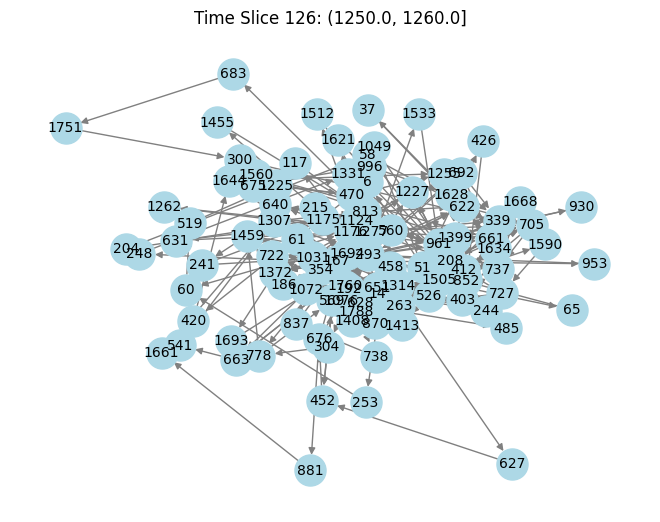

In [68]:
import networkx as nx
import matplotlib.pyplot as plt

# Define the time slice duration in seconds
time_slice_duration = 10.0

# Determine the number of time slices
num_slices = int(df['time'].max() / time_slice_duration) + 1

# Lists to store the number of nodes and edges for each time slice
nodes_count = []
edges_count = []

# Iterate over the time slices
for i in range(num_slices):
    start_time = i * time_slice_duration
    end_time = (i + 1) * time_slice_duration
    time_slice_label = f"Time Slice {i + 1}: ({start_time}, {end_time}]"
    time_slice_df = df[(df['time'] > start_time) & (df['time'] <= end_time)]

    # Build the graph for the current time slice
    G = nx.DiGraph()
    node_ids = time_slice_df['pid'].unique().tolist()
    G.add_nodes_from(node_ids)

    for j in range(len(time_slice_df) - 1):
        source = time_slice_df.iloc[j]['pid']
        target = time_slice_df.iloc[j+1]['pid']

        if G.has_edge(source, target):
            G[source][target]['weight'] += 1
        else:
            G.add_edge(source, target, weight=1)

    # Record the number of nodes and edges for this time slice
    nodes_count.append(len(G.nodes()))
    edges_count.append(len(G.edges()))

    # Plot the graph
    plt.figure(i)
    nx.draw(G, with_labels=True, node_color='lightblue', node_size=500, font_size=10, edge_color='gray')
    plt.title(time_slice_label)
    plt.text(0.05, 0.95, f'Nodes: {nodes_count[-1]}\nEdges: {edges_count[-1]}', transform=plt.gca().transAxes, verticalalignment='top')

plt.show()


In [69]:
# Import necessary modules and classes for working with CAN (Controller Area Network) captures
import os
from CAN_objects.capture import MappedCapture, MatchedCapture

In [70]:
# Define the file path for the CAN capture and load the data from the pickle file
cancap_filepath = os.path.join("C:\\Users\\willi\\Dropbox\\data-cancaptures", "road_ambient_dyno_drive_basic_long_050305_002000", "capture.pkl")
cancap = unpickle(cancap_filepath)


In [71]:
# Define the file path for the ground truth DBC file and create a MappedCapture object from the CAN capture data and DBC file
ground_truth_dbc_fpath = os.path.join("C:\\Users\\willi\\Dropbox\\data-cancaptures\\DBC", "anonymized_020822_030640.dbc")
mapped_capture = MappedCapture.init_from_dbc(cancap, ground_truth_dbc_fpath)

In [15]:
# Retrieve a list of attributes and methods available in the 'mapped_capture' object
dir(mapped_capture)

['__class__',
 '__delattr__',
 '__dict__',
 '__dir__',
 '__doc__',
 '__eq__',
 '__format__',
 '__ge__',
 '__getattribute__',
 '__getstate__',
 '__gt__',
 '__hash__',
 '__init__',
 '__init_subclass__',
 '__le__',
 '__lt__',
 '__module__',
 '__ne__',
 '__new__',
 '__reduce__',
 '__reduce_ex__',
 '__repr__',
 '__setattr__',
 '__sizeof__',
 '__str__',
 '__subclasshook__',
 '__weakref__',
 'aid_list',
 'describe',
 'description',
 'end_datetime',
 'get_capture_path',
 'get_dsig_at_index',
 'get_elapsed_sec',
 'get_n_payloads',
 'get_n_signals',
 'has_aid_messages',
 'has_diagnostics',
 'init_from_dbc',
 'injection_aid',
 'injection_data_str',
 'injection_intervals',
 'injection_times',
 'jsonmyself',
 'mapped_payload_dict',
 'mode',
 'nonconstant_didxs',
 'picklemyself',
 'plot_diagnostic_signal_dict',
 'raw_candump_fpath',
 'start_datetime',
 'vehicle',
 'write_to_dbc']

In [16]:
# Check if the 'mapped_capture' object has any diagnostic information available
mapped_capture.has_diagnostics()


False

In [17]:
# Retrieve the elapsed time in seconds from the 'mapped_capture' object
mapped_capture.get_elapsed_sec()


1250.943529

In [18]:
# Information related to 'mapped_capture' for a specific capture instance.
# Example output: "road_ambient_dyno_drive_basic_long: None None None [03/05/05 00:20:00 - 03/05/05 00:40:50] Contains 664 mapped signals in 105 messages"
mapped_capture


road_ambient_dyno_drive_basic_long: None None None [03/05/05 00:20:00 - 03/05/05 00:40:50] Contains 664 mapped signals in 105 messages

In [19]:
# Accessing the dictionary containing the payload mapping of the captured signals in 'mapped_capture'.
mapped_capture.mapped_payload_dict


{6: 0 nonconstant bits: 3 Defined Signals,
 14: 23 nonconstant bits: 3 Defined Signals,
 37: 11 nonconstant bits: 4 Defined Signals,
 51: 54 nonconstant bits: 7 Defined Signals,
 58: 10 nonconstant bits: 1 Defined Signals,
 60: 6 nonconstant bits: 2 Defined Signals,
 61: 23 nonconstant bits: 5 Defined Signals,
 65: 0 nonconstant bits: 3 Defined Signals,
 117: 30 nonconstant bits: 3 Defined Signals,
 167: 33 nonconstant bits: 9 Defined Signals,
 186: 19 nonconstant bits: 8 Defined Signals,
 192: 2 nonconstant bits: 3 Defined Signals,
 204: 13 nonconstant bits: 8 Defined Signals,
 208: 37 nonconstant bits: 7 Defined Signals,
 215: 0 nonconstant bits: 5 Defined Signals,
 241: 24 nonconstant bits: 5 Defined Signals,
 244: 0 nonconstant bits: 4 Defined Signals,
 248: 0 nonconstant bits: 7 Defined Signals,
 253: 0 nonconstant bits: 2 Defined Signals,
 263: 0 nonconstant bits: 9 Defined Signals,
 293: 30 nonconstant bits: 7 Defined Signals,
 300: 0 nonconstant bits: 7 Defined Signals,
 304: 5

In [20]:
# Retrieving the IDs from the mapped payload dictionary in 'mapped_capture'.
mapped_capture.mapped_payload_dict.keys()


dict_keys([6, 14, 37, 51, 58, 60, 61, 65, 117, 167, 186, 192, 204, 208, 215, 241, 244, 248, 253, 263, 293, 300, 304, 339, 354, 403, 412, 420, 426, 452, 458, 470, 485, 519, 526, 541, 560, 569, 622, 627, 628, 631, 640, 651, 661, 663, 675, 676, 683, 692, 695, 705, 722, 727, 737, 738, 778, 813, 837, 852, 870, 881, 930, 953, 961, 996, 1031, 1049, 1072, 1076, 1124, 1175, 1176, 1225, 1227, 1255, 1262, 1277, 1307, 1314, 1331, 1372, 1398, 1399, 1408, 1413, 1455, 1459, 1505, 1512, 1533, 1560, 1590, 1621, 1628, 1634, 1644, 1649, 1661, 1668, 1693, 1694, 1751, 1760, 1788])

In [21]:
# Retrieve a list of attributes and methods available in the 'mapped_capture' object
dir(mapped_capture)

['__class__',
 '__delattr__',
 '__dict__',
 '__dir__',
 '__doc__',
 '__eq__',
 '__format__',
 '__ge__',
 '__getattribute__',
 '__getstate__',
 '__gt__',
 '__hash__',
 '__init__',
 '__init_subclass__',
 '__le__',
 '__lt__',
 '__module__',
 '__ne__',
 '__new__',
 '__reduce__',
 '__reduce_ex__',
 '__repr__',
 '__setattr__',
 '__sizeof__',
 '__str__',
 '__subclasshook__',
 '__weakref__',
 'aid_list',
 'describe',
 'description',
 'end_datetime',
 'get_capture_path',
 'get_dsig_at_index',
 'get_elapsed_sec',
 'get_n_payloads',
 'get_n_signals',
 'has_aid_messages',
 'has_diagnostics',
 'init_from_dbc',
 'injection_aid',
 'injection_data_str',
 'injection_intervals',
 'injection_times',
 'jsonmyself',
 'mapped_payload_dict',
 'mode',
 'nonconstant_didxs',
 'picklemyself',
 'plot_diagnostic_signal_dict',
 'raw_candump_fpath',
 'start_datetime',
 'vehicle',
 'write_to_dbc']

### Explore the Output for the IDS

In [22]:
 mp = mapped_capture.mapped_payload_dict[1760]

In [23]:
 dir(mp)

['__class__',
 '__delattr__',
 '__dict__',
 '__dir__',
 '__doc__',
 '__eq__',
 '__format__',
 '__ge__',
 '__getattribute__',
 '__getstate__',
 '__gt__',
 '__hash__',
 '__init__',
 '__init_subclass__',
 '__le__',
 '__lt__',
 '__module__',
 '__ne__',
 '__new__',
 '__reduce__',
 '__reduce_ex__',
 '__repr__',
 '__setattr__',
 '__sizeof__',
 '__str__',
 '__subclasshook__',
 '__weakref__',
 'aid',
 'const_0s',
 'const_1s',
 'display_payload_layout',
 'display_results',
 'get_borders_const_msk_list',
 'get_cuts',
 'get_known_bit_idxs',
 'get_message_bit_idx_lists',
 'get_message_bit_label_lists',
 'get_non_constant_bits',
 'get_transmission_rate',
 'get_transmission_rate_std',
 'get_unknown_bit_idxs',
 'init_from_cantools_dbc_message',
 'init_from_constant_delimeters',
 'name',
 'nonconst_bits',
 'payload_arr',
 'payload_layout',
 'plot_signals',
 'sending_ECU',
 'set_payload_layout',
 'signal_list',
 'times',
 'to_dbc_str',
 'unnest_signal_list',
 'update_bit_idxs']

### Time series plot

In [24]:
 mapped_capture.get_elapsed_sec()

1250.943529

In [25]:
mp.payload_arr.shape

(125094, 64)

In [26]:
 mp.get_transmission_rate()

0.01

In [27]:
 mp.sending_ECU

'X'

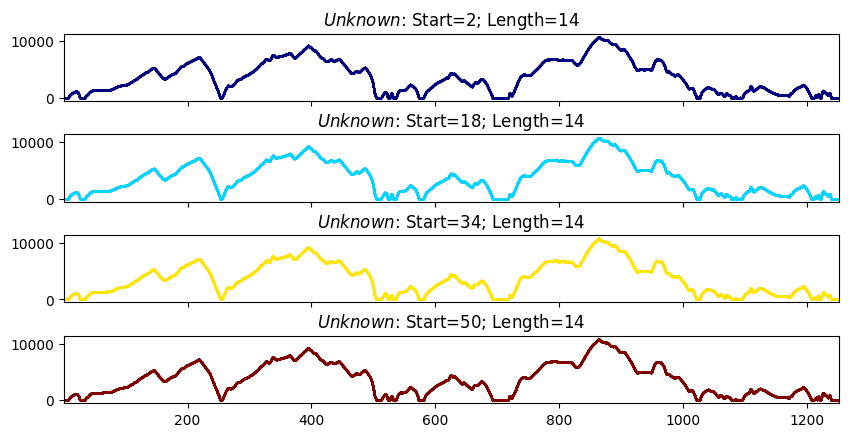

In [28]:
mp.plot_signals()

In [29]:
 mp.payload_arr

array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]], dtype=uint8)

In [30]:
mp.payload_arr.shape

(125094, 64)

In [31]:
 mp.payload_arr.T[:, 910:920]

array([[0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
       [1, 1, 1, 1, 1, 1, 1, 1, 1, 1],
       [1, 1, 1, 1, 1, 1, 1, 1, 1, 1],
       [0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
       [0, 1, 1, 1, 1, 1, 1, 1, 1, 1],
       [1, 0, 0, 0, 0, 0, 0, 1, 1, 1],
       [0, 0, 0, 0, 0, 1, 1, 0, 0, 0],
       [1, 0, 0, 1, 1, 1, 1, 0, 1, 1],
       [0, 1, 1, 1, 1, 0, 0, 1, 0, 0],
       [0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
       [1, 1, 1, 1, 1, 1, 1, 1, 1, 1],
       [1, 1, 1, 1, 1, 1, 1, 1, 1, 1],
       [0, 0, 0, 0, 0, 0,

In [32]:
display(mp.signal_list)
print(type(mp.signal_list[0]), len(mp.signal_list))

[Unknown_0 Start: 2; Length: 14,
 Unknown_1 Start: 18; Length: 14,
 Unknown_2 Start: 34; Length: 14,
 Unknown_3 Start: 50; Length: 14]

<class 'CAN_objects.signal.Signal'> 4


In [33]:
 s = mp.signal_list[0]
 s

Unknown_0 Start: 2; Length: 14

NoneType

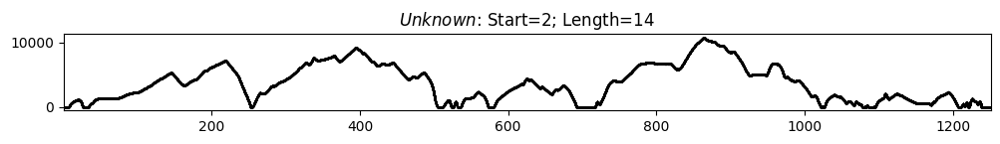

In [34]:
 type(s.plot())

In [35]:
dir(s)

['__class__',
 '__delattr__',
 '__dict__',
 '__dir__',
 '__doc__',
 '__eq__',
 '__format__',
 '__ge__',
 '__getattribute__',
 '__getstate__',
 '__gt__',
 '__hash__',
 '__init__',
 '__init_subclass__',
 '__le__',
 '__lt__',
 '__module__',
 '__ne__',
 '__new__',
 '__reduce__',
 '__reduce_ex__',
 '__repr__',
 '__setattr__',
 '__sizeof__',
 '__str__',
 '__subclasshook__',
 '__weakref__',
 '_handle_single_byte_little_endian',
 '_is_signed',
 '_set_ax',
 'a',
 'b',
 'binarray_to_int_vec',
 'byte_signal_list',
 'get_bit_idx_list',
 'get_bit_labels',
 'get_borders_const_msk',
 'get_first_bit',
 'get_last_bit',
 'get_little_endian_byte_signal_list',
 'get_lsb',
 'get_msb',
 'init_from_cantools_dbc_signal',
 'init_from_cantools_dbc_signal_filter',
 'is_little_endian',
 'is_matched',
 'is_signed',
 'length',
 'name',
 'plot',
 'pretty_print',
 'set_signal_values',
 'signal_binary_array',
 'start',
 'times',
 'unit',
 'update_tokenization',
 'values']

In [36]:
 print(min(s.times), max(s.times))

0.003940105438232422 1250.9355700016022


In [37]:
 s.values

array([0, 0, 0, ..., 0, 0, 0], dtype=int32)

In [38]:
 s.unit

''

In [39]:
 s= mp.signal_list[1]
 s


Unknown_1 Start: 18; Length: 14

NoneType

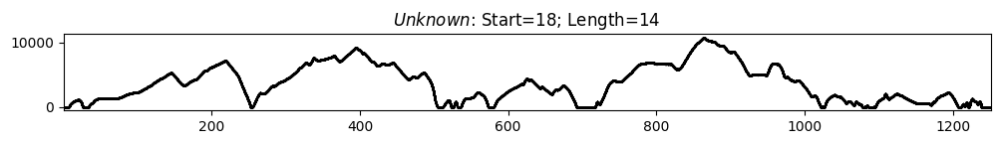

In [40]:

 type(s.plot())

In [41]:
dir(s)

['__class__',
 '__delattr__',
 '__dict__',
 '__dir__',
 '__doc__',
 '__eq__',
 '__format__',
 '__ge__',
 '__getattribute__',
 '__getstate__',
 '__gt__',
 '__hash__',
 '__init__',
 '__init_subclass__',
 '__le__',
 '__lt__',
 '__module__',
 '__ne__',
 '__new__',
 '__reduce__',
 '__reduce_ex__',
 '__repr__',
 '__setattr__',
 '__sizeof__',
 '__str__',
 '__subclasshook__',
 '__weakref__',
 '_handle_single_byte_little_endian',
 '_is_signed',
 '_set_ax',
 'a',
 'b',
 'binarray_to_int_vec',
 'byte_signal_list',
 'get_bit_idx_list',
 'get_bit_labels',
 'get_borders_const_msk',
 'get_first_bit',
 'get_last_bit',
 'get_little_endian_byte_signal_list',
 'get_lsb',
 'get_msb',
 'init_from_cantools_dbc_signal',
 'init_from_cantools_dbc_signal_filter',
 'is_little_endian',
 'is_matched',
 'is_signed',
 'length',
 'name',
 'plot',
 'pretty_print',
 'set_signal_values',
 'signal_binary_array',
 'start',
 'times',
 'unit',
 'update_tokenization',
 'values']

In [42]:

print(min(s.times), max(s.times))

0.003940105438232422 1250.9355700016022


In [43]:
 s.values

array([0, 0, 0, ..., 0, 0, 0], dtype=int32)

In [44]:
 s.unit

''

In [45]:
 s = mp.signal_list[2]
 s

Unknown_2 Start: 34; Length: 14

NoneType

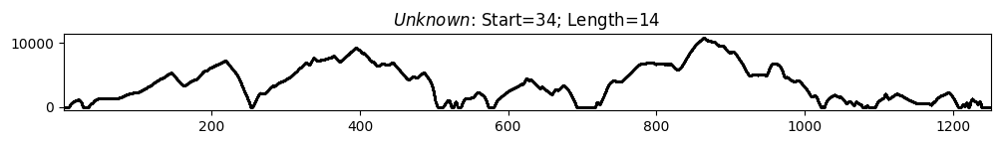

In [46]:
type(s.plot())

In [47]:
dir(s)

['__class__',
 '__delattr__',
 '__dict__',
 '__dir__',
 '__doc__',
 '__eq__',
 '__format__',
 '__ge__',
 '__getattribute__',
 '__getstate__',
 '__gt__',
 '__hash__',
 '__init__',
 '__init_subclass__',
 '__le__',
 '__lt__',
 '__module__',
 '__ne__',
 '__new__',
 '__reduce__',
 '__reduce_ex__',
 '__repr__',
 '__setattr__',
 '__sizeof__',
 '__str__',
 '__subclasshook__',
 '__weakref__',
 '_handle_single_byte_little_endian',
 '_is_signed',
 '_set_ax',
 'a',
 'b',
 'binarray_to_int_vec',
 'byte_signal_list',
 'get_bit_idx_list',
 'get_bit_labels',
 'get_borders_const_msk',
 'get_first_bit',
 'get_last_bit',
 'get_little_endian_byte_signal_list',
 'get_lsb',
 'get_msb',
 'init_from_cantools_dbc_signal',
 'init_from_cantools_dbc_signal_filter',
 'is_little_endian',
 'is_matched',
 'is_signed',
 'length',
 'name',
 'plot',
 'pretty_print',
 'set_signal_values',
 'signal_binary_array',
 'start',
 'times',
 'unit',
 'update_tokenization',
 'values']

In [48]:
print(min(s.times), max(s.times))

0.003940105438232422 1250.9355700016022


In [49]:
 s.values

array([0, 0, 0, ..., 0, 0, 0], dtype=int32)

In [50]:
 s = mp.signal_list[3]
 s

Unknown_3 Start: 50; Length: 14

NoneType

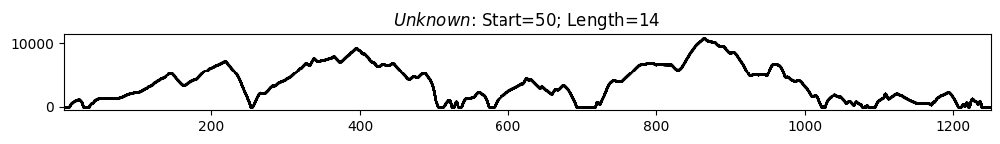

In [51]:
type(s.plot())

In [52]:
dir(s)

['__class__',
 '__delattr__',
 '__dict__',
 '__dir__',
 '__doc__',
 '__eq__',
 '__format__',
 '__ge__',
 '__getattribute__',
 '__getstate__',
 '__gt__',
 '__hash__',
 '__init__',
 '__init_subclass__',
 '__le__',
 '__lt__',
 '__module__',
 '__ne__',
 '__new__',
 '__reduce__',
 '__reduce_ex__',
 '__repr__',
 '__setattr__',
 '__sizeof__',
 '__str__',
 '__subclasshook__',
 '__weakref__',
 '_handle_single_byte_little_endian',
 '_is_signed',
 '_set_ax',
 'a',
 'b',
 'binarray_to_int_vec',
 'byte_signal_list',
 'get_bit_idx_list',
 'get_bit_labels',
 'get_borders_const_msk',
 'get_first_bit',
 'get_last_bit',
 'get_little_endian_byte_signal_list',
 'get_lsb',
 'get_msb',
 'init_from_cantools_dbc_signal',
 'init_from_cantools_dbc_signal_filter',
 'is_little_endian',
 'is_matched',
 'is_signed',
 'length',
 'name',
 'plot',
 'pretty_print',
 'set_signal_values',
 'signal_binary_array',
 'start',
 'times',
 'unit',
 'update_tokenization',
 'values']

In [53]:
print(min(s.times), max(s.times))

0.003940105438232422 1250.9355700016022


In [54]:
 s.values

array([0, 0, 0, ..., 0, 0, 0], dtype=int32)

In [55]:
import pandas as pd

# Initialize lists to store the extracted data
signal_names = []
data_dict = {}

# Define the time windows (every 10 seconds)
time_windows = range(0, int(mp.times[-1]), 10)

# Loop through the signal_list and extract information for each time window
for window_start in time_windows:
    window_end = window_start + 10
    
    # Create a sub-DataFrame for the current time window
    sub_df = pd.DataFrame(index=range(10))  # Assuming 10 samples in each time window
    
    for signal in mp.signal_list:
        # Get the indices for the current time window
        mask = (signal.times >= window_start) & (signal.times < window_end)
        
        # Get the values within the current time window and interpolate for consistent time resolution
        signal_values = signal.values[mask]
        interpolated_values = pd.Series(signal_values).interpolate().values
        
        # Add the interpolated signal values to the sub-DataFrame
        sub_df[signal.name] = interpolated_values[:10]  # Truncate to 10 samples if needed
    
    # Append the sub-DataFrame to the data dictionary with the window start as the key
    data_dict[f"{window_start} - {window_end}"] = sub_df

# Create a pandas DataFrame with the extracted data
df = pd.concat(data_dict, axis=1)

# Display the DataFrame
print(df)


     0 - 10                                 10 - 20                      \
  Unknown_0 Unknown_1 Unknown_2 Unknown_3 Unknown_0 Unknown_1 Unknown_2   
0         0         0         0         0       535       530       538   
1         0         0         0         0       534       532       538   
2         0         0         0         0       537       535       540   
3         0         0         0         0       537       535       542   
4         0         0         0         0       538       535       543   
5         0         0         0         0       541       532       543   
6         0         0         0         0       546       539       544   
7         0         0         0         0       546       542       545   
8         0         0         0         0       542       542       546   
9         0         0         0         0       540       542       546   

              20 - 30            ... 1220 - 1230           1230 - 1240  \
  Unknown_3 Unknown_0 Unk

### mean and sd for each signal per time window [mean,sd] for ID 1760

In [56]:
import pandas as pd

# Initialize lists to store the extracted data
signal_names = []
data_dict = {}

# Initialize a list to store the summary data for each time window
summary_data = []

# Define the time windows (every 10 seconds)
time_windows = range(0, int(mp.times[-1]), 10)

# Loop through the signal_list and extract information for each time window
for window_start in time_windows:
    window_end = window_start + 10
    
    # Create a sub-DataFrame for the current time window
    sub_df = pd.DataFrame(index=range(10))  # Assuming 10 samples in each time window
    
    for signal in mp.signal_list:
        # Get the indices for the current time window
        mask = (signal.times >= window_start) & (signal.times < window_end)
        
        # Get the values within the current time window and interpolate for consistent time resolution
        signal_values = signal.values[mask]
        interpolated_values = pd.Series(signal_values).interpolate().values
        
        # Add the interpolated signal values to the sub-DataFrame
        sub_df[signal.name] = interpolated_values[:10]  # Truncate to 10 samples if needed
    
    # Calculate the mean and standard deviation for each signal in the current time window
    window_summary = []
    for signal_name in ["Unknown_0", "Unknown_1", "Unknown_2", "Unknown_3"]:
        mean_value = sub_df[signal_name].mean()
        std_value = sub_df[signal_name].std()
        # Round the standard deviation to two decimal places
        std_value = round(std_value, 2)
        window_summary.append([mean_value, std_value])
    
    # Append the window summary to the list
    summary_data.append({"Time Window": f"{window_start} - {window_end}", "Summary": window_summary})
    
    # Append the sub-DataFrame to the data dictionary with the window start as the key
    data_dict[f"{window_start} - {window_end}"] = sub_df

# Display the summary data
for window_data in summary_data:
    print(window_data["Time Window"])
    for i, signal_name in enumerate(["Unknown_0", "Unknown_1", "Unknown_2", "Unknown_3"]):
        mean_value, std_value = window_data["Summary"][i]
        print(f"{signal_name} [{mean_value}, {std_value}]")
    print()


0 - 10
Unknown_0 [0.0, 0.0]
Unknown_1 [0.0, 0.0]
Unknown_2 [0.0, 0.0]
Unknown_3 [0.0, 0.0]

10 - 20
Unknown_0 [539.6, 4.2]
Unknown_1 [536.4, 4.55]
Unknown_2 [542.5, 2.99]
Unknown_3 [541.9, 2.85]

20 - 30
Unknown_0 [1172.1, 4.23]
Unknown_1 [1166.6, 3.27]
Unknown_2 [1163.3, 1.06]
Unknown_3 [1162.3, 1.42]

30 - 40
Unknown_0 [0.0, 0.0]
Unknown_1 [0.0, 0.0]
Unknown_2 [0.0, 0.0]
Unknown_3 [0.0, 0.0]

40 - 50
Unknown_0 [780.1, 4.58]
Unknown_1 [776.1, 3.35]
Unknown_2 [795.2, 5.35]
Unknown_3 [794.9, 5.36]

50 - 60
Unknown_0 [1329.6, 3.31]
Unknown_1 [1324.7, 2.95]
Unknown_2 [1330.4, 1.17]
Unknown_3 [1328.7, 0.82]

60 - 70
Unknown_0 [1345.2, 4.08]
Unknown_1 [1340.0, 2.4]
Unknown_2 [1341.4, 1.51]
Unknown_3 [1340.5, 1.96]

70 - 80
Unknown_0 [1399.1, 3.6]
Unknown_1 [1394.0, 1.94]
Unknown_2 [1410.6, 0.97]
Unknown_3 [1409.6, 1.71]

80 - 90
Unknown_0 [1648.4, 6.87]
Unknown_1 [1643.1, 3.78]
Unknown_2 [1650.9, 0.88]
Unknown_3 [1651.2, 1.14]

90 - 100
Unknown_0 [2110.0, 3.16]
Unknown_1 [2103.0, 2.62]
Unkn

### Exploring all IDS, signals and their signal values

In [57]:
# List of IDs to explore
ids_to_explore = [6, 14, 37, 51, 58, 60, 61, 65, 117, 167, 186, 192, 204, 208, 215, 241, 244, 248, 253, 263, 293,
                  300, 304, 339, 354, 403, 412, 420, 426, 452, 458, 470, 485, 519, 526, 541, 560, 569, 622, 627,
                  628, 631, 640, 651, 661, 663, 675, 676, 683, 692, 695, 705, 722, 727, 737, 738, 778, 813, 837,
                  852, 870, 881, 930, 953, 961, 996, 1031, 1049, 1072, 1076, 1124, 1175, 1176, 1225, 1227, 1255,
                  1262, 1277, 1307, 1314, 1331, 1372, 1398, 1399, 1408, 1413, 1455, 1459, 1505, 1512, 1533, 1560,
                  1590, 1621, 1628, 1634, 1644, 1649, 1661, 1668, 1693, 1694, 1751, 1760, 1788]

# Loop through each ID and extract the signal values
for id_to_explore in ids_to_explore:
    mp = mapped_capture.mapped_payload_dict[id_to_explore]
    
    # Display the information about the ID and its signals
    print(f"Exploring ID: {id_to_explore}")
    print(f"Number of nonconstant bits: {len(mp.signal_list)}")
    for signal in mp.signal_list:
        print(f"Signal: {signal.name}, Start: {signal.start}, Length: {signal.length}")
        print(f"Signal values: {signal.values}")
    print()


Exploring ID: 6
Number of nonconstant bits: 3
Signal: Unknown_0, Start: 4, Length: 1
Signal values: [1 1 1 ... 1 1 1]
Signal: Unknown_1, Start: 25, Length: 2
Signal values: [3 3 3 ... 3 3 3]
Signal: Unknown_2, Start: 29, Length: 1
Signal values: [1 1 1 ... 1 1 1]

Exploring ID: 14
Number of nonconstant bits: 3
Signal: Unknown_0, Start: 10, Length: 8
Signal values: [148 148 148 ... 133 133 133]
Signal: Unknown_1, Start: 47, Length: 1
Signal values: [1 1 1 ... 1 1 1]
Signal: Unknown_2, Start: 48, Length: 15
Signal values: [15026 15023 15029 ... 15011 15011 15011]

Exploring ID: 37
Number of nonconstant bits: 4
Signal: Unknown_0, Start: 18, Length: 9
Signal values: [20 20 20 ... 20 20 20]
Signal: Unknown_1, Start: 41, Length: 6
Signal values: [30 30 30 ... 32 32 32]
Signal: Unknown_2, Start: 47, Length: 8
Signal values: [66 67 67 ... 90 90 90]
Signal: Unknown_3, Start: 55, Length: 5
Signal values: [0 0 0 ... 0 0 0]

Exploring ID: 51
Number of nonconstant bits: 7
Signal: Unknown_0, Start: 

### Exploring all IDs,time windows,  signals and their signal values

In [58]:
import pandas as pd

# List of IDs to explore
ids_to_explore = [6, 14, 37, 51, 58, 60, 61, 65, 117, 167, 186, 192, 204, 208, 215, 241, 244, 248, 253, 263, 293,
                  300, 304, 339, 354, 403, 412, 420, 426, 452, 458, 470, 485, 519, 526, 541, 560, 569, 622, 627,
                  628, 631, 640, 651, 661, 663, 675, 676, 683, 692, 695, 705, 722, 727, 737, 738, 778, 813, 837,
                  852, 870, 881, 930, 953, 961, 996, 1031, 1049, 1072, 1076, 1124, 1175, 1176, 1225, 1227, 1255,
                  1262, 1277, 1307, 1314, 1331, 1372, 1398, 1399, 1408, 1413, 1455, 1459, 1505, 1512, 1533, 1560,
                  1590, 1621, 1628, 1634, 1644, 1649, 1661, 1668, 1693, 1694, 1751, 1760, 1788]

# Loop through each ID and extract the signal values
for id_to_explore in ids_to_explore:
    mp = mapped_capture.mapped_payload_dict[id_to_explore]
    
    # Display the information about the ID and its signals
    print(f"Exploring ID: {id_to_explore}")
    print(f"Number of nonconstant bits: {len(mp.signal_list)}")
    
    # Initialize a dictionary to store the extracted data for each time window
    data_dict = {}
    
    # Define the time windows (every 10 seconds)
    time_windows = range(0, int(mp.times[-1]), 10)
    
    # Loop through the signal_list and extract information for each time window
    for window_start in time_windows:
        window_end = window_start + 10
        
        # Create a sub-DataFrame for the current time window
        sub_df = pd.DataFrame(index=range(10))  # Assuming 10 samples in each time window
        
        for signal in mp.signal_list:
            # Get the indices for the current time window
            mask = (signal.times >= window_start) & (signal.times < window_end)
            
            # Get the values within the current time window and interpolate for consistent time resolution
            signal_values = signal.values[mask]
            interpolated_values = pd.Series(signal_values).interpolate(method='linear', limit_area='inside').values
            
            # Ensure that interpolated values match the length of the DataFrame
            interpolated_values = [interpolated_values[i] if i < len(interpolated_values) else None for i in range(10)]
            interpolated_values = pd.Series(interpolated_values).interpolate(method='linear', limit_area='inside').values
            
            # Add the interpolated signal values to the sub-DataFrame
            sub_df[signal.name] = interpolated_values
        
        # Append the sub-DataFrame to the data_dict with the window start as the key
        data_dict[(window_start, window_end)] = sub_df
    
    # Create a pandas DataFrame with the extracted data for the current ID
    df = pd.concat(data_dict, axis=1)
    
    # Convert columns to a regular Index with tuples representing the time windows and signal names
    df.columns = pd.MultiIndex.from_tuples(df.columns)
    
    # Display the DataFrame for the current ID
    print(df)
    print()


Exploring ID: 6
Number of nonconstant bits: 3
       0                             10                            20    \
       10                            20                            30     
  Unknown_0 Unknown_1 Unknown_2 Unknown_0 Unknown_1 Unknown_2 Unknown_0   
0         1         3         1         1         3         1         1   
1         1         3         1         1         3         1         1   
2         1         3         1         1         3         1         1   
3         1         3         1         1         3         1         1   
4         1         3         1         1         3         1         1   
5         1         3         1         1         3         1         1   
6         1         3         1         1         3         1         1   
7         1         3         1         1         3         1         1   
8         1         3         1         1         3         1         1   
9         1         3         1         1         3   

       0                                                                 \
       10                                                                 
  Unknown_0 Unknown_1 Unknown_2 Unknown_3 Unknown_4 Unknown_5 Unknown_6   
0         0        -6         0         3         2         0       125   
1         0        -7         0         3         3         0       125   
2         0        -8         0         3         4         0       125   
3         0        -9         0         3         5         0       125   
4         0       -10         0         3         6         0       125   
5         0       -11         0         3         7         0       125   
6         0       -12         0         3         8         0       125   
7         0       -13         0         3         9         0       125   
8         0       -14         0         3        10         0       125   
9         0       -15         0         3        11         0       125   

       10               

       0                                                 10              \
       10                                                20               
  Unknown_0 Unknown_1 Unknown_2 Unknown_3 Unknown_4 Unknown_0 Unknown_1   
0         0       119         0         0         0        85       133   
1         0       119         0         0         0        89       134   
2         0       119         0         0         0        94       134   
3         0       119         0         0         0        99       134   
4         0       119         0         0         0       105       135   
5         0       119         0         0         0       110       135   
6         0       120         0         0         0       115       135   
7         0       120         0         0         0       119       135   
8         0       120         0         0         0       123       136   
9         0       120         0         0         0       125       136   

                        

       0                                                                 \
       10                                                                 
  Unknown_0 Unknown_1 Unknown_2 Unknown_3 Unknown_4 Unknown_5 Unknown_6   
0         1         0         0         0       500         0       663   
1         1         0         0         0       500         0       663   
2         1         0         0         0       500         0       663   
3         1         0         0         0       500         0       663   
4         1         0         0         0       500         0       663   
5         1         0         0         0       500         0       663   
6         1         0         0         0       500         0       663   
7         1         0         0         0       500         0       663   
8         1         0         0         0       500         0       663   
9         1         0         0         0       500         0       663   

                        

       0                                                                 \
       10                                                                 
  Unknown_0 Unknown_1 Unknown_2 Unknown_3 Unknown_4 Unknown_5 Unknown_6   
0         7       549         0         2         4        64       991   
1         7       550         0         2         4        64       991   
2         7       550         0         2         4        64       991   
3         7       550         0         2         4        64       991   
4         7       550         0         2         4        64       991   
5         7       551         0         2         4        64       991   
6         7       551         0         2         4        64       991   
7         7       551         0         2         4        64       991   
8         7       551         0         2         4        64       991   
9         7       552         0         2         4        64       991   

                 10     

       0                                                 10              \
       10                                                20               
  Unknown_0 Unknown_1 Unknown_2 Unknown_3 Unknown_4 Unknown_0 Unknown_1   
0        90       244        10       244         1        90       244   
1        90       244        10       244         1        90       244   
2        90       244        10       244         1        90       244   
3        90       244        10       244         1        90       244   
4        90       244        10       244         1        90       244   
5        90       244        10       244         1        90       244   
6        90       244        10       244         1        90       244   
7        90       244        10       244         1        90       244   
8        90       244        10       244         1        90       244   
9        90       244        10       244         1        90       244   

                        

       0                                                                 \
       10                                                                 
  Unknown_0 Unknown_1 Unknown_2 Unknown_3 Unknown_4 Unknown_5 Unknown_6   
0         0         0         0         0         0         0         0   
1         0         0         0         0         0         0         0   
2         0         0         0         0         0         0         0   
3         0         0         0         0         0         0         0   
4         0         0         0         0         0         0         0   
5         0         0         0         0         0         0         0   
6         0         0         0         0         0         0         0   
7         0         0         0         0         0         0         0   
8         0         0         0         0         0         0         0   
9         0         0         0         0         0         0         0   

                        

       0                                                           10    \
       10                                                          20     
  Unknown_0 Unknown_1 Unknown_2 Unknown_3 Unknown_4 Unknown_5 Unknown_0   
0         0       123         0         0         0         0         0   
1         0       123         0         0         0         0         0   
2         0       123         0         0         0         0         0   
3         0       123         0         0         0         0         0   
4         0       123         0         0         0         0         0   
5         0       123         0         0         0         0         0   
6         0       123         0         0         0         0         0   
7         0       123         0         0         0         0         0   
8         0       123         0         0         0         0         0   
9         0       123         0         0         0         0         0   

                        

       0                                                 10              \
       10                                                20               
  Unknown_0 Unknown_1 Unknown_2 Unknown_3 Unknown_4 Unknown_0 Unknown_1   
0         1         0        15     32878       655         5         0   
1         2         0        13     32878       655         6         0   
2         3         0        11     32878       655         7         0   
3         4         0         9     32878       655         0         0   
4         5         0         7     32878       655         1         0   
5         6         0         5     32878       655         2         0   
6         7         0         3     32878       655         3         0   
7         0         0        17     32878       655         4         0   
8         1         0        15     32878       655         5         0   
9         2         0        13     32878       655         6         0   

                        

       0                                                                 \
       10                                                                 
  Unknown_0 Unknown_1 Unknown_2 Unknown_3 Unknown_4 Unknown_5 Unknown_6   
0         0         0         1         0         0         8         0   
1         0         0         1         0         0         9         0   
2         0         0         1         0         0        10         0   
3         0         0         1         0         0        11         0   
4         1        -1         1         1         1         0        -1   
5         1        -1         1         1         1         1         3   
6         0         0         1         0         0         2         0   
7         0         0         1         0         0         3         0   
8         0         0         1         0         0         4         0   
9         0         0         1         0         0         5         0   

                        

       0                                                                 \
       10                                                                 
  Unknown_0 Unknown_1 Unknown_2 Unknown_3 Unknown_4 Unknown_5 Unknown_6   
0         1         1         1         1         1       376        -6   
1         1         1         1         1         1       376        -6   
2         1         1         1         1         1       376        -6   
3         1         1         3         1         3       376        -6   
4         1         1         1         1         1       376        -6   
5         1         1         1         1         1       376        -6   
6         1         1         1         1         1       376        -6   
7         1         1         1         1         1       376        -6   
8         1         1         1         1         1       376        -6   
9         1         1         1         1         1       376        -6   

                        

       0                                       10                        \
       10                                      20                         
  Unknown_0 Unknown_1 Unknown_2 Unknown_3 Unknown_0 Unknown_1 Unknown_2   
0      -121       629        77         1        -6         0        93   
1      -122       629        77         2        -7         0        93   
2      -123       629        77         3        -8         0        93   
3      -124       629        76         4        -9         0        93   
4      -125       629        77         5       -10         0        94   
5      -126       629        76         6       -11         0        94   
6      -127       629        77         7       -12         0        94   
7      -128       629        76         8       -13         0        94   
8       127       629        76         9       -14         0        94   
9       126       629        77        10       -15         0        94   

                 20     

       0                                                                 \
       10                                                                 
  Unknown_0 Unknown_1 Unknown_2 Unknown_3 Unknown_4 Unknown_5 Unknown_6   
0         0         0        15         1         1         0        -2   
1         0         0        15         1         2         0        -3   
2         0         0        15         1         3         0        -4   
3         0         0        15         1         4         0        -5   
4         0         0        15         1         5         0        -6   
5         0         0        15         1         6         0        -7   
6         0         0        15         1         7         0        -8   
7         0         0        15         1         0         0        -1   
8         0         0        15         1         1         0        -2   
9         0         0        15         1         2         0        -3   

                        

       0                   10                  20                  30    \
       10                  20                  30                  40     
  Unknown_0 Unknown_1 Unknown_0 Unknown_1 Unknown_0 Unknown_1 Unknown_0   
0         0         0         0         0         0         0         0   
1         0         0         0         0         0         0         0   
2         0         0         0         0         0         0         0   
3         0         0         0         0         0         0         0   
4         0         0         0         0         0         0         0   
5         0         0         0         0         0         0         0   
6         0         0         0         0         0         0         0   
7         0         0         0         0         0         0         0   
8         0         0         0         0         0         0         0   
9         0         0         0         0         0         0         0   

                 40     

       0                                                                 \
       10                                                                 
  Unknown_0 Unknown_1 Unknown_2 Unknown_3 Unknown_4 Unknown_5 Unknown_6   
0         0         0         0         0         0         0       511   
1         0         0         0         0         0         0       511   
2         0         0         0         0         0         0       511   
3         0         0         0         0         0         0       511   
4         0         0         0         0         0         0       511   
5         0         0         0         0         0         0       511   
6         0         0         0         0         0         0       511   
7         0         0         0         0         0         0       511   
8         0         0         0         0         0         0       511   
9         0         0         0         0         0         0       511   

                        

       0                                                                 \
       10                                                                 
  Unknown_0 Unknown_1 Unknown_2 Unknown_3 Unknown_4 Unknown_5 Unknown_6   
0         0     18632         0         0         0         1         0   
1         0     18632         0         0         0         1         0   
2         0     18633         0         0         0         1         0   
3         0     18633         0         0         0         1         0   
4         0     18633         0         0         0         1         0   
5         0     18633         0         0         0         1         0   
6         0     18633         0         0         0         1         0   
7         0     18633         0         0         0         1         0   
8         0     18633         0         0         0         1         0   
9         0     18633         0         0         0         1         0   

                        

       0                                                                 \
       10                                                                 
  Unknown_0 Unknown_1 Unknown_2 Unknown_3 Unknown_4 Unknown_5 Unknown_6   
0         0       240         1         3         6         0         0   
1         0       264         2         3         6         0         0   
2         0       264         3         3         6         0         0   
3         0       264         4         3         6         0         0   
4         0       242         5         3         6         0         0   
5         0         0         6         3         6         0         0   
6         0         0         7         3         6         0         0   
7         0         0         8         3         6         0         0   
8         0         0         9         3         6         0         0   
9         0         0        10         3         6         0         0   

                 10     

       0                                                                 \
       10                                                                 
  Unknown_0 Unknown_1 Unknown_2 Unknown_3 Unknown_4 Unknown_5 Unknown_6   
0         0         3         1         0      -235         1       264   
1         0         3         1         0      -235         1       264   
2         0         3         1         0      -235         1       264   
3         0         3         1         0      -235         1       264   
4         0         3         1         0      -235         1       264   
5         0         3         1         0      -235         1       264   
6         0         3         1         0      -235         1       264   
7         0         3         1         0      -235         1       264   
8         0         3         1         0      -235         1       264   
9         0         3         1         0      -235         1       264   

       10               

       0                                                                 \
       10                                                                 
  Unknown_0 Unknown_1 Unknown_2 Unknown_3 Unknown_4 Unknown_5 Unknown_6   
0         1         0         4        -1         0         1        29   
1         1         0         4        -1         0         1        29   
2         1         0         4        -1         0         1        29   
3         1         0         4        -1         0         1        29   
4         1         0         4        -1         0         1        29   
5         1         0         4        -1         0         1        29   
6         1         0         4        -1         0         1        29   
7         1         0         4        -1         0         1        29   
8         1         0         4        -1         0         1        29   
9         1         0         4        -1         0         1        29   

       10               

       0                                                           10    \
       10                                                          20     
  Unknown_0 Unknown_1 Unknown_2 Unknown_3 Unknown_4 Unknown_5 Unknown_0   
0       0.0       4.0       0.0       0.0      17.0       1.0       0.0   
1       0.0       4.0       0.0       0.0      17.0       1.0       0.0   
2       0.0       4.0       0.0       0.0      17.0       1.0       0.0   
3       0.0       4.0       0.0       0.0      17.0       1.0       0.0   
4       0.0       4.0       0.0       0.0      17.0       1.0       0.0   
5       0.0       4.0       0.0       0.0      17.0       1.0       0.0   
6       NaN       NaN       NaN       NaN       NaN       NaN       0.0   
7       NaN       NaN       NaN       NaN       NaN       NaN       NaN   
8       NaN       NaN       NaN       NaN       NaN       NaN       NaN   
9       NaN       NaN       NaN       NaN       NaN       NaN       NaN   

                        

       0                                                 10              \
       10                                                20               
  Unknown_0 Unknown_1 Unknown_2 Unknown_3 Unknown_4 Unknown_0 Unknown_1   
0        50         0         5         0         0        50         0   
1        50         0         5         0         0        50         0   
2        50         0         5         0         0        50         0   
3        50         0         5         0         0        50         0   
4        50         0         5         0         0        50         0   
5        50         0         5         0         0        50         0   
6        50         0         5         0         0        50         0   
7        50         0         5         0         0        50         0   
8        50         0         5         0         0        50         0   
9        50         0         5         0         0        50         0   

                        

       0                                                                 \
       10                                                                 
  Unknown_0 Unknown_1 Unknown_2 Unknown_3 Unknown_4 Unknown_5 Unknown_6   
0         0       173         1         2      8567         0         0   
1         0       173         1         2      8567         0         0   
2         0       173         1         2      8567         0         0   
3         0       173         1         2      8567         0         0   
4         0       173         1         2      8567         0         0   
5         0       173         1         2      8567         0         0   
6         0       173         1         2      8567         0         0   
7         0       173         1         2      8567         0         0   
8         0       173         1         2      8567         0         0   
9         0       173         1         2      8567         0         0   

                 10     

       0                                                 10              \
       10                                                20               
  Unknown_0 Unknown_1 Unknown_2 Unknown_3 Unknown_4 Unknown_0 Unknown_1   
0      2048      2048       246         0         6      4095      4095   
1      2048      2048       245         0         7      4095      4095   
2      2048      2048       244         0         8      4095      4095   
3      2048      2048       243         0         9      4095      4095   
4      2048      2048       242         0        10      4095      4095   
5      2048      2048       241         0        11      4095      4095   
6      2048      2048       240         0        12      4095      4095   
7      2048      2048       239         0        13      4095      4095   
8      2048      2048       238         0        14      4095      4095   
9      2048      2048       237         0        15      4095      4095   

                        

       0                   10                  20                  30    \
       10                  20                  30                  40     
  Unknown_0 Unknown_1 Unknown_0 Unknown_1 Unknown_0 Unknown_1 Unknown_0   
0        23        82        23        82        23        82        23   
1        23        82        23        82        23        82        23   
2        23        82        23        82        23        82        23   
3        23        82        23        82        23        82        23   
4        23        82        23        82        23        82        23   
5        23        82        23        82        23        82        23   
6        23        82        23        82        23        82        23   
7        23        82        23        82        23        82        23   
8        23        82        23        82        23        82        23   
9        23        82        23        82        23        82        23   

                 40     

       0                                                                 \
       10                                                                 
  Unknown_0 Unknown_1 Unknown_2 Unknown_3 Unknown_4 Unknown_5 Unknown_6   
0         1         1         2         1         1         1    117306   
1         1         2        49         1         0         0    110985   
2         1         4         9         0         0         3     16129   
3         1         0        12         0         2         0     65832   
4         0         0         2         0         3         0    271667   
5         1         0        26         0         1         2    133554   
6         1         1         2         1         1         1    117306   
7         1         2        49         1         0         0    110985   
8         1         4         9         0         0         3     16129   
9         1         0        12         0         2         0     65832   

                        

       0                                                                 \
       10                                                                 
  Unknown_0 Unknown_1 Unknown_2 Unknown_3 Unknown_4 Unknown_5 Unknown_6   
0         2         0         8         5        12        12        -2   
1         2         0         8         5        12        12        -2   
2         2         0         8         5        12        12        -2   
3         2         0         8         5        12        12        -2   
4         2         0         8         5        12        12        -2   
5         2         0         8         5        12        12        -2   
6         2         0         8         5        12        12        -2   
7         2         0         8         5        12        12        -2   
8         2         0         8         5        12        12        -2   
9         2         0         8         5        12        12        -2   

                        

       0                             10                            20    \
       10                            20                            30     
  Unknown_0 Unknown_1 Unknown_2 Unknown_0 Unknown_1 Unknown_2 Unknown_0   
0       126         1     32768       122         5     32768       118   
1       125         2     32768       121         6     32768       117   
2       124         3     32768       120         7     32768       116   
3       123         4     32768       119         8     32768       115   
4       122         5     32768       118         9     32768       114   
5       121         6     32768       117        10     32768       113   
6       120         7     32768       116        11     32768       112   
7       119         8     32768       115        12     32768       127   
8       118         9     32768       114        13     32768       126   
9       117        10     32768       113        14     32768       125   

                        

       0                                                 10              \
       10                                                20               
  Unknown_0 Unknown_1 Unknown_2 Unknown_3 Unknown_4 Unknown_0 Unknown_1   
0         0         0         0         0         0         0         0   
1         0         0         0         0         0         0         0   
2         0         0         0         0         0         0         0   
3         0         0         0         0         0         0         0   
4         0         0         0         0         0         0         0   
5         0         0         0         0         0         0         0   
6         0         0         0         0         0         0         0   
7         0         0         0         0         0         0         0   
8         0         0         0         0         0         0         0   
9         0         0         0         0         0         0         0   

                        

       0                                       10                        \
       10                                      20                         
  Unknown_0 Unknown_1 Unknown_2 Unknown_3 Unknown_0 Unknown_1 Unknown_2   
0         1        -1         1         3         1        -1         1   
1         1        -1         1         3         1        -1         1   
2         1        -1         1         3         1        -1         1   
3         1        -1         1         3         1        -1         1   
4         1        -1         1         3         1        -1         1   
5         1        -1         1         3         1        -1         1   
6         1        -1         1         3         1        -1         1   
7         1        -1         1         3         1        -1         1   
8         1        -1         1         3         1        -1         1   
9         1        -1         1         3         1        -1         1   

                 20     

       0                                                                 \
       10                                                                 
  Unknown_0 Unknown_1 Unknown_2 Unknown_3 Unknown_4 Unknown_5 Unknown_6   
0         0        98        40        62         0         0         0   
1         0        98        40        62         0         0         0   
2         0        98        40        62         0         0         0   
3         0        98        40        62         0         0         0   
4         0        98        40        62         0         0         0   
5         0        98        40        62         0         0         0   
6         0        98        40        62         0         0         0   
7         0        98        40        62         0         0         0   
8         0        98        40        62         0         0         0   
9         0        98        40        62         0         0         0   

                 10     

       0                                                                 \
       10                                                                 
  Unknown_0 Unknown_1 Unknown_2 Unknown_3 Unknown_4 Unknown_5 Unknown_6   
0         0         0         0         0         1         0         0   
1         0         0         0         0         1         0         0   
2         0         0         0         0         1         0         0   
3         0         0         0         0         1         0         0   
4         0         0         0         0         1         0         0   
5         0         0         0         0         1         0         0   
6         0         0         0         0         1         0         0   
7         0         0         0         0         1         0         0   
8         0         0         0         0         1         0         0   
9         0         0         0         0         1         0         0   

                 10     

       0                                                           10    \
       10                                                          20     
  Unknown_0 Unknown_1 Unknown_2 Unknown_3 Unknown_4 Unknown_5 Unknown_0   
0         2       126       127         0       170         1         2   
1         2       126       127         0       170         1         2   
2         2       126       127         0       170         1         2   
3         2       126       127         0       170         1         2   
4         2       126       127         0       170         1         2   
5         2       126       127         0       170         1         2   
6         2       126       127         0       170         1         2   
7         2       126       127         0       170         1         2   
8         2       126       127         0       170         1         2   
9         2       126       127         0       170         1         2   

                        

       0                                                                 \
       10                                                                 
  Unknown_0 Unknown_1 Unknown_2 Unknown_3 Unknown_4 Unknown_5 Unknown_6   
0         0         0         0     15026         1         1      1771   
1         0         0         0     15025         1         1      1771   
2         0         0         0     15026         1         1      1771   
3         0         0         0     15026         1         1      1771   
4         0         0         0     15026         1         1      1771   
5         0         0         0     15025         1         1      1771   
6         0         0         0     15026         1         1      1771   
7         0         0         0     15026         1         1      1771   
8         0         0         0     15026         1         1      1771   
9         0         0         0     15026         1         1      1771   

                        

### Mean and std for each signal per time window [mean,sd] -----------for ALL IDs

In [59]:
import pandas as pd
import numpy as np

# List of IDs to explore
ids_to_explore = [6, 14, 37, 51, 58, 60, 61, 65, 117, 167, 186, 192, 204, 208, 215, 241, 244, 248, 253, 263, 293,
                  300, 304, 339, 354, 403, 412, 420, 426, 452, 458, 470, 485, 519, 526, 541, 560, 569, 622, 627,
                  628, 631, 640, 651, 661, 663, 675, 676, 683, 692, 695, 705, 722, 727, 737, 738, 778, 813, 837,
                  852, 870, 881, 930, 953, 961, 996, 1031, 1049, 1072, 1076, 1124, 1175, 1176, 1225, 1227, 1255,
                  1262, 1277, 1307, 1314, 1331, 1372, 1398, 1399, 1408, 1413, 1455, 1459, 1505, 1512, 1533, 1560,
                  1590, 1621, 1628, 1634, 1644, 1649, 1661, 1668, 1693, 1694, 1751, 1760, 1788]

# Function to extract mean and std for each column in a DataFrame
def extract_mean_std(df):
    return [df.mean().values, df.std().values]

# Loop through each ID and extract the signal values
for id_to_explore in ids_to_explore:
    mp = mapped_capture.mapped_payload_dict[id_to_explore]

    # Display the information about the ID and its signals
    print(f"ID {id_to_explore}")

    # Define the time windows (every 10 seconds)
    time_windows = range(0, int(mp.times[-1]), 10)

    # Loop through the signal_list and extract information for each time window
    for window_start in time_windows:
        window_end = window_start + 10
        print(f"{window_start} - {window_end}")

        # Create a sub-DataFrame for the current time window
        sub_df = pd.DataFrame(index=range(10))  # Assuming 10 samples in each time window

        for signal in mp.signal_list:
            # Get the indices for the current time window
            mask = (signal.times >= window_start) & (signal.times < window_end)

            # Get the values within the current time window and interpolate for consistent time resolution
            signal_values = signal.values[mask]
            interpolated_values = pd.Series(signal_values).interpolate(method='linear', limit_area='inside').values

            # Ensure that interpolated values match the length of the DataFrame
            interpolated_values = [interpolated_values[i] if i < len(interpolated_values) else None for i in range(10)]
            interpolated_values = pd.Series(interpolated_values).interpolate(method='linear', limit_area='inside').values

            # Add the interpolated signal values to the sub-DataFrame
            sub_df[signal.name] = interpolated_values

        # Compute the mean and std for the sub-DataFrame
        mean_std_array = extract_mean_std(sub_df)

        # Display the mean and std for each signal in the current time window
        for signal_name, (mean_val, std_val) in zip(sub_df.columns, zip(*mean_std_array)):
            print(f"{signal_name} [{mean_val:.2f}, {std_val:.2f}]")

        print()


ID 6
0 - 10
Unknown_0 [1.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [1.00, 0.00]

10 - 20
Unknown_0 [1.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [1.00, 0.00]

20 - 30
Unknown_0 [1.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [1.00, 0.00]

30 - 40
Unknown_0 [1.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [1.00, 0.00]

40 - 50
Unknown_0 [1.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [1.00, 0.00]

50 - 60
Unknown_0 [1.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [1.00, 0.00]

60 - 70
Unknown_0 [1.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [1.00, 0.00]

70 - 80
Unknown_0 [1.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [1.00, 0.00]

80 - 90
Unknown_0 [1.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [1.00, 0.00]

90 - 100
Unknown_0 [1.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [1.00, 0.00]

100 - 110
Unknown_0 [1.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [1.00, 0.00]

110 - 120
Unknown_0 [1.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [1.00, 0.00]

120 - 130
Unknown_0 [1.00, 0.00]
Unknown_1 [3.00, 0.00]

Unknown_0 [1.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [1.00, 0.00]

1040 - 1050
Unknown_0 [1.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [1.00, 0.00]

1050 - 1060
Unknown_0 [1.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [1.00, 0.00]

1060 - 1070
Unknown_0 [1.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [1.00, 0.00]

1070 - 1080
Unknown_0 [1.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [1.00, 0.00]

1080 - 1090
Unknown_0 [1.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [1.00, 0.00]

1090 - 1100
Unknown_0 [1.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [1.00, 0.00]

1100 - 1110
Unknown_0 [1.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [1.00, 0.00]

1110 - 1120
Unknown_0 [1.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [1.00, 0.00]

1120 - 1130
Unknown_0 [1.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [1.00, 0.00]

1130 - 1140
Unknown_0 [1.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [1.00, 0.00]

1140 - 1150
Unknown_0 [1.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [1.00, 0.00]

1150 - 1160
Unknown_0 [1.00,

Unknown_0 [135.20, 0.42]
Unknown_1 [1.00, 0.00]
Unknown_2 [15001.50, 11.76]

1080 - 1090
Unknown_0 [135.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [15035.30, 4.11]

1090 - 1100
Unknown_0 [135.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [15017.00, 2.45]

1100 - 1110
Unknown_0 [132.20, 0.42]
Unknown_1 [1.00, 0.00]
Unknown_2 [15245.40, 2.37]

1110 - 1120
Unknown_0 [137.50, 1.27]
Unknown_1 [1.00, 0.00]
Unknown_2 [14700.10, 131.48]

1120 - 1130
Unknown_0 [130.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [15412.60, 3.57]

1130 - 1140
Unknown_0 [134.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [14993.50, 4.95]

1140 - 1150
Unknown_0 [134.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [15001.20, 5.18]

1150 - 1160
Unknown_0 [134.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [15020.60, 3.41]

1160 - 1170
Unknown_0 [134.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [15047.90, 4.01]

1170 - 1180
Unknown_0 [134.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [15028.40, 3.41]

1180 - 1190
Unknown_0 [130.00, 0.00]
Unkn

Unknown_0 [20.00, 0.00]
Unknown_1 [31.00, 0.00]
Unknown_2 [92.00, 0.00]
Unknown_3 [0.00, 0.00]

950 - 960
Unknown_0 [20.00, 0.00]
Unknown_1 [31.00, 0.00]
Unknown_2 [92.00, 0.00]
Unknown_3 [0.00, 0.00]

960 - 970
Unknown_0 [20.00, 0.00]
Unknown_1 [31.00, 0.00]
Unknown_2 [92.00, 0.00]
Unknown_3 [0.00, 0.00]

970 - 980
Unknown_0 [20.00, 0.00]
Unknown_1 [31.00, 0.00]
Unknown_2 [92.00, 0.00]
Unknown_3 [0.00, 0.00]

980 - 990
Unknown_0 [20.00, 0.00]
Unknown_1 [31.00, 0.00]
Unknown_2 [92.00, 0.00]
Unknown_3 [0.00, 0.00]

990 - 1000
Unknown_0 [20.00, 0.00]
Unknown_1 [31.00, 0.00]
Unknown_2 [92.00, 0.00]
Unknown_3 [0.00, 0.00]

1000 - 1010
Unknown_0 [20.00, 0.00]
Unknown_1 [31.00, 0.00]
Unknown_2 [92.00, 0.00]
Unknown_3 [0.00, 0.00]

1010 - 1020
Unknown_0 [20.00, 0.00]
Unknown_1 [31.00, 0.00]
Unknown_2 [92.00, 0.00]
Unknown_3 [0.00, 0.00]

1020 - 1030
Unknown_0 [20.00, 0.00]
Unknown_1 [31.00, 0.00]
Unknown_2 [92.00, 0.00]
Unknown_3 [0.00, 0.00]

1030 - 1040
Unknown_0 [20.00, 0.00]
Unknown_1 [31

Unknown_0 [683.00, 1.15]
Unknown_1 [-100.50, 3.03]
Unknown_2 [5468.90, 41.88]
Unknown_3 [3.00, 0.00]
Unknown_4 [6.50, 3.03]
Unknown_5 [90.00, 0.00]
Unknown_6 [125.00, 0.00]

350 - 360
Unknown_0 [980.30, 0.48]
Unknown_1 [7.90, 5.90]
Unknown_2 [7805.90, 37.58]
Unknown_3 [3.00, 0.00]
Unknown_4 [8.10, 5.90]
Unknown_5 [236.00, 0.00]
Unknown_6 [125.00, 0.00]

360 - 370
Unknown_0 [1030.00, 0.94]
Unknown_1 [-7.50, 3.03]
Unknown_2 [8289.60, 20.27]
Unknown_3 [3.00, 0.00]
Unknown_4 [6.50, 3.03]
Unknown_5 [253.00, 0.00]
Unknown_6 [125.00, 0.00]

370 - 380
Unknown_0 [648.60, 1.58]
Unknown_1 [-43.70, 6.53]
Unknown_2 [5189.90, 68.53]
Unknown_3 [3.00, 0.00]
Unknown_4 [8.10, 5.90]
Unknown_5 [31.60, 1.07]
Unknown_6 [124.30, 0.48]

380 - 390
Unknown_0 [1255.90, 1.10]
Unknown_1 [-89.40, 2.32]
Unknown_2 [10047.90, 51.08]
Unknown_3 [3.00, 0.00]
Unknown_4 [6.50, 3.03]
Unknown_5 [333.90, 0.88]
Unknown_6 [124.30, 0.48]

390 - 400
Unknown_0 [1354.00, 1.56]
Unknown_1 [-108.10, 5.90]
Unknown_2 [10807.80, 70.89]
U

Unknown_0 [1468.60, 1.35]
Unknown_1 [70.80, 0.92]
Unknown_2 [11774.90, 69.26]
Unknown_3 [3.00, 0.00]
Unknown_4 [6.50, 3.03]
Unknown_5 [429.70, 3.06]
Unknown_6 [124.40, 0.52]

850 - 860
Unknown_0 [1534.00, 2.62]
Unknown_1 [67.90, 5.90]
Unknown_2 [12303.40, 48.57]
Unknown_3 [3.00, 0.00]
Unknown_4 [8.10, 5.90]
Unknown_5 [431.00, 0.00]
Unknown_6 [125.00, 0.00]

860 - 870
Unknown_0 [1525.00, 1.25]
Unknown_1 [121.50, 3.03]
Unknown_2 [12169.30, 77.75]
Unknown_3 [3.00, 0.00]
Unknown_4 [6.50, 3.03]
Unknown_5 [379.00, 0.00]
Unknown_6 [125.00, 0.00]

870 - 880
Unknown_0 [1099.10, 1.10]
Unknown_1 [74.90, 5.90]
Unknown_2 [8798.90, 66.87]
Unknown_3 [3.00, 0.00]
Unknown_4 [8.10, 5.90]
Unknown_5 [169.00, 0.00]
Unknown_6 [125.00, 0.00]

880 - 890
Unknown_0 [449.50, 0.53]
Unknown_1 [-10.50, 3.03]
Unknown_2 [3599.20, 15.43]
Unknown_3 [3.00, 0.00]
Unknown_4 [6.50, 3.03]
Unknown_5 [0.00, 0.00]
Unknown_6 [125.00, 0.00]

890 - 900
Unknown_0 [738.10, 18.62]
Unknown_1 [-12.10, 5.90]
Unknown_2 [5856.30, 133.81]

Unknown_0 [459.10, 0.57]

1030 - 1040
Unknown_0 [461.70, 0.48]

1040 - 1050
Unknown_0 [464.50, 0.53]

1050 - 1060
Unknown_0 [467.10, 0.57]

1060 - 1070
Unknown_0 [469.60, 0.52]

1070 - 1080
Unknown_0 [472.30, 0.48]

1080 - 1090
Unknown_0 [474.70, 0.48]

1090 - 1100
Unknown_0 [477.20, 0.42]

1100 - 1110
Unknown_0 [479.60, 0.52]

1110 - 1120
Unknown_0 [482.00, 0.47]

1120 - 1130
Unknown_0 [484.50, 0.53]

1130 - 1140
Unknown_0 [486.80, 0.42]

1140 - 1150
Unknown_0 [489.30, 0.48]

1150 - 1160
Unknown_0 [491.50, 0.53]

1160 - 1170
Unknown_0 [493.80, 0.42]

1170 - 1180
Unknown_0 [496.10, 0.32]

1180 - 1190
Unknown_0 [498.30, 0.48]

1190 - 1200
Unknown_0 [500.50, 0.53]

1200 - 1210
Unknown_0 [502.60, 0.52]

1210 - 1220
Unknown_0 [504.90, 0.32]

1220 - 1230
Unknown_0 [507.20, 0.42]

1230 - 1240
Unknown_0 [509.30, 0.48]

1240 - 1250
Unknown_0 [511.50, 0.53]

ID 60
0 - 10
Unknown_0 [1.00, 0.00]
Unknown_1 [46.90, 0.74]

10 - 20
Unknown_0 [1.00, 0.00]
Unknown_1 [52.60, 4.45]

20 - 30
Unknown_0 [1.

Unknown_0 [1000.00, 0.00]
Unknown_1 [733.90, 7.11]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

420 - 430
Unknown_0 [1000.00, 0.00]
Unknown_1 [672.90, 3.96]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

430 - 440
Unknown_0 [214.90, 11.45]
Unknown_1 [768.90, 3.51]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

440 - 450
Unknown_0 [213.50, 3.03]
Unknown_1 [792.50, 0.53]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

450 - 460
Unknown_0 [1000.00, 0.00]
Unknown_1 [650.00, 6.83]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

460 - 470
Unknown_0 [1000.00, 0.00]
Unknown_1 [493.40, 1.65]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

470 - 480
Unknown_0 [176.40, 0.52]
Unknown_1 [566.00, 6.06]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

480 - 490
Unknown_0 [159.70, 0.48]
Unknown_1 [656.00, 3.65]
Unknown_2 [0.00, 0.00]
Unknown_3 [0

Unknown_0 [0.00, 0.00]
Unknown_1 [953.50, 0.53]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

1220 - 1230
Unknown_0 [30.20, 95.50]
Unknown_1 [976.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

1230 - 1240
Unknown_0 [1000.00, 0.00]
Unknown_1 [1013.80, 0.42]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

1240 - 1250
Unknown_0 [0.00, 0.00]
Unknown_1 [6.30, 0.48]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

ID 65
0 - 10
Unknown_0 [0.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [2.00, 0.00]

10 - 20
Unknown_0 [0.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [2.00, 0.00]

20 - 30
Unknown_0 [0.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [2.00, 0.00]

30 - 40
Unknown_0 [0.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [2.00, 0.00]

40 - 50
Unknown_0 [0.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [2.00, 0.00]

50 - 60
Unknown_0 [0.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [2.00, 0.00]

60 - 70
Unknown

Unknown_0 [1918.10, 2.02]
Unknown_1 [-68.00, 0.00]
Unknown_2 [1467.00, 0.00]

790 - 800
Unknown_0 [1904.40, 1.71]
Unknown_1 [-68.00, 0.00]
Unknown_2 [1467.00, 0.00]

800 - 810
Unknown_0 [1906.40, 1.17]
Unknown_1 [-68.00, 0.00]
Unknown_2 [1467.00, 0.00]

810 - 820
Unknown_0 [1914.40, 1.17]
Unknown_1 [-68.00, 0.00]
Unknown_2 [1467.00, 0.00]

820 - 830
Unknown_0 [1921.70, 1.16]
Unknown_1 [-68.00, 0.00]
Unknown_2 [1467.60, 0.52]

830 - 840
Unknown_0 [1928.70, 1.16]
Unknown_1 [-66.30, 1.49]
Unknown_2 [1468.00, 0.00]

840 - 850
Unknown_0 [1889.90, 9.53]
Unknown_1 [-130.70, 18.23]
Unknown_2 [1468.00, 0.00]

850 - 860
Unknown_0 [1831.50, 8.50]
Unknown_1 [-185.00, 7.93]
Unknown_2 [1468.00, 0.00]

860 - 870
Unknown_0 [1776.80, 7.97]
Unknown_1 [-177.00, 2.11]
Unknown_2 [1468.00, 0.00]

870 - 880
Unknown_0 [1726.00, 7.53]
Unknown_1 [-174.00, 0.00]
Unknown_2 [1468.00, 0.00]

880 - 890
Unknown_0 [1678.40, 6.98]
Unknown_1 [-174.00, 0.00]
Unknown_2 [1469.80, 0.63]

890 - 900
Unknown_0 [1634.30, 6.45]


Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [499.90, 1.52]
Unknown_5 [0.00, 0.00]
Unknown_6 [641.80, 0.42]
Unknown_7 [552.00, 0.00]
Unknown_8 [0.00, 0.00]

190 - 200
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [499.10, 0.88]
Unknown_5 [0.00, 0.00]
Unknown_6 [633.00, 0.00]
Unknown_7 [444.10, 0.74]
Unknown_8 [0.00, 0.00]

200 - 210
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [500.10, 0.88]
Unknown_5 [0.00, 0.00]
Unknown_6 [635.00, 0.00]
Unknown_7 [403.00, 0.00]
Unknown_8 [0.00, 0.00]

210 - 220
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [499.60, 1.07]
Unknown_5 [0.00, 0.00]
Unknown_6 [629.40, 0.52]
Unknown_7 [375.10, 0.32]
Unknown_8 [0.00, 0.00]

220 - 230
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [5

Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [500.60, 0.70]
Unknown_5 [0.00, 0.00]
Unknown_6 [669.60, 0.52]
Unknown_7 [542.50, 0.53]
Unknown_8 [0.00, 0.00]

930 - 940
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [499.90, 1.10]
Unknown_5 [0.00, 0.00]
Unknown_6 [648.50, 0.53]
Unknown_7 [593.00, 0.00]
Unknown_8 [0.00, 0.00]

940 - 950
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [499.50, 1.08]
Unknown_5 [0.00, 0.00]
Unknown_6 [645.60, 0.52]
Unknown_7 [593.00, 0.00]
Unknown_8 [0.00, 0.00]

950 - 960
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [2.00, 0.00]
Unknown_4 [644.20, 2.39]
Unknown_5 [0.00, 0.00]
Unknown_6 [647.10, 0.32]
Unknown_7 [564.10, 0.32]
Unknown_8 [0.00, 0.00]

960 - 970
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [2.00, 0.00]
Unknown_4 [6

Unknown_0 [105.00, 0.00]
Unknown_1 [8278.90, 0.74]
Unknown_2 [0.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [814.00, 0.00]
Unknown_7 [0.00, 0.00]

70 - 80
Unknown_0 [105.00, 0.00]
Unknown_1 [8274.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [815.00, 0.00]
Unknown_7 [0.00, 0.00]

80 - 90
Unknown_0 [104.00, 0.00]
Unknown_1 [8270.70, 2.16]
Unknown_2 [0.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [817.00, 0.00]
Unknown_7 [0.00, 0.00]

90 - 100
Unknown_0 [104.80, 0.42]
Unknown_1 [8266.20, 1.48]
Unknown_2 [0.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [818.00, 0.00]
Unknown_7 [0.00, 0.00]

100 - 110
Unknown_0 [105.00, 0.00]
Unknown_1 [8264.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [820.00, 0.00]
Unknown_7 [0.00, 0.00]

110 -

Unknown_0 [104.90, 0.32]
Unknown_1 [8212.30, 1.16]
Unknown_2 [0.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [86.20, 0.42]
Unknown_7 [0.00, 0.00]

530 - 540
Unknown_0 [104.50, 0.53]
Unknown_1 [8211.70, 1.57]
Unknown_2 [0.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [99.40, 0.84]
Unknown_7 [0.00, 0.00]

540 - 550
Unknown_0 [104.20, 0.42]
Unknown_1 [8210.90, 1.20]
Unknown_2 [0.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [112.20, 0.42]
Unknown_7 [0.00, 0.00]

550 - 560
Unknown_0 [104.50, 0.53]
Unknown_1 [8210.50, 1.27]
Unknown_2 [0.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [122.20, 0.42]
Unknown_7 [0.00, 0.00]

560 - 570
Unknown_0 [104.20, 0.42]
Unknown_1 [8209.90, 1.29]
Unknown_2 [0.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [132.20, 0.42]
Unknown_7 [0.00, 0.00]

57

Unknown_0 [105.00, 0.00]
Unknown_1 [8202.00, 0.47]
Unknown_2 [0.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [150.00, 0.00]
Unknown_7 [0.00, 0.00]

1060 - 1070
Unknown_0 [105.00, 0.00]
Unknown_1 [8198.30, 2.79]
Unknown_2 [0.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [158.00, 0.00]
Unknown_7 [0.00, 0.00]

1070 - 1080
Unknown_0 [104.60, 0.52]
Unknown_1 [8197.80, 2.39]
Unknown_2 [0.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [166.00, 0.00]
Unknown_7 [0.00, 0.00]

1080 - 1090
Unknown_0 [104.20, 0.42]
Unknown_1 [8200.60, 0.70]
Unknown_2 [0.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [173.00, 0.00]
Unknown_7 [0.00, 0.00]

1090 - 1100
Unknown_0 [104.30, 0.48]
Unknown_1 [8199.30, 1.95]
Unknown_2 [0.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [181.00, 0.00]
Unknown_7 [0.00,

Unknown_0 [7.00, 0.00]
Unknown_1 [569.10, 0.57]
Unknown_2 [0.00, 0.00]
Unknown_3 [2.00, 0.00]
Unknown_4 [4.00, 0.00]
Unknown_5 [64.00, 0.00]
Unknown_6 [991.00, 0.00]
Unknown_7 [3.00, 0.00]

100 - 110
Unknown_0 [7.00, 0.00]
Unknown_1 [570.60, 0.52]
Unknown_2 [0.00, 0.00]
Unknown_3 [2.00, 0.00]
Unknown_4 [4.00, 0.00]
Unknown_5 [64.00, 0.00]
Unknown_6 [991.00, 0.00]
Unknown_7 [3.00, 0.00]

110 - 120
Unknown_0 [7.00, 0.00]
Unknown_1 [572.30, 0.48]
Unknown_2 [0.00, 0.00]
Unknown_3 [2.00, 0.00]
Unknown_4 [4.00, 0.00]
Unknown_5 [64.00, 0.00]
Unknown_6 [991.00, 0.00]
Unknown_7 [3.00, 0.00]

120 - 130
Unknown_0 [7.00, 0.00]
Unknown_1 [573.60, 0.52]
Unknown_2 [0.00, 0.00]
Unknown_3 [2.00, 0.00]
Unknown_4 [4.00, 0.00]
Unknown_5 [64.00, 0.00]
Unknown_6 [991.00, 0.00]
Unknown_7 [3.00, 0.00]

130 - 140
Unknown_0 [7.00, 0.00]
Unknown_1 [575.10, 0.57]
Unknown_2 [0.00, 0.00]
Unknown_3 [2.00, 0.00]
Unknown_4 [4.00, 0.00]
Unknown_5 [64.00, 0.00]
Unknown_6 [991.00, 0.00]
Unknown_7 [3.00, 0.00]

140 - 150


Unknown_0 [7.00, 0.00]
Unknown_1 [611.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [2.00, 0.00]
Unknown_4 [4.00, 0.00]
Unknown_5 [64.00, 0.00]
Unknown_6 [992.00, 0.00]
Unknown_7 [3.00, 0.00]

630 - 640
Unknown_0 [7.00, 0.00]
Unknown_1 [611.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [2.00, 0.00]
Unknown_4 [4.00, 0.00]
Unknown_5 [64.00, 0.00]
Unknown_6 [992.00, 0.00]
Unknown_7 [3.00, 0.00]

640 - 650
Unknown_0 [7.00, 0.00]
Unknown_1 [611.80, 0.42]
Unknown_2 [0.00, 0.00]
Unknown_3 [2.00, 0.00]
Unknown_4 [4.00, 0.00]
Unknown_5 [64.00, 0.00]
Unknown_6 [992.00, 0.00]
Unknown_7 [3.00, 0.00]

650 - 660
Unknown_0 [7.00, 0.00]
Unknown_1 [612.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [2.00, 0.00]
Unknown_4 [4.00, 0.00]
Unknown_5 [64.00, 0.00]
Unknown_6 [992.00, 0.00]
Unknown_7 [3.00, 0.00]

660 - 670
Unknown_0 [7.00, 0.00]
Unknown_1 [612.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [2.00, 0.00]
Unknown_4 [4.00, 0.00]
Unknown_5 [64.00, 0.00]
Unknown_6 [992.00, 0.00]
Unknown_7 [3.00, 0.00]

670 - 680


Unknown_0 [7.00, 0.00]
Unknown_1 [624.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [2.00, 0.00]
Unknown_4 [4.00, 0.00]
Unknown_5 [64.00, 0.00]
Unknown_6 [992.00, 0.00]
Unknown_7 [3.00, 0.00]

1110 - 1120
Unknown_0 [7.00, 0.00]
Unknown_1 [624.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [2.00, 0.00]
Unknown_4 [4.00, 0.00]
Unknown_5 [64.00, 0.00]
Unknown_6 [992.00, 0.00]
Unknown_7 [3.00, 0.00]

1120 - 1130
Unknown_0 [7.00, 0.00]
Unknown_1 [624.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [2.00, 0.00]
Unknown_4 [4.00, 0.00]
Unknown_5 [64.00, 0.00]
Unknown_6 [992.00, 0.00]
Unknown_7 [3.00, 0.00]

1130 - 1140
Unknown_0 [7.00, 0.00]
Unknown_1 [624.40, 0.52]
Unknown_2 [0.00, 0.00]
Unknown_3 [2.00, 0.00]
Unknown_4 [4.00, 0.00]
Unknown_5 [64.00, 0.00]
Unknown_6 [992.00, 0.00]
Unknown_7 [3.00, 0.00]

1140 - 1150
Unknown_0 [7.00, 0.00]
Unknown_1 [625.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [2.00, 0.00]
Unknown_4 [4.00, 0.00]
Unknown_5 [64.00, 0.00]
Unknown_6 [992.00, 0.00]
Unknown_7 [3.00, 0.00]

11

Unknown_0 [8.10, 5.90]
Unknown_1 [606.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [1.50, 1.08]
Unknown_4 [182.70, 9.57]
Unknown_5 [7711.20, 4.18]
Unknown_6 [0.00, 0.00]

340 - 350
Unknown_0 [6.50, 3.03]
Unknown_1 [598.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [1.20, 1.23]
Unknown_4 [58.10, 3.73]
Unknown_5 [8602.40, 3.69]
Unknown_6 [0.00, 0.00]

350 - 360
Unknown_0 [8.10, 5.90]
Unknown_1 [623.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [1.40, 1.07]
Unknown_4 [139.50, 2.95]
Unknown_5 [8519.40, 5.27]
Unknown_6 [0.00, 0.00]

360 - 370
Unknown_0 [6.50, 3.03]
Unknown_1 [624.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [1.50, 1.08]
Unknown_4 [13.70, 7.60]
Unknown_5 [8901.80, 4.87]
Unknown_6 [0.00, 0.00]

370 - 380
Unknown_0 [8.10, 5.90]
Unknown_1 [600.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [1.40, 1.07]
Unknown_4 [224.90, 6.64]
Unknown_5 [8435.00, 1.76]
Unknown_6 [0.00, 0.00]

380 - 390
Unknown_0 [6.50, 3.03]
Unknown_1 [631.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [1.70, 1.16]
Unknown_4 [18

Unknown_0 [6.50, 3.03]
Unknown_1 [611.60, 1.17]
Unknown_2 [0.00, 0.00]
Unknown_3 [1.40, 0.97]
Unknown_4 [216.70, 3.33]
Unknown_5 [7679.40, 4.35]
Unknown_6 [0.00, 0.00]

830 - 840
Unknown_0 [8.10, 5.90]
Unknown_1 [620.10, 10.73]
Unknown_2 [0.00, 0.00]
Unknown_3 [1.60, 1.17]
Unknown_4 [53.50, 5.32]
Unknown_5 [6820.40, 6.75]
Unknown_6 [0.00, 0.00]

840 - 850
Unknown_0 [6.50, 3.03]
Unknown_1 [650.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [1.30, 1.16]
Unknown_4 [197.50, 101.27]
Unknown_5 [8667.80, 5.14]
Unknown_6 [0.00, 0.00]

850 - 860
Unknown_0 [8.10, 5.90]
Unknown_1 [652.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [1.70, 1.16]
Unknown_4 [28.10, 4.38]
Unknown_5 [10670.80, 4.87]
Unknown_6 [0.00, 0.00]

860 - 870
Unknown_0 [6.50, 3.03]
Unknown_1 [652.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [1.50, 1.08]
Unknown_4 [185.30, 6.50]
Unknown_5 [12045.20, 5.43]
Unknown_6 [0.00, 0.00]

870 - 880
Unknown_0 [8.10, 5.90]
Unknown_1 [633.70, 0.48]
Unknown_2 [0.00, 0.00]
Unknown_3 [1.60, 1.17]
Unknown_

Unknown_0 [0.00, 0.00]
Unknown_1 [8.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

70 - 80
Unknown_0 [0.00, 0.00]
Unknown_1 [8.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

80 - 90
Unknown_0 [0.00, 0.00]
Unknown_1 [8.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

90 - 100
Unknown_0 [0.00, 0.00]
Unknown_1 [8.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

100 - 110
Unknown_0 [0.00, 0.00]
Unknown_1 [8.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

110 - 120
Unknown_0 [0.00, 0.00]
Unknown_1 [8.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

120 - 130
Unknown_0 [0.00, 0.00]
Unknown_1 [8.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

130 - 140
Unknown_0 [0.00, 0.00]
Unknown_1 [8.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

140 - 1

Unknown_0 [0.00, 0.00]
Unknown_1 [8.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

760 - 770
Unknown_0 [0.00, 0.00]
Unknown_1 [8.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

770 - 780
Unknown_0 [0.00, 0.00]
Unknown_1 [8.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

780 - 790
Unknown_0 [0.00, 0.00]
Unknown_1 [8.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

790 - 800
Unknown_0 [0.00, 0.00]
Unknown_1 [8.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

800 - 810
Unknown_0 [0.00, 0.00]
Unknown_1 [8.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

810 - 820
Unknown_0 [0.00, 0.00]
Unknown_1 [8.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

820 - 830
Unknown_0 [0.00, 0.00]
Unknown_1 [8.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

83

Unknown_0 [90.00, 0.00]
Unknown_1 [244.00, 0.00]
Unknown_2 [10.00, 0.00]
Unknown_3 [242.00, 0.00]
Unknown_4 [1.00, 0.00]

220 - 230
Unknown_0 [90.00, 0.00]
Unknown_1 [244.00, 0.00]
Unknown_2 [10.00, 0.00]
Unknown_3 [242.00, 0.00]
Unknown_4 [1.00, 0.00]

230 - 240
Unknown_0 [90.00, 0.00]
Unknown_1 [246.00, 0.00]
Unknown_2 [11.00, 0.00]
Unknown_3 [244.00, 0.00]
Unknown_4 [1.00, 0.00]

240 - 250
Unknown_0 [90.00, 0.00]
Unknown_1 [246.10, 0.32]
Unknown_2 [11.00, 0.00]
Unknown_3 [244.60, 0.97]
Unknown_4 [1.00, 0.00]

250 - 260
Unknown_0 [92.00, 0.00]
Unknown_1 [247.00, 0.00]
Unknown_2 [13.00, 0.00]
Unknown_3 [246.00, 0.00]
Unknown_4 [1.00, 0.00]

260 - 270
Unknown_0 [92.00, 0.00]
Unknown_1 [247.00, 0.00]
Unknown_2 [13.00, 0.00]
Unknown_3 [246.00, 0.00]
Unknown_4 [1.00, 0.00]

270 - 280
Unknown_0 [92.00, 0.00]
Unknown_1 [247.00, 0.00]
Unknown_2 [13.00, 0.00]
Unknown_3 [246.00, 0.00]
Unknown_4 [1.00, 0.00]

280 - 290
Unknown_0 [93.80, 0.63]
Unknown_1 [247.00, 0.00]
Unknown_2 [13.00, 0.00]
Unk

Unknown_0 [102.00, 0.00]
Unknown_1 [256.00, 0.00]
Unknown_2 [22.00, 0.00]
Unknown_3 [254.00, 0.00]
Unknown_4 [1.00, 0.00]

1140 - 1150
Unknown_0 [102.00, 0.00]
Unknown_1 [256.00, 0.00]
Unknown_2 [22.00, 0.00]
Unknown_3 [254.00, 0.00]
Unknown_4 [1.00, 0.00]

1150 - 1160
Unknown_0 [102.00, 0.00]
Unknown_1 [256.00, 0.00]
Unknown_2 [22.00, 0.00]
Unknown_3 [254.00, 0.00]
Unknown_4 [1.00, 0.00]

1160 - 1170
Unknown_0 [102.00, 0.00]
Unknown_1 [256.00, 0.00]
Unknown_2 [22.00, 0.00]
Unknown_3 [254.00, 0.00]
Unknown_4 [1.00, 0.00]

1170 - 1180
Unknown_0 [102.00, 0.00]
Unknown_1 [256.00, 0.00]
Unknown_2 [20.00, 0.00]
Unknown_3 [254.00, 0.00]
Unknown_4 [1.00, 0.00]

1180 - 1190
Unknown_0 [102.00, 0.00]
Unknown_1 [256.00, 0.00]
Unknown_2 [20.00, 0.00]
Unknown_3 [254.00, 0.00]
Unknown_4 [1.00, 0.00]

1190 - 1200
Unknown_0 [101.00, 1.05]
Unknown_1 [256.00, 0.00]
Unknown_2 [22.00, 0.00]
Unknown_3 [254.00, 0.00]
Unknown_4 [1.00, 0.00]

1200 - 1210
Unknown_0 [100.00, 0.00]
Unknown_1 [254.00, 0.00]
Unkno

Unknown_0 [1.00, 0.00]
Unknown_1 [2.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [2.00, 0.00]

1090 - 1100
Unknown_0 [1.00, 0.00]
Unknown_1 [2.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [2.00, 0.00]

1100 - 1110
Unknown_0 [1.00, 0.00]
Unknown_1 [2.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [2.00, 0.00]

1110 - 1120
Unknown_0 [1.00, 0.00]
Unknown_1 [2.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [2.00, 0.00]

1120 - 1130
Unknown_0 [1.00, 0.00]
Unknown_1 [2.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [2.00, 0.00]

1130 - 1140
Unknown_0 [1.00, 0.00]
Unknown_1 [2.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [2.00, 0.00]

1140 - 1150
Unknown_0 [1.00, 0.00]
Unknown_1 [2.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [2.00, 0.00]

1150 - 1160
Unknown_0 [1.00, 0.00]
Unknown_1 [2.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [2.00, 0.00]

1160 - 1170
Unknown_0 [1.00, 0.00]
Unknown_1 [2.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [2.00, 0.00]

1170 - 1180
Unknown_0 [1.00, 0.00]
Unknown_1 [2.00, 0.00]
Unknown_2

Unknown_0 [1.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [1.00, 0.00]

620 - 630
Unknown_0 [1.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [1.00, 0.00]

630 - 640
Unknown_0 [1.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [1.00, 0.00]

640 - 650
Unknown_0 [1.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [1.00, 0.00]

650 - 660
Unknown_0 [1.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [1.00, 0.00]

660 - 670
Unknown_0 [1.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [1.00, 0.00]
Un

Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]

850 - 860
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]

860 - 870
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]

870 - 880
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]

880 - 890
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]

890 - 900
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]

900 - 910
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]

910 - 920
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]

920 - 930
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]

930 - 940
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]

940 - 950
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]

950 - 960
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]

960 - 970
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]

970 - 980
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]

980 - 990
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]

990 - 1000
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]

1000 - 1010
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]

1010 - 1020
Unknown_0 [1.00, 0.00]
Unk

Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]

280 - 290
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]

290 - 300
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]

300 - 310
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]

310 - 320
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.

Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]

660 - 670
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]

670 - 680
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]

680 - 690
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]

690 - 700
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.

Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]

1140 - 1150
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]

1150 - 1160
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]

1160 - 1170
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]

1170 - 1180
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unkno

Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [282.00, 0.00]
Unknown_3 [276.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [-51.50, 3.03]
Unknown_6 [10.50, 3.03]

460 - 470
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [282.00, 0.00]
Unknown_3 [276.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [-46.70, 5.12]
Unknown_6 [5.70, 5.12]

470 - 480
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [281.00, 0.00]
Unknown_3 [275.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [-49.50, 3.03]
Unknown_6 [10.50, 3.03]

480 - 490
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [281.00, 0.00]
Unknown_3 [275.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [-44.70, 5.12]
Unknown_6 [5.70, 5.12]

490 - 500
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [281.00, 0.00]
Unknown_3 [275.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [-49.50, 3.03]
Unknown_6 [10.50, 3.03]

500 - 510
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [282.00, 0.00]
Unknown_3 [276.00, 0.00]
Unknown_4 [

Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [280.00, 0.00]
Unknown_3 [277.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [-49.30, 5.12]
Unknown_6 [9.30, 5.12]

1040 - 1050
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [279.00, 0.00]
Unknown_3 [278.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [-44.50, 3.03]
Unknown_6 [4.50, 3.03]

1050 - 1060
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [279.00, 0.00]
Unknown_3 [278.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [-49.30, 5.12]
Unknown_6 [9.30, 5.12]

1060 - 1070
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [279.00, 0.00]
Unknown_3 [279.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [-45.50, 3.03]
Unknown_6 [4.50, 3.03]

1070 - 1080
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [280.00, 0.00]
Unknown_3 [283.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [-55.30, 5.12]
Unknown_6 [9.30, 5.12]

1080 - 1090
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [279.90, 0.32]
Unknown_3 [282.90, 0.32]
Unkn

Unknown_0 [0.00, 0.00]
Unknown_1 [-1.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [1.00, 0.00]

480 - 490
Unknown_0 [0.00, 0.00]
Unknown_1 [-1.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [1.00, 0.00]

490 - 500
Unknown_0 [0.00, 0.00]
Unknown_1 [-1.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [1.00, 0.00]

500 - 510
Unknown_0 [0.00, 0.00]
Unknown_1 [-1.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [1.00, 0.00]

510 - 520
Unknown_0 [0.00, 0.00]
Unknown_1 [-1.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [1.00, 0.00]

520 - 530
Unknown_0 [0.00, 0.00]
Unknown_1 [-1.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.

Unknown_0 [0.00, 0.00]
Unknown_1 [-1.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [1.00, 0.00]

1150 - 1160
Unknown_0 [0.00, 0.00]
Unknown_1 [-1.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [1.00, 0.00]

1160 - 1170
Unknown_0 [0.00, 0.00]
Unknown_1 [-1.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [1.00, 0.00]

1170 - 1180
Unknown_0 [0.00, 0.00]
Unknown_1 [-1.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [1.00, 0.00]

1180 - 1190
Unknown_0 [0.00, 0.00]
Unknown_1 [-1.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [1.00, 0.00]

1190 - 1200
Unknown_0 [0.00, 0.00]
Unknown_1 [-1.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5

Unknown_0 [0.00, 0.00]
Unknown_1 [113.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]

510 - 520
Unknown_0 [0.00, 0.00]
Unknown_1 [113.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]

520 - 530
Unknown_0 [0.00, 0.00]
Unknown_1 [113.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]

530 - 540
Unknown_0 [0.00, 0.00]
Unknown_1 [113.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]

540 - 550
Unknown_0 [0.00, 0.00]
Unknown_1 [112.30, 0.48]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]

550 - 560
Unknown_0 [0.00, 0.00]
Unknown_1 [112.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]

560 - 570
Unknown_0 [0.00, 0.00]
Unknown_1 [112.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]


Unknown_0 [0.00, 0.00]
Unknown_1 [111.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]

1150 - 1160
Unknown_0 [0.00, 0.00]
Unknown_1 [111.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]

1160 - 1170
Unknown_0 [0.00, 0.00]
Unknown_1 [111.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]

1170 - 1180
Unknown_0 [0.00, 0.00]
Unknown_1 [111.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]

1180 - 1190
Unknown_0 [0.00, 0.00]
Unknown_1 [110.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]

1190 - 1200
Unknown_0 [0.00, 0.00]
Unknown_1 [110.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]

1200 - 1210
Unknown_0 [0.00, 0.00]
Unknown_1 [110.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [

Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [1.00, 0.00]
Unknown_7 [1.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [0.00, 0.00]
Unknown_12 [1.00, 0.00]

240 - 250
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [1.00, 0.00]
Unknown_7 [1.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [0.00, 0.00]
Unknown_12 [2.00, 0.00]

250 - 260
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [1.00, 0.00]
Unknown_7 [1.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [0.00, 0.00]
Unknown_12 [2.00, 0.00]

260 - 270
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00

Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.50, 0.53]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [1.00, 0.00]
Unknown_7 [1.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [0.00, 0.00]
Unknown_12 [1.50, 0.53]

590 - 600
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [1.00, 0.00]
Unknown_7 [1.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [1.00, 0.00]
Unknown_12 [1.00, 0.00]

600 - 610
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [1.00, 0.00]
Unknown_7 [1.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [1.00, 0.00]
Unknown_12 [1.00, 0.00]

610 - 620
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00

Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [1.00, 0.00]
Unknown_7 [1.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [0.00, 0.00]
Unknown_12 [2.00, 0.00]

1060 - 1070
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [1.00, 0.00]
Unknown_7 [1.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [0.00, 0.00]
Unknown_12 [1.00, 0.00]

1070 - 1080
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [1.00, 0.00]
Unknown_7 [1.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [0.00, 0.00]
Unknown_12 [2.00, 0.00]

1080 - 1090
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2

Unknown_0 [0.00, 0.00]
Unknown_1 [32833.90, 1.60]
Unknown_2 [501.00, 0.00]
Unknown_3 [500.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [-2.00, 0.00]

210 - 220
Unknown_0 [0.00, 0.00]
Unknown_1 [32845.00, 0.82]
Unknown_2 [501.00, 0.00]
Unknown_3 [500.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [-2.00, 0.00]

220 - 230
Unknown_0 [0.00, 0.00]
Unknown_1 [32738.50, 0.53]
Unknown_2 [501.00, 0.00]
Unknown_3 [500.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [-2.00, 0.00]

230 - 240
Unknown_0 [0.00, 0.00]
Unknown_1 [32733.00, 0.00]
Unknown_2 [501.00, 0.00]
Unknown_3 [500.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [-2.00, 0.00]

240 - 250
Unknown_0 [0.00, 0.00]
Unknown_1 [32648.00, 0.00]
Unknown_2 [501.00, 0.00]
Unknown_3 [500.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [-2.00, 0.00]

250 - 260
Unknown_0 [0.00, 0.00]
Unknown_1 [32647.60, 0.52]
Unknown_2 [501.00, 0.00]
Unknown_3 [500.00, 0

Unknown_0 [904.30, 4.52]
Unknown_1 [32845.20, 0.79]
Unknown_2 [619.20, 0.42]
Unknown_3 [618.20, 0.42]
Unknown_4 [0.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [-3.00, 0.00]

750 - 760
Unknown_0 [0.00, 0.00]
Unknown_1 [32804.00, 0.00]
Unknown_2 [501.00, 0.00]
Unknown_3 [500.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [-2.00, 0.00]

760 - 770
Unknown_0 [1025.00, 1.49]
Unknown_1 [32856.00, 0.00]
Unknown_2 [634.00, 0.00]
Unknown_3 [633.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [-3.00, 0.00]

770 - 780
Unknown_0 [1210.00, 0.00]
Unknown_1 [32872.00, 0.00]
Unknown_2 [637.00, 0.00]
Unknown_3 [636.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [-4.00, 0.00]

780 - 790
Unknown_0 [1009.40, 0.52]
Unknown_1 [32828.00, 0.00]
Unknown_2 [633.40, 0.52]
Unknown_3 [632.40, 0.52]
Unknown_4 [0.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [-4.00, 0.00]

790 - 800
Unknown_0 [0.00, 0.00]
Unknown_1 [32812.00, 0.00]
Unknown_2 [501.00, 0.00]
Unknown_3

Unknown_0 [0.00, 0.00]
Unknown_1 [128.00, 0.00]
Unknown_2 [1.00, 0.00]

130 - 140
Unknown_0 [0.00, 0.00]
Unknown_1 [128.00, 0.00]
Unknown_2 [1.00, 0.00]

140 - 150
Unknown_0 [0.00, 0.00]
Unknown_1 [128.00, 0.00]
Unknown_2 [1.00, 0.00]

150 - 160
Unknown_0 [0.00, 0.00]
Unknown_1 [128.00, 0.00]
Unknown_2 [1.00, 0.00]

160 - 170
Unknown_0 [0.00, 0.00]
Unknown_1 [128.00, 0.00]
Unknown_2 [1.00, 0.00]

170 - 180
Unknown_0 [0.00, 0.00]
Unknown_1 [128.00, 0.00]
Unknown_2 [1.00, 0.00]

180 - 190
Unknown_0 [0.00, 0.00]
Unknown_1 [128.00, 0.00]
Unknown_2 [1.00, 0.00]

190 - 200
Unknown_0 [0.00, 0.00]
Unknown_1 [128.00, 0.00]
Unknown_2 [1.00, 0.00]

200 - 210
Unknown_0 [0.00, 0.00]
Unknown_1 [128.00, 0.00]
Unknown_2 [1.00, 0.00]

210 - 220
Unknown_0 [0.00, 0.00]
Unknown_1 [128.00, 0.00]
Unknown_2 [1.00, 0.00]

220 - 230
Unknown_0 [0.00, 0.00]
Unknown_1 [128.00, 0.00]
Unknown_2 [1.00, 0.00]

230 - 240
Unknown_0 [0.00, 0.00]
Unknown_1 [128.00, 0.00]
Unknown_2 [1.00, 0.00]

240 - 250
Unknown_0 [0.00,

Unknown_0 [0.00, 0.00]
Unknown_1 [128.00, 0.00]
Unknown_2 [1.00, 0.00]

1150 - 1160
Unknown_0 [0.00, 0.00]
Unknown_1 [128.00, 0.00]
Unknown_2 [1.00, 0.00]

1160 - 1170
Unknown_0 [0.00, 0.00]
Unknown_1 [128.00, 0.00]
Unknown_2 [1.00, 0.00]

1170 - 1180
Unknown_0 [0.00, 0.00]
Unknown_1 [128.00, 0.00]
Unknown_2 [1.00, 0.00]

1180 - 1190
Unknown_0 [0.00, 0.00]
Unknown_1 [128.00, 0.00]
Unknown_2 [1.00, 0.00]

1190 - 1200
Unknown_0 [0.00, 0.00]
Unknown_1 [128.00, 0.00]
Unknown_2 [1.00, 0.00]

1200 - 1210
Unknown_0 [0.00, 0.00]
Unknown_1 [128.00, 0.00]
Unknown_2 [1.00, 0.00]

1210 - 1220
Unknown_0 [0.00, 0.00]
Unknown_1 [128.00, 0.00]
Unknown_2 [1.00, 0.00]

1220 - 1230
Unknown_0 [0.00, 0.00]
Unknown_1 [127.00, 0.00]
Unknown_2 [1.00, 0.00]

1230 - 1240
Unknown_0 [0.00, 0.00]
Unknown_1 [127.00, 0.00]
Unknown_2 [1.00, 0.00]

1240 - 1250
Unknown_0 [0.00, 0.00]
Unknown_1 [124.00, 0.00]
Unknown_2 [1.00, 0.00]

ID 412
0 - 10
Unknown_0 [3.10, 2.33]
Unknown_1 [0.00, 0.00]
Unknown_2 [10.80, 4.66]
Unkn

Unknown_0 [3.10, 2.33]
Unknown_1 [0.00, 0.00]
Unknown_2 [105.40, 124.13]
Unknown_3 [32885.80, 9.40]
Unknown_4 [666.00, 0.00]

630 - 640
Unknown_0 [3.90, 2.33]
Unknown_1 [0.00, 0.00]
Unknown_2 [150.20, 4.66]
Unknown_3 [32738.00, 0.00]
Unknown_4 [655.60, 2.27]

640 - 650
Unknown_0 [3.10, 2.33]
Unknown_1 [0.00, 0.00]
Unknown_2 [145.80, 4.66]
Unknown_3 [32744.00, 0.00]
Unknown_4 [666.00, 0.00]

650 - 660
Unknown_0 [3.90, 2.33]
Unknown_1 [0.00, 0.00]
Unknown_2 [141.20, 4.66]
Unknown_3 [32747.00, 0.00]
Unknown_4 [666.00, 0.00]

660 - 670
Unknown_0 [3.10, 2.33]
Unknown_1 [0.00, 0.00]
Unknown_2 [232.30, 4.50]
Unknown_3 [32912.50, 0.71]
Unknown_4 [656.80, 1.03]

670 - 680
Unknown_0 [3.90, 2.33]
Unknown_1 [0.00, 0.00]
Unknown_2 [27.00, 4.83]
Unknown_3 [32860.20, 0.42]
Unknown_4 [666.00, 0.00]

680 - 690
Unknown_0 [3.10, 2.33]
Unknown_1 [0.00, 0.00]
Unknown_2 [142.80, 4.66]
Unknown_3 [32747.00, 0.00]
Unknown_4 [666.00, 0.00]

690 - 700
Unknown_0 [3.90, 2.33]
Unknown_1 [0.00, 0.00]
Unknown_2 [113.

Unknown_0 [11.00, 0.00]
Unknown_1 [187.00, 0.00]
Unknown_2 [11.00, 0.00]

120 - 130
Unknown_0 [11.00, 0.00]
Unknown_1 [187.00, 0.00]
Unknown_2 [11.00, 0.00]

130 - 140
Unknown_0 [11.00, 0.00]
Unknown_1 [187.00, 0.00]
Unknown_2 [11.00, 0.00]

140 - 150
Unknown_0 [11.00, 0.00]
Unknown_1 [187.00, 0.00]
Unknown_2 [11.00, 0.00]

150 - 160
Unknown_0 [11.00, 0.00]
Unknown_1 [187.00, 0.00]
Unknown_2 [11.00, 0.00]

160 - 170
Unknown_0 [11.00, 0.00]
Unknown_1 [187.00, 0.00]
Unknown_2 [11.00, 0.00]

170 - 180
Unknown_0 [11.00, 0.00]
Unknown_1 [187.00, 0.00]
Unknown_2 [11.00, 0.00]

180 - 190
Unknown_0 [11.00, 0.00]
Unknown_1 [187.00, 0.00]
Unknown_2 [11.00, 0.00]

190 - 200
Unknown_0 [11.00, 0.00]
Unknown_1 [187.00, 0.00]
Unknown_2 [11.00, 0.00]

200 - 210
Unknown_0 [11.00, 0.00]
Unknown_1 [187.00, 0.00]
Unknown_2 [11.00, 0.00]

210 - 220
Unknown_0 [11.00, 0.00]
Unknown_1 [187.00, 0.00]
Unknown_2 [11.00, 0.00]

220 - 230
Unknown_0 [11.00, 0.00]
Unknown_1 [187.00, 0.00]
Unknown_2 [11.00, 0.00]

23

Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [7.00, 0.00]
Unknown_3 [1.00, 0.00]

350 - 360
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [7.00, 0.00]
Unknown_3 [1.00, 0.00]

360 - 370
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [7.00, 0.00]
Unknown_3 [1.00, 0.00]

370 - 380
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [7.00, 0.00]
Unknown_3 [1.00, 0.00]

380 - 390
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [7.00, 0.00]
Unknown_3 [1.00, 0.00]

390 - 400
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [7.00, 0.00]
Unknown_3 [1.00, 0.00]

400 - 410
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [7.00, 0.00]
Unknown_3 [1.00, 0.00]

410 - 420
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [7.00, 0.00]
Unknown_3 [1.00, 0.00]

420 - 430
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [7.00, 0.00]
Unknown_3 [1.00, 0.00]

430 - 440
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [7.00, 0.00]
Unkn

Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [7.00, 0.00]
Unknown_3 [1.00, 0.00]

1180 - 1190
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [7.00, 0.00]
Unknown_3 [1.00, 0.00]

1190 - 1200
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [7.00, 0.00]
Unknown_3 [1.00, 0.00]

1200 - 1210
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [7.00, 0.00]
Unknown_3 [1.00, 0.00]

1210 - 1220
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [7.00, 0.00]
Unknown_3 [1.00, 0.00]

1220 - 1230
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [7.00, 0.00]
Unknown_3 [1.00, 0.00]

1230 - 1240
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [7.00, 0.00]
Unknown_3 [1.00, 0.00]

1240 - 1250
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [7.00, 0.00]
Unknown_3 [1.00, 0.00]

ID 452
0 - 10
Unknown_0 [0.20, 0.42]
Unknown_1 [-0.20, 0.42]
Unknown_2 [1.00, 0.00]
Unknown_3 [0.20, 0.42]
Unknown_4 [0.20, 0.42]
Unknown_5 [5.30, 3.95]
Unknown_6 [0.20, 1.

Unknown_0 [0.10, 0.32]
Unknown_1 [-0.10, 0.32]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.10, 0.32]
Unknown_4 [0.10, 0.32]
Unknown_5 [5.50, 3.03]
Unknown_6 [0.30, 0.95]
Unknown_7 [-0.30, 0.95]
Unknown_8 [0.10, 0.32]

410 - 420
Unknown_0 [0.20, 0.42]
Unknown_1 [-0.20, 0.42]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.20, 0.42]
Unknown_4 [0.20, 0.42]
Unknown_5 [5.90, 3.84]
Unknown_6 [0.20, 1.03]
Unknown_7 [-0.40, 0.97]
Unknown_8 [0.20, 0.42]

420 - 430
Unknown_0 [0.20, 0.42]
Unknown_1 [-0.20, 0.42]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.20, 0.42]
Unknown_4 [0.20, 0.42]
Unknown_5 [5.10, 3.84]
Unknown_6 [0.20, 1.03]
Unknown_7 [-0.40, 0.97]
Unknown_8 [0.20, 0.42]

430 - 440
Unknown_0 [0.10, 0.32]
Unknown_1 [-0.10, 0.32]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.10, 0.32]
Unknown_4 [0.10, 0.32]
Unknown_5 [5.50, 3.03]
Unknown_6 [0.30, 0.95]
Unknown_7 [-0.30, 0.95]
Unknown_8 [0.10, 0.32]

440 - 450
Unknown_0 [0.20, 0.42]
Unknown_1 [-0.20, 0.42]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.20, 0.42]
Unknown_4 [0.20, 0.42]
Unkn

Unknown_0 [0.20, 0.42]
Unknown_1 [-0.20, 0.42]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.20, 0.42]
Unknown_4 [0.20, 0.42]
Unknown_5 [5.90, 3.84]
Unknown_6 [0.20, 1.03]
Unknown_7 [-0.40, 0.97]
Unknown_8 [0.20, 0.42]

840 - 850
Unknown_0 [0.20, 0.42]
Unknown_1 [-0.20, 0.42]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.20, 0.42]
Unknown_4 [0.20, 0.42]
Unknown_5 [5.10, 3.84]
Unknown_6 [0.20, 1.03]
Unknown_7 [-0.40, 0.97]
Unknown_8 [0.20, 0.42]

850 - 860
Unknown_0 [0.10, 0.32]
Unknown_1 [-0.10, 0.32]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.10, 0.32]
Unknown_4 [0.10, 0.32]
Unknown_5 [5.50, 3.03]
Unknown_6 [0.30, 0.95]
Unknown_7 [-0.30, 0.95]
Unknown_8 [0.10, 0.32]

860 - 870
Unknown_0 [0.20, 0.42]
Unknown_1 [-0.20, 0.42]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.20, 0.42]
Unknown_4 [0.20, 0.42]
Unknown_5 [5.90, 3.84]
Unknown_6 [0.20, 1.03]
Unknown_7 [-0.40, 0.97]
Unknown_8 [0.20, 0.42]

870 - 880
Unknown_0 [0.20, 0.42]
Unknown_1 [-0.20, 0.42]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.20, 0.42]
Unknown_4 [0.20, 0.42]
Unkn

Unknown_0 [-2.00, 0.00]
Unknown_1 [-1.00, 0.00]
Unknown_2 [104.00, 0.00]

240 - 250
Unknown_0 [-2.00, 0.00]
Unknown_1 [-1.00, 0.00]
Unknown_2 [102.00, 0.00]

250 - 260
Unknown_0 [-2.00, 0.00]
Unknown_1 [-1.00, 0.00]
Unknown_2 [101.00, 0.00]

260 - 270
Unknown_0 [-2.00, 0.00]
Unknown_1 [-1.00, 0.00]
Unknown_2 [100.90, 0.32]

270 - 280
Unknown_0 [-2.00, 0.00]
Unknown_1 [-1.00, 0.00]
Unknown_2 [102.00, 0.00]

280 - 290
Unknown_0 [-2.00, 0.00]
Unknown_1 [-1.00, 0.00]
Unknown_2 [104.10, 0.32]

290 - 300
Unknown_0 [-2.00, 0.00]
Unknown_1 [-1.00, 0.00]
Unknown_2 [106.00, 0.00]

300 - 310
Unknown_0 [-2.00, 0.00]
Unknown_1 [-1.00, 0.00]
Unknown_2 [108.00, 0.00]

310 - 320
Unknown_0 [-2.00, 0.00]
Unknown_1 [-1.00, 0.00]
Unknown_2 [111.00, 0.00]

320 - 330
Unknown_0 [-2.00, 0.00]
Unknown_1 [-1.00, 0.00]
Unknown_2 [114.20, 0.42]

330 - 340
Unknown_0 [-2.00, 0.00]
Unknown_1 [-1.00, 0.00]
Unknown_2 [118.00, 0.00]

340 - 350
Unknown_0 [-2.00, 0.00]
Unknown_1 [-1.00, 0.00]
Unknown_2 [118.00, 0.00]

35

Unknown_0 [0.10, 0.32]
Unknown_1 [0.10, 0.32]
Unknown_2 [6.00, 1.05]
Unknown_3 [2.10, 0.32]
Unknown_4 [0.50, 0.53]
Unknown_5 [0.10, 0.32]
Unknown_6 [0.10, 0.32]
Unknown_7 [2.10, 0.32]
Unknown_8 [0.00, 0.00]
Unknown_9 [3.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [0.00, 0.00]
Unknown_12 [1.00, 0.00]
Unknown_13 [0.10, 0.32]

80 - 90
Unknown_0 [0.10, 0.32]
Unknown_1 [0.10, 0.32]
Unknown_2 [6.00, 1.05]
Unknown_3 [2.10, 0.32]
Unknown_4 [0.50, 0.53]
Unknown_5 [0.10, 0.32]
Unknown_6 [0.10, 0.32]
Unknown_7 [2.10, 0.32]
Unknown_8 [0.00, 0.00]
Unknown_9 [3.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [0.00, 0.00]
Unknown_12 [1.00, 0.00]
Unknown_13 [0.10, 0.32]

90 - 100
Unknown_0 [0.10, 0.32]
Unknown_1 [0.10, 0.32]
Unknown_2 [6.00, 1.05]
Unknown_3 [2.10, 0.32]
Unknown_4 [0.50, 0.53]
Unknown_5 [0.10, 0.32]
Unknown_6 [0.10, 0.32]
Unknown_7 [2.10, 0.32]
Unknown_8 [0.00, 0.00]
Unknown_9 [3.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [0.00, 0.00]
Unknown_12 [1.00, 0.00]
Unknown_13 [0.10, 0.32]

10

Unknown_0 [0.10, 0.32]
Unknown_1 [0.10, 0.32]
Unknown_2 [6.00, 1.05]
Unknown_3 [2.10, 0.32]
Unknown_4 [0.50, 0.53]
Unknown_5 [0.10, 0.32]
Unknown_6 [0.10, 0.32]
Unknown_7 [2.10, 0.32]
Unknown_8 [0.00, 0.00]
Unknown_9 [3.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [0.00, 0.00]
Unknown_12 [1.00, 0.00]
Unknown_13 [0.10, 0.32]

410 - 420
Unknown_0 [0.10, 0.32]
Unknown_1 [0.10, 0.32]
Unknown_2 [6.00, 1.05]
Unknown_3 [2.10, 0.32]
Unknown_4 [0.50, 0.53]
Unknown_5 [0.10, 0.32]
Unknown_6 [0.10, 0.32]
Unknown_7 [2.10, 0.32]
Unknown_8 [0.00, 0.00]
Unknown_9 [3.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [0.00, 0.00]
Unknown_12 [1.00, 0.00]
Unknown_13 [0.10, 0.32]

420 - 430
Unknown_0 [0.10, 0.32]
Unknown_1 [0.10, 0.32]
Unknown_2 [6.00, 1.05]
Unknown_3 [2.10, 0.32]
Unknown_4 [0.50, 0.53]
Unknown_5 [0.10, 0.32]
Unknown_6 [0.10, 0.32]
Unknown_7 [2.10, 0.32]
Unknown_8 [0.00, 0.00]
Unknown_9 [3.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [0.00, 0.00]
Unknown_12 [1.00, 0.00]
Unknown_13 [0.10, 0.32]


Unknown_0 [0.10, 0.32]
Unknown_1 [0.10, 0.32]
Unknown_2 [6.00, 1.05]
Unknown_3 [2.10, 0.32]
Unknown_4 [0.50, 0.53]
Unknown_5 [0.10, 0.32]
Unknown_6 [0.10, 0.32]
Unknown_7 [2.10, 0.32]
Unknown_8 [0.00, 0.00]
Unknown_9 [3.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [0.00, 0.00]
Unknown_12 [1.00, 0.00]
Unknown_13 [0.10, 0.32]

710 - 720
Unknown_0 [0.10, 0.32]
Unknown_1 [0.10, 0.32]
Unknown_2 [6.00, 1.05]
Unknown_3 [2.10, 0.32]
Unknown_4 [0.50, 0.53]
Unknown_5 [0.10, 0.32]
Unknown_6 [0.10, 0.32]
Unknown_7 [2.10, 0.32]
Unknown_8 [0.00, 0.00]
Unknown_9 [3.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [0.00, 0.00]
Unknown_12 [1.00, 0.00]
Unknown_13 [0.10, 0.32]

720 - 730
Unknown_0 [0.10, 0.32]
Unknown_1 [0.10, 0.32]
Unknown_2 [6.00, 1.05]
Unknown_3 [2.10, 0.32]
Unknown_4 [0.50, 0.53]
Unknown_5 [0.10, 0.32]
Unknown_6 [0.10, 0.32]
Unknown_7 [2.10, 0.32]
Unknown_8 [0.00, 0.00]
Unknown_9 [3.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [0.00, 0.00]
Unknown_12 [1.00, 0.00]
Unknown_13 [0.10, 0.32]


Unknown_0 [0.10, 0.32]
Unknown_1 [0.10, 0.32]
Unknown_2 [6.00, 1.05]
Unknown_3 [2.10, 0.32]
Unknown_4 [0.50, 0.53]
Unknown_5 [0.10, 0.32]
Unknown_6 [0.10, 0.32]
Unknown_7 [2.10, 0.32]
Unknown_8 [0.00, 0.00]
Unknown_9 [3.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [0.00, 0.00]
Unknown_12 [1.00, 0.00]
Unknown_13 [0.10, 0.32]

1030 - 1040
Unknown_0 [0.10, 0.32]
Unknown_1 [0.10, 0.32]
Unknown_2 [6.00, 1.05]
Unknown_3 [2.10, 0.32]
Unknown_4 [0.50, 0.53]
Unknown_5 [0.10, 0.32]
Unknown_6 [0.10, 0.32]
Unknown_7 [2.10, 0.32]
Unknown_8 [0.00, 0.00]
Unknown_9 [3.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [0.00, 0.00]
Unknown_12 [1.00, 0.00]
Unknown_13 [0.10, 0.32]

1040 - 1050
Unknown_0 [0.10, 0.32]
Unknown_1 [0.10, 0.32]
Unknown_2 [6.00, 1.05]
Unknown_3 [2.10, 0.32]
Unknown_4 [0.50, 0.53]
Unknown_5 [0.10, 0.32]
Unknown_6 [0.10, 0.32]
Unknown_7 [2.10, 0.32]
Unknown_8 [0.00, 0.00]
Unknown_9 [3.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [0.00, 0.00]
Unknown_12 [1.00, 0.00]
Unknown_13 [0.10, 0.

Unknown_0 [0.00, 0.00]
Unknown_1 [4.00, 0.00]
Unknown_2 [1.00, 0.00]

320 - 330
Unknown_0 [0.00, 0.00]
Unknown_1 [4.00, 0.00]
Unknown_2 [1.00, 0.00]

330 - 340
Unknown_0 [0.00, 0.00]
Unknown_1 [4.00, 0.00]
Unknown_2 [1.00, 0.00]

340 - 350
Unknown_0 [0.00, 0.00]
Unknown_1 [4.00, 0.00]
Unknown_2 [1.00, 0.00]

350 - 360
Unknown_0 [0.00, 0.00]
Unknown_1 [4.00, 0.00]
Unknown_2 [1.00, 0.00]

360 - 370
Unknown_0 [0.00, 0.00]
Unknown_1 [4.00, 0.00]
Unknown_2 [1.00, 0.00]

370 - 380
Unknown_0 [0.00, 0.00]
Unknown_1 [4.00, 0.00]
Unknown_2 [1.00, 0.00]

380 - 390
Unknown_0 [0.00, 0.00]
Unknown_1 [4.00, 0.00]
Unknown_2 [1.00, 0.00]

390 - 400
Unknown_0 [0.00, 0.00]
Unknown_1 [4.00, 0.00]
Unknown_2 [1.00, 0.00]

400 - 410
Unknown_0 [0.00, 0.00]
Unknown_1 [4.00, 0.00]
Unknown_2 [1.00, 0.00]

410 - 420
Unknown_0 [0.00, 0.00]
Unknown_1 [4.00, 0.00]
Unknown_2 [1.00, 0.00]

420 - 430
Unknown_0 [0.00, 0.00]
Unknown_1 [4.00, 0.00]
Unknown_2 [1.00, 0.00]

430 - 440
Unknown_0 [0.00, 0.00]
Unknown_1 [4.00, 

Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [1.20, 0.63]
Unknown_3 [1.00, 0.00]
Unknown_4 [1.20, 0.63]
Unknown_5 [376.00, 0.00]
Unknown_6 [-6.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [1.00, 0.00]
Unknown_9 [1.00, 0.00]
Unknown_10 [32.00, 0.00]

100 - 110
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [1.20, 0.63]
Unknown_3 [1.00, 0.00]
Unknown_4 [1.20, 0.63]
Unknown_5 [376.00, 0.00]
Unknown_6 [-6.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [1.00, 0.00]
Unknown_9 [1.00, 0.00]
Unknown_10 [32.00, 0.00]

110 - 120
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [1.20, 0.63]
Unknown_3 [1.00, 0.00]
Unknown_4 [1.20, 0.63]
Unknown_5 [376.00, 0.00]
Unknown_6 [-6.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [1.00, 0.00]
Unknown_9 [1.00, 0.00]
Unknown_10 [32.00, 0.00]

120 - 130
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [1.20, 0.63]
Unknown_3 [1.00, 0.00]
Unknown_4 [1.20, 0.63]
Unknown_5 [376.00, 0.00]
Unknown_6 [-6.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknow

Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [1.20, 0.63]
Unknown_3 [1.00, 0.00]
Unknown_4 [1.20, 0.63]
Unknown_5 [388.00, 0.00]
Unknown_6 [-6.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [1.00, 0.00]
Unknown_9 [1.00, 0.00]
Unknown_10 [32.00, 0.00]

480 - 490
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [1.20, 0.63]
Unknown_3 [1.00, 0.00]
Unknown_4 [1.20, 0.63]
Unknown_5 [390.00, 0.00]
Unknown_6 [-6.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [1.00, 0.00]
Unknown_9 [1.00, 0.00]
Unknown_10 [32.00, 0.00]

490 - 500
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [1.20, 0.63]
Unknown_3 [1.00, 0.00]
Unknown_4 [1.20, 0.63]
Unknown_5 [390.00, 0.00]
Unknown_6 [-6.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [1.00, 0.00]
Unknown_9 [1.00, 0.00]
Unknown_10 [32.00, 0.00]

500 - 510
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [1.20, 0.63]
Unknown_3 [1.00, 0.00]
Unknown_4 [1.20, 0.63]
Unknown_5 [390.00, 0.00]
Unknown_6 [-6.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknow

Unknown_0 [1.00, 0.00]
Unknown_1 [0.90, 0.32]
Unknown_2 [1.10, 0.74]
Unknown_3 [1.00, 0.00]
Unknown_4 [1.10, 0.74]
Unknown_5 [402.00, 0.00]
Unknown_6 [-4.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.90, 0.32]
Unknown_9 [0.90, 0.32]
Unknown_10 [32.00, 0.00]

940 - 950
Unknown_0 [1.00, 0.00]
Unknown_1 [0.90, 0.32]
Unknown_2 [1.10, 0.74]
Unknown_3 [1.00, 0.00]
Unknown_4 [1.10, 0.74]
Unknown_5 [402.00, 0.00]
Unknown_6 [-4.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.90, 0.32]
Unknown_9 [0.90, 0.32]
Unknown_10 [32.00, 0.00]

950 - 960
Unknown_0 [1.00, 0.00]
Unknown_1 [0.90, 0.32]
Unknown_2 [1.10, 0.74]
Unknown_3 [1.00, 0.00]
Unknown_4 [1.10, 0.74]
Unknown_5 [402.00, 0.00]
Unknown_6 [-4.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.90, 0.32]
Unknown_9 [0.90, 0.32]
Unknown_10 [32.00, 0.00]

960 - 970
Unknown_0 [1.00, 0.00]
Unknown_1 [0.90, 0.32]
Unknown_2 [1.10, 0.74]
Unknown_3 [1.00, 0.00]
Unknown_4 [1.10, 0.74]
Unknown_5 [402.00, 0.00]
Unknown_6 [-5.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknow

Unknown_0 [2048.20, 0.42]
Unknown_1 [7765.00, 4.69]
Unknown_2 [511.30, 0.48]
Unknown_3 [512.60, 0.97]

440 - 450
Unknown_0 [2048.50, 0.97]
Unknown_1 [7683.50, 5.32]
Unknown_2 [511.40, 1.65]
Unknown_3 [512.00, 1.56]

450 - 460
Unknown_0 [2048.60, 0.70]
Unknown_1 [7139.30, 13.30]
Unknown_2 [511.50, 0.85]
Unknown_3 [512.40, 0.84]

460 - 470
Unknown_0 [2048.50, 0.53]
Unknown_1 [5594.90, 10.97]
Unknown_2 [511.10, 0.32]
Unknown_3 [511.90, 0.88]

470 - 480
Unknown_0 [2048.40, 0.52]
Unknown_1 [5314.20, 3.36]
Unknown_2 [511.00, 0.00]
Unknown_3 [512.10, 0.74]

480 - 490
Unknown_0 [2048.60, 0.70]
Unknown_1 [5599.20, 10.62]
Unknown_2 [511.00, 0.00]
Unknown_3 [512.10, 1.20]

490 - 500
Unknown_0 [2048.60, 0.70]
Unknown_1 [5574.60, 17.21]
Unknown_2 [511.20, 0.63]
Unknown_3 [512.10, 1.10]

500 - 510
Unknown_0 [2048.30, 0.82]
Unknown_1 [2206.70, 37.95]
Unknown_2 [511.10, 0.88]
Unknown_3 [510.50, 1.72]

510 - 520
Unknown_0 [2048.10, 0.32]
Unknown_1 [0.00, 0.00]
Unknown_2 [511.00, 0.00]
Unknown_3 [511.80

Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]

130 - 140
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]

140 - 150
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]

150 - 160
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]

160 - 170
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.

Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]

650 - 660
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]

660 - 670
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]

670 - 680
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]

680 - 690
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.

Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]

ID 560
0 - 10
Unknown_0 [-74.30, 105.85]
Unknown_1 [629.00, 0.00]
Unknown_2 [76.60, 0.52]
Unknown_3 [5.50, 3.03]

10 - 20
Unknown_0 [-10.50, 3.03]
Unknown_1 [0.00, 0.00]
Unknown_2 [93.60, 0.52]
Unknown_3 [9.50, 3.03]

20 - 30
Unknown_0 [-9.70, 5.62]
Unknown_1 [0.00, 0.00]
Unknown_2 [93.00, 0.00]
Unknown_3 [8.70, 5.62]

30 - 40
Unknown_0 [-11.30, 5.62]
Unknown_1 [514.00, 0.00]
Unknown_2 [82.00, 0.00]
Unknown_3 [6.30, 5.62]

40 - 50
Unknown_0 [-6.50, 3.03]
Unknown_1 [0.00, 0.00]
Unknown_2 [93.00, 0.00]
Unknown_3 [5.50, 3.03]

50 - 60
Unknown_0 [-10.50, 3.03]
Unknown_1 [0.00, 0.00]
Unknown_2 [93.00, 0.00]
Unknown_3 [9.50, 3.03]

60 - 70
Unknown_0 [-9.70, 5.62]
Unknown_1 [0.00, 0.00]
Unknown_2 [93.00, 0.00]
Unknown_3 [8.70, 5.62]

70 - 80
Unknown_0 [-7.30, 5.62]
Unknown_1 [0.00, 0.00]


Unknown_0 [-72.50, 3.03]
Unknown_1 [66.00, 0.00]
Unknown_2 [92.00, 0.00]
Unknown_3 [5.50, 3.03]

1210 - 1220
Unknown_0 [-10.50, 3.03]
Unknown_1 [0.00, 0.00]
Unknown_2 [75.10, 0.74]
Unknown_3 [9.50, 3.03]

1220 - 1230
Unknown_0 [-15.00, 5.16]
Unknown_1 [260.30, 0.48]
Unknown_2 [83.70, 0.48]
Unknown_3 [8.70, 5.62]

1230 - 1240
Unknown_0 [-7.50, 5.91]
Unknown_1 [0.20, 0.63]
Unknown_2 [82.90, 0.32]
Unknown_3 [6.30, 5.62]

1240 - 1250
Unknown_0 [-97.10, 4.38]
Unknown_1 [345.60, 1.43]
Unknown_2 [91.00, 0.00]
Unknown_3 [5.50, 3.03]

ID 569
0 - 10
Unknown_0 [1000.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [520.00, 0.00]
Unknown_4 [0.00, 0.00]

10 - 20
Unknown_0 [975.70, 28.01]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [567.20, 4.29]
Unknown_4 [0.00, 0.00]

20 - 30
Unknown_0 [525.20, 99.62]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [558.00, 10.80]
Unknown_4 [0.00, 0.00]

30 - 40
Unknown_0 [1000.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 

Unknown_0 [20.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [476.20, 18.44]
Unknown_4 [0.00, 0.00]

990 - 1000
Unknown_0 [636.10, 32.82]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [671.70, 2.11]
Unknown_4 [0.00, 0.00]

1000 - 1010
Unknown_0 [20.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [439.80, 1.75]
Unknown_4 [0.00, 0.00]

1010 - 1020
Unknown_0 [375.30, 99.27]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [575.80, 13.00]
Unknown_4 [0.00, 0.00]

1020 - 1030
Unknown_0 [20.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [508.00, 4.99]
Unknown_4 [0.00, 0.00]

1030 - 1040
Unknown_0 [999.00, 3.16]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [630.70, 1.64]
Unknown_4 [0.00, 0.00]

1040 - 1050
Unknown_0 [430.50, 124.77]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [570.20, 23.23]
Unknown_4 [0.00, 0.00]

1050 - 1060
Unknown_0 [20.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unk

Unknown_0 [0.00, 0.00]
Unknown_1 [200.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [2.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [559.60, 0.52]
Unknown_6 [1.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [10.00, 0.00]
Unknown_9 [0.00, 0.00]

380 - 390
Unknown_0 [0.00, 0.00]
Unknown_1 [200.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [2.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [559.90, 0.32]
Unknown_6 [1.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [10.00, 0.00]
Unknown_9 [0.00, 0.00]

390 - 400
Unknown_0 [0.00, 0.00]
Unknown_1 [200.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [2.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [559.90, 0.32]
Unknown_6 [1.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [10.00, 0.00]
Unknown_9 [0.00, 0.00]

400 - 410
Unknown_0 [0.00, 0.00]
Unknown_1 [200.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [2.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [560.00, 0.00]
Unknown_6 [1.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [10.00, 0.00]
Unknown_9 [0.00, 0.00]

410 - 420
Unknown_0 [0.00,

Unknown_0 [0.00, 0.00]
Unknown_1 [200.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [2.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [564.00, 0.00]
Unknown_6 [1.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [10.00, 0.00]
Unknown_9 [0.00, 0.00]

720 - 730
Unknown_0 [0.00, 0.00]
Unknown_1 [200.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [2.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [564.00, 0.00]
Unknown_6 [1.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [10.00, 0.00]
Unknown_9 [0.00, 0.00]

730 - 740
Unknown_0 [0.00, 0.00]
Unknown_1 [200.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [2.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [564.00, 0.00]
Unknown_6 [1.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [10.00, 0.00]
Unknown_9 [0.00, 0.00]

740 - 750
Unknown_0 [0.00, 0.00]
Unknown_1 [200.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [2.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [564.60, 0.52]
Unknown_6 [1.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [10.00, 0.00]
Unknown_9 [0.00, 0.00]

750 - 760
Unknown_0 [0.00,

Unknown_0 [0.00, 0.00]
Unknown_1 [200.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [2.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [577.00, 0.00]
Unknown_6 [1.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [10.00, 0.00]
Unknown_9 [0.00, 0.00]

1120 - 1130
Unknown_0 [0.00, 0.00]
Unknown_1 [200.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [2.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [579.00, 0.00]
Unknown_6 [1.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [10.00, 0.00]
Unknown_9 [0.00, 0.00]

1130 - 1140
Unknown_0 [0.00, 0.00]
Unknown_1 [200.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [2.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [579.00, 0.00]
Unknown_6 [1.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [10.00, 0.00]
Unknown_9 [0.00, 0.00]

1140 - 1150
Unknown_0 [0.00, 0.00]
Unknown_1 [200.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [2.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [579.80, 0.42]
Unknown_6 [1.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [10.00, 0.00]
Unknown_9 [0.00, 0.00]

1150 - 1160
Unknown_

Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [15.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [3.10, 2.33]
Unknown_5 [0.00, 0.00]
Unknown_6 [-5.10, 2.33]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [1.00, 0.00]
Unknown_10 [4.00, 0.00]
Unknown_11 [31.00, 0.00]
Unknown_12 [2.00, 0.00]
Unknown_13 [0.00, 0.00]
Unknown_14 [3.00, 0.00]
Unknown_15 [204.00, 0.00]

150 - 160
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [15.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [3.90, 2.33]
Unknown_5 [0.00, 0.00]
Unknown_6 [-5.90, 2.33]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [1.00, 0.00]
Unknown_10 [4.00, 0.00]
Unknown_11 [31.00, 0.00]
Unknown_12 [2.00, 0.00]
Unknown_13 [0.00, 0.00]
Unknown_14 [3.00, 0.00]
Unknown_15 [205.00, 0.00]

160 - 170
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [15.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [3.10, 2.33]
Unknown_5 [0.00, 0.00]
Unknown_6 [-5.10, 2.33]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [

Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [15.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [3.90, 2.33]
Unknown_5 [0.00, 0.00]
Unknown_6 [-5.90, 2.33]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [4.00, 0.00]
Unknown_11 [31.00, 0.00]
Unknown_12 [2.00, 0.00]
Unknown_13 [0.00, 0.00]
Unknown_14 [3.00, 0.00]
Unknown_15 [239.40, 0.52]

540 - 550
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [15.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [3.10, 2.33]
Unknown_5 [0.00, 0.00]
Unknown_6 [-4.10, 2.33]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [4.00, 0.00]
Unknown_11 [31.00, 0.00]
Unknown_12 [2.00, 0.00]
Unknown_13 [0.00, 0.00]
Unknown_14 [1.00, 0.00]
Unknown_15 [233.00, 0.00]

550 - 560
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [15.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [3.90, 2.33]
Unknown_5 [0.00, 0.00]
Unknown_6 [-4.90, 2.33]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [

Unknown_0 [1.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [15.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [3.10, 2.33]
Unknown_5 [0.00, 0.00]
Unknown_6 [-5.10, 2.33]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [4.00, 0.00]
Unknown_11 [31.00, 0.00]
Unknown_12 [2.00, 0.00]
Unknown_13 [0.00, 0.00]
Unknown_14 [3.00, 0.00]
Unknown_15 [205.00, 0.00]

770 - 780
Unknown_0 [1.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [15.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [3.90, 2.33]
Unknown_5 [0.00, 0.00]
Unknown_6 [-5.90, 2.33]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [4.00, 0.00]
Unknown_11 [31.00, 0.00]
Unknown_12 [2.00, 0.00]
Unknown_13 [0.00, 0.00]
Unknown_14 [3.00, 0.00]
Unknown_15 [202.00, 0.00]

780 - 790
Unknown_0 [1.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [15.00, 0.00]
Unknown_3 [2.00, 0.00]
Unknown_4 [3.10, 2.33]
Unknown_5 [0.00, 0.00]
Unknown_6 [-5.10, 2.33]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [

Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [15.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [3.10, 2.33]
Unknown_5 [0.00, 0.00]
Unknown_6 [-5.10, 2.33]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [4.00, 0.00]
Unknown_11 [31.00, 0.00]
Unknown_12 [2.00, 0.00]
Unknown_13 [0.00, 0.00]
Unknown_14 [3.00, 0.00]
Unknown_15 [226.00, 0.00]

1130 - 1140
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [15.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [3.90, 2.33]
Unknown_5 [0.00, 0.00]
Unknown_6 [-5.90, 2.33]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [4.00, 0.00]
Unknown_11 [31.00, 0.00]
Unknown_12 [2.00, 0.00]
Unknown_13 [0.00, 0.00]
Unknown_14 [3.00, 0.00]
Unknown_15 [225.00, 0.00]

1140 - 1150
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [15.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [3.10, 2.33]
Unknown_5 [0.00, 0.00]
Unknown_6 [-5.10, 2.33]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown

Unknown_0 [1.00, 0.00]
Unknown_1 [6.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [14.43, 0.53]

560 - 570
Unknown_0 [1.00, 0.00]
Unknown_1 [6.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [15.00, 0.00]

570 - 580
Unknown_0 [1.00, 0.00]
Unknown_1 [6.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [15.00, 0.00]

580 - 590
Unknown_0 [1.00, 0.00]
Unknown_1 [6.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [16.57, 0.79]

590 - 600
Unknown_0 [1.00, 0.00]
Unknown_1 [6.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [18.00, 0.00]

600 - 610
Unknown_0 [1.00, 0.00]
Unknown_1 [6.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [19.00, 0.63]

610 - 620
Unknown_0 [1.00, 0.00]
Unknown_1 [6.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [20.86, 0.69]

620 - 630
Unknown_0 [1.00, 0.00]
Unknown_1 [6.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [21.43, 0

Unknown_0 [0.00, 0.00]
Unknown_1 [2.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

490 - 500
Unknown_0 [0.00, 0.00]
Unknown_1 [2.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

500 - 510
Unknown_0 [0.00, 0.00]
Unknown_1 [2.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

510 - 520
Unknown_0 [0.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [-1.00, 0.00]
Unknown_3 [7.00, 0.00]
Unknown_4 [0.00, 0.00]

520 - 530
Unknown_0 [0.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [-1.00, 0.00]
Unknown_3 [7.00, 0.00]
Unknown_4 [0.00, 0.00]

530 - 540
Unknown_0 [0.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [-1.00, 0.00]
Unknown_3 [7.00, 0.00]
Unknown_4 [0.00, 0.00]

540 - 550
Unknown_0 [0.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [-1.00, 0.00]
Unknown_3 [7.00, 0.00]
Unknown_4 [0.00, 0.00]

550 - 560
Unknown_0 [0.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [-1.00, 0.00]
Unknown_3 [7.00, 0.00]
Unknown_4 [0.00, 0.00

Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]

390 - 400
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]

400 - 410
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]

410 - 420
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]

420 - 430
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]

430 - 440
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]

440 - 450
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]

450 - 460
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]

460 - 470
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]

470 - 480
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]

480 - 490
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]

490 - 500
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]

500 - 510
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]

510 - 520
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]

520 - 530
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]

530 - 540
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]

540 - 550
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]

550 - 560
Unknown_0 [0.00, 0.00]
Unknown_

Unknown_0 [3.00, 0.00]
Unknown_1 [1.00, 0.00]

1200 - 1210
Unknown_0 [3.00, 0.00]
Unknown_1 [1.00, 0.00]

1210 - 1220
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]

1220 - 1230
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]

1230 - 1240
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]

1240 - 1250
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]

ID 663
0 - 10
Unknown_0 [0.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [4.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [0.00, 0.00]
Unknown_12 [1.00, 0.00]
Unknown_13 [0.00, 0.00]
Unknown_14 [0.00, 0.00]
Unknown_15 [0.00, 0.00]
Unknown_16 [0.00, 0.00]
Unknown_17 [1.00, 0.00]
Unknown_18 [18.00, 0.00]
Unknown_19 [1.00, 0.00]
Unknown_20 [0.00, 0.00]
Unknown_21 [0.00, 0.00]

10 - 20
Unknown_0 [0.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [4.00, 0.00]
Unknown_4 [0.00, 0.00]
U

Unknown_0 [0.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [4.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [0.00, 0.00]
Unknown_12 [1.00, 0.00]
Unknown_13 [0.00, 0.00]
Unknown_14 [0.00, 0.00]
Unknown_15 [0.00, 0.00]
Unknown_16 [0.00, 0.00]
Unknown_17 [1.00, 0.00]
Unknown_18 [18.00, 0.00]
Unknown_19 [1.00, 0.00]
Unknown_20 [0.00, 0.00]
Unknown_21 [0.00, 0.00]

300 - 310
Unknown_0 [0.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [4.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [0.00, 0.00]
Unknown_12 [1.00, 0.00]
Unknown_13 [0.00, 0.00]
Unknown_14 [0.00, 0.00]
Unknown_15 [0.00, 0.00]
Unknown_16 [0.00, 0.00]
Unknown_17 [1.00, 0.00]
Unknown_18 [18.00, 0.00]
Unknown_19 [1.00, 0.00]

Unknown_0 [0.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [4.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [0.00, 0.00]
Unknown_12 [1.00, 0.00]
Unknown_13 [0.00, 0.00]
Unknown_14 [0.00, 0.00]
Unknown_15 [0.00, 0.00]
Unknown_16 [0.00, 0.00]
Unknown_17 [1.00, 0.00]
Unknown_18 [18.00, 0.00]
Unknown_19 [1.00, 0.00]
Unknown_20 [0.00, 0.00]
Unknown_21 [0.00, 0.00]

590 - 600
Unknown_0 [0.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [4.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [0.00, 0.00]
Unknown_12 [1.00, 0.00]
Unknown_13 [0.00, 0.00]
Unknown_14 [0.00, 0.00]
Unknown_15 [0.00, 0.00]
Unknown_16 [0.00, 0.00]
Unknown_17 [1.00, 0.00]
Unknown_18 [18.00, 0.00]
Unknown_19 [1.00, 0.00]

Unknown_0 [0.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [4.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [0.00, 0.00]
Unknown_12 [1.00, 0.00]
Unknown_13 [0.00, 0.00]
Unknown_14 [0.00, 0.00]
Unknown_15 [0.00, 0.00]
Unknown_16 [0.00, 0.00]
Unknown_17 [1.00, 0.00]
Unknown_18 [18.00, 0.00]
Unknown_19 [1.00, 0.00]
Unknown_20 [0.00, 0.00]
Unknown_21 [0.00, 0.00]

900 - 910
Unknown_0 [0.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [4.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [0.00, 0.00]
Unknown_12 [1.00, 0.00]
Unknown_13 [0.00, 0.00]
Unknown_14 [0.00, 0.00]
Unknown_15 [0.00, 0.00]
Unknown_16 [0.00, 0.00]
Unknown_17 [1.00, 0.00]
Unknown_18 [18.00, 0.00]
Unknown_19 [1.00, 0.00]

Unknown_0 [0.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [4.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [0.00, 0.00]
Unknown_12 [1.00, 0.00]
Unknown_13 [0.00, 0.00]
Unknown_14 [0.00, 0.00]
Unknown_15 [0.00, 0.00]
Unknown_16 [0.00, 0.00]
Unknown_17 [1.00, 0.00]
Unknown_18 [18.00, 0.00]
Unknown_19 [1.00, 0.00]
Unknown_20 [0.00, 0.00]
Unknown_21 [0.00, 0.00]

1160 - 1170
Unknown_0 [0.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [4.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [0.00, 0.00]
Unknown_12 [1.00, 0.00]
Unknown_13 [0.00, 0.00]
Unknown_14 [0.00, 0.00]
Unknown_15 [0.00, 0.00]
Unknown_16 [0.00, 0.00]
Unknown_17 [1.00, 0.00]
Unknown_18 [18.00, 0.00]
Unknown_19 [1.00, 0.0

Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [2.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [590.90, 1.37]
Unknown_7 [1.00, 0.00]
Unknown_8 [99.20, 1.75]
Unknown_9 [2.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [0.00, 0.00]

120 - 130
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [2.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [675.50, 3.72]
Unknown_7 [1.00, 0.00]
Unknown_8 [90.20, 1.32]
Unknown_9 [2.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [0.00, 0.00]

130 - 140
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [2.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [672.00, 0.00]
Unknown_7 [1.00, 0.00]
Unknown_8 [92.80, 1.48]
Unknown_9 [2.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [0.00, 0.00]

140 - 150
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [2.00, 0.00]
Unknown_5

Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [1.00, 1.05]
Unknown_5 [0.00, 0.00]
Unknown_6 [512.60, 1.43]
Unknown_7 [3.00, 0.00]
Unknown_8 [120.00, 0.00]
Unknown_9 [1.20, 1.03]
Unknown_10 [0.00, 0.00]
Unknown_11 [0.00, 0.00]

590 - 600
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [2.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [581.40, 2.12]
Unknown_7 [3.00, 0.00]
Unknown_8 [120.00, 0.00]
Unknown_9 [2.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [0.00, 0.00]

600 - 610
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [2.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [599.40, 0.52]
Unknown_7 [3.00, 0.00]
Unknown_8 [120.00, 0.00]
Unknown_9 [2.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [0.00, 0.00]

610 - 620
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [2.00, 0.00]
Unknow

Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.20, 0.42]
Unknown_5 [0.00, 0.00]
Unknown_6 [512.60, 1.07]
Unknown_7 [3.00, 0.00]
Unknown_8 [103.90, 4.56]
Unknown_9 [0.60, 0.52]
Unknown_10 [0.00, 0.00]
Unknown_11 [0.00, 0.00]

1030 - 1040
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [2.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [572.20, 0.92]
Unknown_7 [3.00, 0.00]
Unknown_8 [95.70, 2.11]
Unknown_9 [2.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [0.00, 0.00]

1040 - 1050
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [1.70, 0.67]
Unknown_5 [0.00, 0.00]
Unknown_6 [525.60, 11.38]
Unknown_7 [3.00, 0.00]
Unknown_8 [91.10, 1.85]
Unknown_9 [2.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [0.00, 0.00]

1050 - 1060
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [1.00, 0.00]
U

Unknown_0 [5.80, 1.87]
Unknown_1 [2.10, 1.45]
Unknown_2 [30.30, 17.01]
Unknown_3 [2.10, 1.45]
Unknown_4 [0.20, 0.42]

670 - 680
Unknown_0 [5.80, 1.87]
Unknown_1 [2.10, 1.45]
Unknown_2 [30.30, 17.01]
Unknown_3 [2.10, 1.45]
Unknown_4 [0.20, 0.42]

680 - 690
Unknown_0 [5.80, 1.87]
Unknown_1 [2.10, 1.45]
Unknown_2 [30.30, 17.01]
Unknown_3 [2.10, 1.45]
Unknown_4 [0.20, 0.42]

690 - 700
Unknown_0 [5.80, 1.87]
Unknown_1 [2.10, 1.45]
Unknown_2 [30.30, 17.01]
Unknown_3 [2.10, 1.45]
Unknown_4 [0.20, 0.42]

700 - 710
Unknown_0 [5.80, 1.87]
Unknown_1 [2.10, 1.45]
Unknown_2 [30.30, 17.01]
Unknown_3 [2.10, 1.45]
Unknown_4 [0.20, 0.42]

710 - 720
Unknown_0 [5.80, 1.87]
Unknown_1 [2.10, 1.45]
Unknown_2 [30.30, 17.01]
Unknown_3 [2.10, 1.45]
Unknown_4 [0.20, 0.42]

720 - 730
Unknown_0 [5.80, 1.87]
Unknown_1 [2.10, 1.45]
Unknown_2 [30.30, 17.01]
Unknown_3 [2.10, 1.45]
Unknown_4 [0.20, 0.42]

730 - 740
Unknown_0 [5.80, 1.87]
Unknown_1 [2.10, 1.45]
Unknown_2 [30.30, 17.01]
Unknown_3 [2.10, 1.45]
Unknown_4 

Unknown_0 [0.00, 0.00]
Unknown_1 [46.00, 0.00]
Unknown_2 [243.00, 0.00]

470 - 480
Unknown_0 [0.00, 0.00]
Unknown_1 [46.00, 0.00]
Unknown_2 [243.00, 0.00]

480 - 490
Unknown_0 [0.00, 0.00]
Unknown_1 [46.00, 0.00]
Unknown_2 [243.00, 0.00]

490 - 500
Unknown_0 [0.00, 0.00]
Unknown_1 [46.00, 0.00]
Unknown_2 [243.00, 0.00]

500 - 510
Unknown_0 [0.00, 0.00]
Unknown_1 [46.00, 0.00]
Unknown_2 [243.00, 0.00]

510 - 520
Unknown_0 [0.00, 0.00]
Unknown_1 [46.00, 0.00]
Unknown_2 [243.00, 0.00]

520 - 530
Unknown_0 [0.00, 0.00]
Unknown_1 [46.00, 0.00]
Unknown_2 [243.00, 0.00]

530 - 540
Unknown_0 [0.00, 0.00]
Unknown_1 [46.00, 0.00]
Unknown_2 [243.00, 0.00]

540 - 550
Unknown_0 [0.00, 0.00]
Unknown_1 [46.00, 0.00]
Unknown_2 [243.00, 0.00]

550 - 560
Unknown_0 [0.00, 0.00]
Unknown_1 [46.00, 0.00]
Unknown_2 [243.00, 0.00]

560 - 570
Unknown_0 [0.00, 0.00]
Unknown_1 [46.00, 0.00]
Unknown_2 [243.00, 0.00]

570 - 580
Unknown_0 [0.00, 0.00]
Unknown_1 [46.00, 0.00]
Unknown_2 [243.00, 0.00]

580 - 590
Unkn

Unknown_0 [0.00, 0.00]
Unknown_1 [18872.80, 0.42]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]

250 - 260
Unknown_0 [0.00, 0.00]
Unknown_1 [18882.80, 0.42]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]

260 - 270
Unknown_0 [0.00, 0.00]
Unknown_1 [18892.80, 0.42]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]

270 - 280
Unknown_0 [0.00, 0.00]
Unknown_1 [18902.80, 0.42]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]

280 - 290
Unknown_0 [0.00, 0.00]
Unknown_1 [18912.80, 0.42]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00,

Unknown_0 [0.00, 0.00]
Unknown_1 [19442.80, 0.42]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]

820 - 830
Unknown_0 [0.00, 0.00]
Unknown_1 [19452.80, 0.42]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]

830 - 840
Unknown_0 [0.00, 0.00]
Unknown_1 [19462.80, 0.42]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]

840 - 850
Unknown_0 [0.00, 0.00]
Unknown_1 [19472.80, 0.42]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]

850 - 860
Unknown_0 [0.00, 0.00]
Unknown_1 [19482.80, 0.42]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00,

Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]

60 - 70
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]

70 - 80
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]

80 - 90
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]

90 - 100
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]

100 - 110
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]

110 - 120
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]

120 - 130
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]

130 - 140
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]

140 - 150
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]

150 - 160
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]

160 - 170
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]

170 - 180
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]

180 - 190
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]

190 - 200
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]

200 - 210
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]

210 - 220
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]

220 - 230
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00

Unknown_0 [0.00, 0.00]
Unknown_1 [-100.00, 2.49]
Unknown_2 [-1.00, 0.00]
Unknown_3 [-110.10, 4.36]
Unknown_4 [1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [139.00, 30.94]
Unknown_7 [115.10, 31.62]

150 - 160
Unknown_0 [0.00, 0.00]
Unknown_1 [-99.40, 3.41]
Unknown_2 [-1.00, 0.00]
Unknown_3 [-111.90, 4.04]
Unknown_4 [1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [158.30, 32.55]
Unknown_7 [97.00, 31.75]

160 - 170
Unknown_0 [0.00, 0.00]
Unknown_1 [-97.50, 9.88]
Unknown_2 [-1.00, 0.00]
Unknown_3 [-109.90, 2.13]
Unknown_4 [1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [183.40, 33.02]
Unknown_7 [68.00, 31.75]

170 - 180
Unknown_0 [0.00, 0.00]
Unknown_1 [-99.80, 5.39]
Unknown_2 [-1.00, 0.00]
Unknown_3 [-109.20, 4.26]
Unknown_4 [1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [213.50, 30.69]
Unknown_7 [65.10, 69.75]

180 - 190
Unknown_0 [0.00, 0.00]
Unknown_1 [-98.60, 4.60]
Unknown_2 [-1.00, 0.00]
Unknown_3 [-110.40, 3.41]
Unknown_4 [1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [165.60, 98.24]
Unkn

Unknown_0 [0.00, 0.00]
Unknown_1 [-99.00, 15.06]
Unknown_2 [-1.00, 0.00]
Unknown_3 [-110.40, 4.45]
Unknown_4 [1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [88.70, 83.46]
Unknown_7 [190.30, 69.81]

800 - 810
Unknown_0 [0.00, 0.00]
Unknown_1 [-95.40, 8.09]
Unknown_2 [-1.00, 0.00]
Unknown_3 [-110.30, 5.36]
Unknown_4 [1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [62.70, 36.36]
Unknown_7 [187.00, 31.75]

810 - 820
Unknown_0 [0.00, 0.00]
Unknown_1 [-97.50, 10.31]
Unknown_2 [-1.00, 0.00]
Unknown_3 [-109.80, 4.71]
Unknown_4 [1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [82.50, 34.51]
Unknown_7 [168.80, 31.56]

820 - 830
Unknown_0 [0.00, 0.00]
Unknown_1 [-97.70, 5.79]
Unknown_2 [-1.00, 0.00]
Unknown_3 [-110.20, 8.52]
Unknown_4 [1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [111.90, 37.26]
Unknown_7 [140.00, 31.75]

830 - 840
Unknown_0 [0.00, 0.00]
Unknown_1 [-96.30, 2.63]
Unknown_2 [-1.00, 0.00]
Unknown_3 [-112.20, 4.61]
Unknown_4 [1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [141.40, 33.09]
Unk

Unknown_0 [0.00, 0.00]
Unknown_1 [127.40, 134.55]
Unknown_2 [5.50, 3.03]
Unknown_3 [3.00, 0.00]
Unknown_4 [6.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]

30 - 40
Unknown_0 [0.00, 0.00]
Unknown_1 [127.40, 134.55]
Unknown_2 [5.50, 3.03]
Unknown_3 [3.00, 0.00]
Unknown_4 [6.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]

40 - 50
Unknown_0 [0.00, 0.00]
Unknown_1 [127.40, 134.55]
Unknown_2 [5.50, 3.03]
Unknown_3 [3.00, 0.00]
Unknown_4 [6.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]

50 - 60
Unknown_0 [0.00, 0.00]
Unknown_1 [126.60, 133.69]
Unknown_2 [5.50, 3.03]
Unknown_3 [3.00, 0.00]
Unknown_4 [6.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]

60 - 70
Unknown_0 [0.00, 0.00]
Unknown_1 [126.60, 133.69]
Unknown_2 [5.50, 3.03]
Unknown_3 [3.00, 0.00]
Unknown_4 [6.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]

70 - 80
Unknown_0 [0.00

Unknown_0 [0.00, 0.00]
Unknown_1 [113.40, 119.85]
Unknown_2 [5.50, 3.03]
Unknown_3 [3.00, 0.00]
Unknown_4 [2.00, 0.00]
Unknown_5 [987.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [16.00, 0.00]

530 - 540
Unknown_0 [0.00, 0.00]
Unknown_1 [113.40, 119.85]
Unknown_2 [5.50, 3.03]
Unknown_3 [3.00, 0.00]
Unknown_4 [2.00, 0.00]
Unknown_5 [987.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [16.00, 0.00]

540 - 550
Unknown_0 [0.00, 0.00]
Unknown_1 [112.90, 119.32]
Unknown_2 [5.50, 3.03]
Unknown_3 [3.00, 0.00]
Unknown_4 [2.00, 0.00]
Unknown_5 [987.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [15.00, 0.00]

550 - 560
Unknown_0 [0.00, 0.00]
Unknown_1 [112.30, 118.64]
Unknown_2 [5.50, 3.03]
Unknown_3 [3.00, 0.00]
Unknown_4 [2.00, 0.00]
Unknown_5 [987.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [15.00, 0.00]

560 - 570
Unknown_0 [0.00, 0.00]
Unknown_1 [112.20, 118.54]
Unknown_2 [5.50, 3.03]
Unknown_3 [3.00, 0.00]
Unknown_4 [2.00, 0.00]
Unknown_5 [987.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [15.00, 0.00]



Unknown_0 [0.00, 0.00]
Unknown_1 [112.20, 118.54]
Unknown_2 [5.50, 3.03]
Unknown_3 [3.00, 0.00]
Unknown_4 [2.00, 0.00]
Unknown_5 [993.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [18.00, 0.00]

1010 - 1020
Unknown_0 [0.00, 0.00]
Unknown_1 [112.20, 118.54]
Unknown_2 [5.50, 3.03]
Unknown_3 [3.00, 0.00]
Unknown_4 [2.00, 0.00]
Unknown_5 [993.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [19.00, 0.00]

1020 - 1030
Unknown_0 [0.00, 0.00]
Unknown_1 [112.20, 118.54]
Unknown_2 [5.50, 3.03]
Unknown_3 [3.00, 0.00]
Unknown_4 [2.00, 0.00]
Unknown_5 [993.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [19.00, 0.00]

1030 - 1040
Unknown_0 [0.00, 0.00]
Unknown_1 [112.20, 118.54]
Unknown_2 [5.50, 3.03]
Unknown_3 [3.00, 0.00]
Unknown_4 [2.00, 0.00]
Unknown_5 [993.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [19.00, 0.00]

1040 - 1050
Unknown_0 [0.00, 0.00]
Unknown_1 [111.10, 117.33]
Unknown_2 [5.50, 3.03]
Unknown_3 [3.00, 0.00]
Unknown_4 [2.00, 0.00]
Unknown_5 [993.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [19.00,

Unknown_0 [96.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [3.00, 0.00]

580 - 590
Unknown_0 [96.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [3.00, 0.00]

590 - 600
Unknown_0 [96.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [3.00, 0.00]

600 - 610
Unknown_0 [96.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [3.00, 0.00]

610 - 620
Unknown_0 [96.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [3.00, 0.00]

620 - 630
Unknown_0 [96.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [3.00, 0.00]

630 - 640
Unknown_0 [96.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [3.00, 0.00]

640 - 650
Unknown_0 [96.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [3.00, 0.00]

650 - 660
Unknown_0 [96.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [3.00, 0.00]

660 - 670
Unknown_0 [96.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [3.00, 0.00]

670 - 680
Unknown_0 [96.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [3.00, 0.00]

680 - 690
Unknown_0 [96.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [3.00, 0.00]

690 - 700
Unknown_0 [96.00, 0.00]
Unkn

Unknown_0 [0.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [-234.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [263.00, 0.00]

190 - 200
Unknown_0 [0.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [-234.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [263.00, 0.00]

200 - 210
Unknown_0 [0.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [-234.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [263.00, 0.00]

210 - 220
Unknown_0 [0.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [-234.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [263.00, 0.00]

220 - 230
Unknown_0 [0.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [-234.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [263.00, 0.00]

230 - 240
Unknown_0 [0.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [-233.00, 0.0

Unknown_0 [0.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [-226.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [266.00, 0.00]

720 - 730
Unknown_0 [0.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [-226.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [266.00, 0.00]

730 - 740
Unknown_0 [0.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [-226.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [266.00, 0.00]

740 - 750
Unknown_0 [0.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [-226.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [266.00, 0.00]

750 - 760
Unknown_0 [0.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [-226.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [266.00, 0.00]

760 - 770
Unknown_0 [0.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [-225.00, 0.0

Unknown_0 [0.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [2271.00, 1.49]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]

30 - 40
Unknown_0 [0.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [2281.00, 1.49]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]

40 - 50
Unknown_0 [0.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [2291.00, 1.49]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]

50 - 60
Unknown_0 [0.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [2301.00, 1.49]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]

60 - 70
Unknown_0 [0.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5

Unknown_0 [0.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [2721.00, 1.49]
Unknown_7 [0.00, 0.00]
Unknown_8 [1.00, 0.00]

480 - 490
Unknown_0 [0.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [2731.00, 1.49]
Unknown_7 [0.00, 0.00]
Unknown_8 [1.00, 0.00]

490 - 500
Unknown_0 [0.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [2741.00, 1.49]
Unknown_7 [0.00, 0.00]
Unknown_8 [1.00, 0.00]

500 - 510
Unknown_0 [0.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [2751.00, 1.49]
Unknown_7 [0.00, 0.00]
Unknown_8 [1.00, 0.00]

510 - 520
Unknown_0 [0.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
U

Unknown_0 [0.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [3211.00, 1.49]
Unknown_7 [0.00, 0.00]
Unknown_8 [1.00, 0.00]

970 - 980
Unknown_0 [0.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [3221.00, 1.49]
Unknown_7 [0.00, 0.00]
Unknown_8 [1.00, 0.00]

980 - 990
Unknown_0 [0.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [3231.00, 1.49]
Unknown_7 [0.00, 0.00]
Unknown_8 [1.00, 0.00]

990 - 1000
Unknown_0 [0.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [3241.00, 1.49]
Unknown_7 [0.00, 0.00]
Unknown_8 [1.00, 0.00]

1000 - 1010
Unknown_0 [0.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00

Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [117.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]

140 - 150
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [117.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]

150 - 160
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [117.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]

160 - 170
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [117.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.

Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [117.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]

500 - 510
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [117.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]

510 - 520
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [117.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]

520 - 530
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [117.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.

Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [117.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]

830 - 840
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [117.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]

840 - 850
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [117.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]

850 - 860
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [117.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.

Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [117.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]

1170 - 1180
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [117.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]

1180 - 1190
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [117.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]

1190 - 1200
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [117.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown

Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [4.00, 0.00]
Unknown_3 [-1.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [29.00, 0.00]

410 - 420
Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [4.00, 0.00]
Unknown_3 [-1.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [29.00, 0.00]

420 - 430
Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [4.00, 0.00]
Unknown_3 [-1.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [29.00, 0.00]

430 - 440
Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [4.00, 0.00]
Unknown_3 [-1.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [29.00, 0.00]

440 - 450
Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [4.00, 0.00]
Unknown_3 [-1.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [29.00, 0.00]

450 - 460
Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [4.00, 0.00]
Unknown_3 [-1.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [1.0

Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [4.00, 0.00]
Unknown_3 [-1.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [29.00, 0.00]

1000 - 1010
Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [4.00, 0.00]
Unknown_3 [-1.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [29.00, 0.00]

1010 - 1020
Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [4.00, 0.00]
Unknown_3 [-1.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [29.00, 0.00]

1020 - 1030
Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [4.00, 0.00]
Unknown_3 [-1.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [29.00, 0.00]

1030 - 1040
Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [4.00, 0.00]
Unknown_3 [-1.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [29.00, 0.00]

1040 - 1050
Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [4.00, 0.00]
Unknown_3 [-1.00, 0.00]
Unknown_4 [0.00, 0.00]
Unkn

Unknown_0 [33318.60, 1.51]
Unknown_1 [0.00, 0.00]
Unknown_2 [78.30, 1.64]
Unknown_3 [8.10, 3.07]

980 - 990
Unknown_0 [33193.30, 0.48]
Unknown_1 [0.00, 0.00]
Unknown_2 [204.60, 6.28]
Unknown_3 [8.10, 6.01]

990 - 1000
Unknown_0 [33181.30, 0.67]
Unknown_1 [0.00, 0.00]
Unknown_2 [216.60, 3.69]
Unknown_3 [8.10, 3.07]

1000 - 1010
Unknown_0 [33076.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [65.90, 6.01]
Unknown_3 [8.10, 6.01]

1010 - 1020
Unknown_0 [32929.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [213.80, 3.08]
Unknown_3 [8.20, 3.08]

1020 - 1030
Unknown_0 [32808.10, 0.74]
Unknown_1 [0.00, 0.00]
Unknown_2 [78.70, 6.29]
Unknown_3 [8.20, 5.87]

1030 - 1040
Unknown_0 [32868.50, 0.85]
Unknown_1 [0.00, 0.00]
Unknown_2 [18.30, 3.89]
Unknown_3 [8.20, 3.08]

1040 - 1050
Unknown_0 [32955.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [187.80, 5.87]
Unknown_3 [8.20, 5.87]

1050 - 1060
Unknown_0 [32908.90, 0.32]
Unknown_1 [0.00, 0.00]
Unknown_2 [233.90, 2.92]
Unknown_3 [8.20, 3.08]

1060 - 1070
Unknown_

Unknown_0 [512.30, 1.06]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [4.00, 0.00]
Unknown_5 [0.00, 0.00]

370 - 380
Unknown_0 [496.10, 1.29]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [4.00, 0.00]
Unknown_5 [0.00, 0.00]

380 - 390
Unknown_0 [519.90, 1.52]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [4.00, 0.00]
Unknown_5 [0.00, 0.00]

390 - 400
Unknown_0 [520.50, 1.96]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [4.00, 0.00]
Unknown_5 [0.00, 0.00]

400 - 410
Unknown_0 [504.10, 1.20]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [4.00, 0.00]
Unknown_5 [0.00, 0.00]

410 - 420
Unknown_0 [503.80, 1.75]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [4.00, 0.00]
Unknown_5 [0.00, 0.00]

420 - 430
Unknown_0 [497.50, 1.65]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]


Unknown_0 [1.00, 0.00]
Unknown_1 [17.00, 0.00]

740 - 750
Unknown_0 [1.00, 0.00]
Unknown_1 [17.00, 0.00]

750 - 760
Unknown_0 [1.00, 0.00]
Unknown_1 [17.00, 0.00]

760 - 770
Unknown_0 [1.00, 0.00]
Unknown_1 [17.00, 0.00]

770 - 780
Unknown_0 [1.00, 0.00]
Unknown_1 [17.00, 0.00]

780 - 790
Unknown_0 [1.00, 0.00]
Unknown_1 [17.00, 0.00]

790 - 800
Unknown_0 [1.00, 0.00]
Unknown_1 [17.00, 0.00]

800 - 810
Unknown_0 [1.00, 0.00]
Unknown_1 [17.00, 0.00]

810 - 820
Unknown_0 [1.00, 0.00]
Unknown_1 [17.00, 0.00]

820 - 830
Unknown_0 [1.00, 0.00]
Unknown_1 [17.00, 0.00]

830 - 840
Unknown_0 [1.00, 0.00]
Unknown_1 [17.00, 0.00]

840 - 850
Unknown_0 [1.00, 0.00]
Unknown_1 [17.00, 0.00]

850 - 860
Unknown_0 [1.00, 0.00]
Unknown_1 [17.00, 0.00]

860 - 870
Unknown_0 [1.00, 0.00]
Unknown_1 [17.00, 0.00]

870 - 880
Unknown_0 [1.00, 0.00]
Unknown_1 [17.00, 0.00]

880 - 890
Unknown_0 [1.00, 0.00]
Unknown_1 [17.00, 0.00]

890 - 900
Unknown_0 [1.00, 0.00]
Unknown_1 [17.00, 0.00]

900 - 910
Unknown_0 [1.0

Unknown_0 [0.00, 0.00]
Unknown_1 [4.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [23.00, 0.00]
Unknown_5 [1.00, 0.00]

380 - 390
Unknown_0 [0.00, 0.00]
Unknown_1 [4.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [23.00, 0.00]
Unknown_5 [1.00, 0.00]

390 - 400
Unknown_0 [0.00, 0.00]
Unknown_1 [4.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [23.00, 0.00]
Unknown_5 [1.00, 0.00]

400 - 410
Unknown_0 [0.00, 0.00]
Unknown_1 [4.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [23.86, 0.38]
Unknown_5 [1.00, 0.00]

410 - 420
Unknown_0 [0.00, 0.00]
Unknown_1 [4.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [24.00, 0.00]
Unknown_5 [1.00, 0.00]

420 - 430
Unknown_0 [0.00, 0.00]
Unknown_1 [4.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [24.00, 0.00]
Unknown_5 [1.00, 0.00]

430 - 440
Unknown_0 [0.00, 0.00]
Unknown_1 [4.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_

Unknown_0 [0.00, 0.00]
Unknown_1 [4.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [32.00, 0.00]
Unknown_5 [1.00, 0.00]

930 - 940
Unknown_0 [0.00, 0.00]
Unknown_1 [4.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [32.00, 0.00]
Unknown_5 [1.00, 0.00]

940 - 950
Unknown_0 [0.00, 0.00]
Unknown_1 [4.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [32.86, 0.38]
Unknown_5 [1.00, 0.00]

950 - 960
Unknown_0 [0.00, 0.00]
Unknown_1 [4.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [33.00, 0.00]
Unknown_5 [1.00, 0.00]

960 - 970
Unknown_0 [0.00, 0.00]
Unknown_1 [4.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [33.00, 0.00]
Unknown_5 [1.00, 0.00]

970 - 980
Unknown_0 [0.00, 0.00]
Unknown_1 [4.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [33.00, 0.00]
Unknown_5 [1.00, 0.00]

980 - 990
Unknown_0 [0.00, 0.00]
Unknown_1 [4.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_

Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [34642.40, 59.50]

410 - 420
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [34514.80, 307.91]

420 - 430
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [33420.30, 244.90]

430 - 440
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [33362.80, 42.62]

440 - 450
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [34173.60, 413.85]

450 - 460
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [34972.00, 169.64]

460 - 470
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [34594.70, 223.49]

470 - 480
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [33806.30, 196.11]

480 - 490
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [34934.00, 459.39]

490 - 500
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [34763.20, 180.32]

500 - 510
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [34461.70, 13.67]

510 - 520
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [

Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [236.50, 3.27]
Unknown_3 [42.50, 8.62]
Unknown_4 [106.00, 7.53]

140 - 150
Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [236.10, 2.88]
Unknown_3 [69.30, 8.98]
Unknown_4 [79.60, 7.46]

150 - 160
Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [236.10, 2.38]
Unknown_3 [95.40, 7.92]
Unknown_4 [53.50, 7.62]

160 - 170
Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [235.60, 3.84]
Unknown_3 [122.30, 8.90]
Unknown_4 [27.10, 7.40]

170 - 180
Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [234.80, 3.26]
Unknown_3 [149.20, 8.68]
Unknown_4 [103.40, 125.80]

180 - 190
Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [235.50, 1.84]
Unknown_3 [174.90, 8.62]
Unknown_4 [230.60, 7.46]

190 - 200
Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [235.80, 1.55]
Unknown_3 [200.70, 8.29]
Unknown_4 [204.50, 7.62]

200 - 210
Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [237.20, 3.55]
Unknown_3

Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [236.80, 4.85]
Unknown_3 [62.70, 4.42]
Unknown_4 [85.50, 7.62]

1130 - 1140
Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [237.40, 2.72]
Unknown_3 [88.60, 5.91]
Unknown_4 [59.00, 7.53]

1140 - 1150
Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [238.40, 1.43]
Unknown_3 [113.80, 7.32]
Unknown_4 [32.80, 7.42]

1150 - 1160
Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [237.50, 2.17]
Unknown_3 [141.00, 8.18]
Unknown_4 [57.70, 102.82]

1160 - 1170
Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [237.40, 2.17]
Unknown_3 [167.30, 7.33]
Unknown_4 [236.30, 7.44]

1170 - 1180
Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [237.20, 1.93]
Unknown_3 [193.80, 7.15]
Unknown_4 [210.00, 7.53]

1180 - 1190
Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [235.20, 3.01]
Unknown_3 [222.20, 9.26]
Unknown_4 [183.60, 7.46]

1190 - 1200
Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [237.30, 2

Unknown_0 [52.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [4.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

850 - 860
Unknown_0 [52.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [4.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

860 - 870
Unknown_0 [52.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [4.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

870 - 880
Unknown_0 [52.10, 0.32]
Unknown_1 [0.00, 0.00]
Unknown_2 [4.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

880 - 890
Unknown_0 [52.60, 0.52]
Unknown_1 [0.00, 0.00]
Unknown_2 [4.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

890 - 900
Unknown_0 [53.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [4.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

900 - 910
Unknown_0 [53.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [4.20, 0.42]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

910 - 920
Unknown_0 [53.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [5.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0

Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [2.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [5.00, 0.00]
Unknown_5 [42.00, 0.00]
Unknown_6 [3152.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [2.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [1000.00, 0.00]
Unknown_12 [1.00, 0.00]

140 - 150
Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [2.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [5.00, 0.00]
Unknown_5 [42.60, 0.52]
Unknown_6 [3159.20, 6.41]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [2.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [1000.00, 0.00]
Unknown_12 [1.00, 0.00]

150 - 160
Unknown_0 [2.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [2.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [2.00, 0.00]
Unknown_5 [26.20, 0.42]
Unknown_6 [3163.40, 5.80]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [2.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [1000.00, 0.00]
Unknown_12 [1.00, 0.00]

160 - 170
Unknown_0 [0.60, 0.97]
Unknown_1 [1.00, 

Unknown_0 [2.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [173.60, 1.84]
Unknown_4 [1.00, 0.00]
Unknown_5 [24.00, 0.00]
Unknown_6 [405.90, 10.80]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [1.60, 1.17]
Unknown_10 [1.00, 0.00]
Unknown_11 [833.60, 0.52]
Unknown_12 [1.00, 0.00]

460 - 470
Unknown_0 [2.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [2.10, 0.57]
Unknown_3 [0.00, 0.00]
Unknown_4 [1.70, 0.48]
Unknown_5 [26.00, 0.00]
Unknown_6 [1298.50, 319.22]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [2.10, 0.32]
Unknown_10 [0.10, 0.32]
Unknown_11 [832.20, 0.42]
Unknown_12 [1.00, 0.00]

470 - 480
Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [2.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [5.00, 0.00]
Unknown_5 [42.00, 0.00]
Unknown_6 [1398.30, 2.21]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [2.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [840.00, 0.00]
Unknown_12 [1.00, 0.00]

480 - 490
Unknown_0 [0.10, 0.32]
Unknown_1 [0.80,

Unknown_0 [0.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [3.00, 0.00]
Unknown_3 [373.90, 7.08]
Unknown_4 [1.00, 0.00]
Unknown_5 [42.00, 0.00]
Unknown_6 [4352.10, 6.81]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [1.90, 1.10]
Unknown_10 [0.00, 0.00]
Unknown_11 [767.00, 0.00]
Unknown_12 [1.00, 0.00]

770 - 780
Unknown_0 [0.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [3.00, 0.00]
Unknown_3 [473.00, 1.63]
Unknown_4 [1.00, 0.00]
Unknown_5 [44.00, 0.00]
Unknown_6 [4490.80, 6.75]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [1.40, 1.17]
Unknown_10 [0.00, 0.00]
Unknown_11 [763.40, 0.52]
Unknown_12 [1.00, 0.00]

780 - 790
Unknown_0 [0.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [3.00, 0.00]
Unknown_3 [395.00, 3.23]
Unknown_4 [1.00, 0.00]
Unknown_5 [41.90, 0.32]
Unknown_6 [4653.60, 6.15]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [1.40, 1.35]
Unknown_10 [0.00, 0.00]
Unknown_11 [761.00, 0.00]
Unknown_12 [1.00, 0.00]

790 - 800
Unknown_0 [1.00, 0.00]
Unknown_1 [0.0

Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [2.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [5.00, 0.00]
Unknown_5 [31.80, 0.42]
Unknown_6 [676.20, 5.77]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [2.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [782.80, 1.03]
Unknown_12 [1.00, 0.00]

1090 - 1100
Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [2.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [5.00, 0.00]
Unknown_5 [31.00, 0.00]
Unknown_6 [687.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [1.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [770.00, 0.00]
Unknown_12 [1.00, 0.00]

1100 - 1110
Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [2.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [5.00, 0.00]
Unknown_5 [33.00, 0.00]
Unknown_6 [1171.60, 8.26]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [2.40, 1.07]
Unknown_10 [0.00, 0.00]
Unknown_11 [769.00, 0.00]
Unknown_12 [1.00, 0.00]

1110 - 1120
Unknown_0 [2.00, 0.00]
Unknown_1 [1.00,

Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [-1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [6.50, 1.58]
Unknown_7 [1.00, 0.00]

250 - 260
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [-1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [6.50, 1.58]
Unknown_7 [1.00, 0.00]

260 - 270
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [-1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [6.50, 1.58]
Unknown_7 [1.00, 0.00]

270 - 280
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [-1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [6.50, 1.58]
Unknown_7 [1.00, 0.00]

280 - 290
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [-1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [6.50, 1.58]
Unknown_7 [1.00, 0.00]

290 - 300
Unknown_0 [1.00, 0.0

Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [-1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [7.00, 1.49]
Unknown_7 [1.00, 0.00]

740 - 750
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [-1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [7.00, 1.49]
Unknown_7 [1.00, 0.00]

750 - 760
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [-1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [7.50, 1.78]
Unknown_7 [1.00, 0.00]

760 - 770
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [-1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [7.50, 1.58]
Unknown_7 [1.00, 0.00]

770 - 780
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [-1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [7.50, 1.58]
Unknown_7 [1.00, 0.00]

780 - 790
Unknown_0 [1.00, 0.0

Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [-1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [7.50, 1.58]
Unknown_7 [1.00, 0.00]

1220 - 1230
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [-1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [7.50, 1.58]
Unknown_7 [1.00, 0.00]

1230 - 1240
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [-1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [7.50, 1.58]
Unknown_7 [1.00, 0.00]

1240 - 1250
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [-1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [7.50, 1.58]
Unknown_7 [1.00, 0.00]

ID 1072
0 - 10
Unknown_0 [0.00, 0.00]
Unknown_1 [173.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [2.00, 0.00]
Unknown_4 [8567.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [1.00, 0.00]

10 - 20
Unknown

Unknown_0 [0.00, 0.00]
Unknown_1 [151.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [5.00, 0.00]
Unknown_4 [7750.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [1.00, 0.00]

450 - 460
Unknown_0 [0.00, 0.00]
Unknown_1 [152.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [5.00, 0.00]
Unknown_4 [7791.70, 2.06]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [1.00, 0.00]

460 - 470
Unknown_0 [0.00, 0.00]
Unknown_1 [153.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [5.00, 0.00]
Unknown_4 [7835.70, 0.48]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [1.00, 0.00]

470 - 480
Unknown_0 [0.00, 0.00]
Unknown_1 [153.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [5.00, 0.00]
Unknown_4 [7813.50, 1.84]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [1.00, 0.00]

480 - 490
Unknown_0 [0.00, 0.00]
Unknown_1 [152.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [5.00, 0.00]
Unknown_4 [7787.60, 1.17]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [1.00, 0.00]

490 - 500


Unknown_0 [0.00, 0.00]
Unknown_1 [150.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [6.00, 0.00]
Unknown_4 [7730.20, 0.79]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [2.00, 0.00]

1130 - 1140
Unknown_0 [0.00, 0.00]
Unknown_1 [150.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [6.00, 0.00]
Unknown_4 [7720.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [2.00, 0.00]

1140 - 1150
Unknown_0 [0.00, 0.00]
Unknown_1 [150.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [6.00, 0.00]
Unknown_4 [7721.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [2.00, 0.00]

1150 - 1160
Unknown_0 [0.00, 0.00]
Unknown_1 [150.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [6.00, 0.00]
Unknown_4 [7720.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [2.00, 0.00]

1160 - 1170
Unknown_0 [0.00, 0.00]
Unknown_1 [150.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [6.00, 0.00]
Unknown_4 [7717.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [2.00, 0.00]

11

Unknown_0 [2233.00, 769.91]
Unknown_1 [121.60, 75.42]
Unknown_2 [133.70, 77.83]
Unknown_3 [116.60, 77.88]
Unknown_4 [114.40, 75.88]

430 - 440
Unknown_0 [1223.70, 773.03]
Unknown_1 [126.50, 77.82]
Unknown_2 [117.90, 76.76]
Unknown_3 [116.90, 75.67]
Unknown_4 [133.90, 75.48]

440 - 450
Unknown_0 [3899.30, 4120.39]
Unknown_1 [120.70, 79.35]
Unknown_2 [116.10, 75.95]
Unknown_3 [133.10, 77.34]
Unknown_4 [118.70, 76.43]

450 - 460
Unknown_0 [6544.70, 3427.32]
Unknown_1 [128.50, 76.47]
Unknown_2 [129.00, 78.61]
Unknown_3 [126.80, 78.03]
Unknown_4 [131.80, 76.18]

460 - 470
Unknown_0 [7381.00, 775.08]
Unknown_1 [161.70, 70.94]
Unknown_2 [116.60, 79.24]
Unknown_3 [125.20, 87.63]
Unknown_4 [142.90, 70.92]

470 - 480
Unknown_0 [6357.00, 775.08]
Unknown_1 [146.90, 85.90]
Unknown_2 [105.90, 56.39]
Unknown_3 [128.20, 89.43]
Unknown_4 [151.50, 79.73]

480 - 490
Unknown_0 [5312.00, 793.97]
Unknown_1 [150.40, 71.17]
Unknown_2 [111.60, 78.60]
Unknown_3 [136.20, 58.79]
Unknown_4 [141.10, 59.14]

490 - 5

Unknown_0 [6544.70, 3427.32]
Unknown_1 [40.00, 0.00]
Unknown_2 [70.00, 0.00]
Unknown_3 [87.00, 0.00]
Unknown_4 [96.00, 0.00]

1090 - 1100
Unknown_0 [7381.00, 775.08]
Unknown_1 [163.00, 0.00]
Unknown_2 [193.00, 0.00]
Unknown_3 [211.00, 0.00]
Unknown_4 [219.00, 0.00]

1100 - 1110
Unknown_0 [6357.00, 775.08]
Unknown_1 [149.00, 122.37]
Unknown_2 [26.00, 11.94]
Unknown_3 [40.60, 12.01]
Unknown_4 [46.70, 11.66]

1110 - 1120
Unknown_0 [5312.00, 793.97]
Unknown_1 [117.20, 23.09]
Unknown_2 [148.20, 23.27]
Unknown_3 [144.00, 23.20]
Unknown_4 [160.20, 23.64]

1120 - 1130
Unknown_0 [4273.70, 778.45]
Unknown_1 [98.30, 21.75]
Unknown_2 [130.10, 21.64]
Unknown_3 [111.00, 21.65]
Unknown_4 [137.50, 21.78]

1130 - 1140
Unknown_0 [3254.00, 778.79]
Unknown_1 [177.80, 22.46]
Unknown_2 [211.50, 22.23]
Unknown_3 [173.50, 22.12]
Unknown_4 [213.40, 21.95]

1140 - 1150
Unknown_0 [2233.00, 769.91]
Unknown_1 [63.20, 13.92]
Unknown_2 [99.30, 13.94]
Unknown_3 [51.90, 14.08]
Unknown_4 [102.10, 13.86]

1150 - 1160
Un

Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [18.50, 3.03]
Unknown_3 [2.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [10.50, 3.03]

510 - 520
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [20.90, 5.90]
Unknown_3 [2.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [8.10, 5.90]

520 - 530
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [23.30, 5.12]
Unknown_3 [2.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [5.70, 5.12]

530 - 540
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [22.50, 3.03]
Unknown_3 [2.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [6.50, 3.03]

540 - 550
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [19.50, 3.03]
Unknown_3 [1.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [10.50, 3.03]

550 - 560
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [21.90, 5.90]
Unknown_3 [1.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [8.10, 5.90]

560 - 570
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [24.30, 5.12]
Unknown_3 [1.00, 0.00]
Unkno

Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [24.30, 5.12]
Unknown_3 [1.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [5.70, 5.12]

1130 - 1140
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [23.50, 3.03]
Unknown_3 [1.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [6.50, 3.03]

1140 - 1150
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [19.50, 3.03]
Unknown_3 [1.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [10.50, 3.03]

1150 - 1160
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [21.90, 5.90]
Unknown_3 [1.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [8.10, 5.90]

1160 - 1170
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [24.30, 5.12]
Unknown_3 [1.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [5.70, 5.12]

1170 - 1180
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [23.30, 2.75]
Unknown_3 [1.20, 0.42]
Unknown_4 [1.00, 0.00]
Unknown_5 [6.50, 3.03]

1180 - 1190
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [19.50, 3.03]
Unknown_3 [1.00, 

Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]

1160 - 1170
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]

1170 - 1180
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]

1180 - 1190
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]

1190 - 1200
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]

1200 - 1210
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]

1210 - 1220
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]

1220 - 1230
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]

1230 - 1240
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]

1240 - 1250
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]

ID 1176
0 - 10
Unknown_0 [2048.00, 0.00]
Unknown_1 [2048.00, 0.00]
Unknown_2 [241.50, 3.03]
Unknown_3 [0.00, 0.00]
Unknown_4 [10.50, 3.03]

10 - 20
Unknown_0 [4095.00, 0.00]
Unknown_1 [4095.00, 0.00]
Unknown_2 [124.50, 5.08]
Unknown_3 [629.40, 5.54]
Unknown_4 [8.10, 5.90]

20 - 30
Unknown_0 [4095.00, 0.00]
Unknown_1 [4095.00, 0.00]
Unknown_2 [179.40, 4.43]
Unknown_3 [1341.90, 1.29]
Unknown_4 [5.70, 5.12]

30 - 40
Unkno

Unknown_0 [2049.00, 0.00]
Unknown_1 [2049.00, 0.00]
Unknown_2 [159.20, 10.77]
Unknown_3 [4167.10, 10.00]
Unknown_4 [5.70, 5.12]

630 - 640
Unknown_0 [2048.00, 0.00]
Unknown_1 [2048.00, 0.00]
Unknown_2 [126.70, 3.02]
Unknown_3 [4963.80, 2.66]
Unknown_4 [6.50, 3.03]

640 - 650
Unknown_0 [2049.00, 0.00]
Unknown_1 [2049.00, 0.00]
Unknown_2 [114.70, 4.14]
Unknown_3 [3696.80, 6.96]
Unknown_4 [10.50, 3.03]

650 - 660
Unknown_0 [2049.00, 0.00]
Unknown_1 [2049.00, 0.00]
Unknown_2 [151.30, 11.13]
Unknown_3 [3152.60, 6.29]
Unknown_4 [8.10, 5.90]

660 - 670
Unknown_0 [2048.00, 0.00]
Unknown_1 [2048.00, 0.00]
Unknown_2 [22.50, 11.23]
Unknown_3 [2518.80, 11.17]
Unknown_4 [5.70, 5.12]

670 - 680
Unknown_0 [2049.00, 0.00]
Unknown_1 [2049.00, 0.00]
Unknown_2 [171.90, 10.60]
Unknown_3 [3388.60, 7.60]
Unknown_4 [6.50, 3.03]

680 - 690
Unknown_0 [2048.00, 0.00]
Unknown_1 [2048.00, 0.00]
Unknown_2 [79.10, 6.05]
Unknown_3 [3222.40, 8.91]
Unknown_4 [10.50, 3.03]

690 - 700
Unknown_0 [2048.00, 0.00]
Unknown_1

Unknown_0 [70.80, 0.63]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [2.10, 0.32]
Unknown_6 [3.00, 0.00]
Unknown_7 [1.00, 0.00]
Unknown_8 [1.00, 0.00]

380 - 390
Unknown_0 [71.00, 0.82]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [2.10, 0.32]
Unknown_6 [3.00, 0.00]
Unknown_7 [1.00, 0.00]
Unknown_8 [1.00, 0.00]

390 - 400
Unknown_0 [70.20, 1.03]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [2.10, 0.32]
Unknown_6 [3.00, 0.00]
Unknown_7 [1.00, 0.00]
Unknown_8 [1.00, 0.00]

400 - 410
Unknown_0 [70.00, 1.05]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [2.10, 0.32]
Unknown_6 [3.00, 0.00]
Unknown_7 [1.00, 0.00]
Unknown_8 [1.00, 0.00]

410 - 420
Unknown_0 [70.20, 1.03]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_

Unknown_0 [69.20, 1.03]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [2.10, 0.32]
Unknown_6 [3.00, 0.00]
Unknown_7 [1.00, 0.00]
Unknown_8 [1.00, 0.00]

810 - 820
Unknown_0 [69.20, 0.63]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [2.10, 0.32]
Unknown_6 [3.00, 0.00]
Unknown_7 [1.00, 0.00]
Unknown_8 [1.00, 0.00]

820 - 830
Unknown_0 [69.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [2.10, 0.32]
Unknown_6 [3.00, 0.00]
Unknown_7 [1.00, 0.00]
Unknown_8 [1.00, 0.00]

830 - 840
Unknown_0 [68.80, 0.42]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [2.10, 0.32]
Unknown_6 [3.00, 0.00]
Unknown_7 [1.00, 0.00]
Unknown_8 [1.00, 0.00]

840 - 850
Unknown_0 [69.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_

Unknown_0 [-1.00, 0.00]

30 - 40
Unknown_0 [0.00, 0.00]

40 - 50
Unknown_0 [0.00, 0.00]

50 - 60
Unknown_0 [0.00, 0.00]

60 - 70
Unknown_0 [0.00, 0.00]

70 - 80
Unknown_0 [0.00, 0.00]

80 - 90
Unknown_0 [0.00, 0.00]

90 - 100
Unknown_0 [0.00, 0.00]

100 - 110
Unknown_0 [0.00, 0.00]

110 - 120
Unknown_0 [0.00, 0.00]

120 - 130
Unknown_0 [0.00, 0.00]

130 - 140
Unknown_0 [0.00, 0.00]

140 - 150
Unknown_0 [0.00, 0.00]

150 - 160
Unknown_0 [0.00, 0.00]

160 - 170
Unknown_0 [0.00, 0.00]

170 - 180
Unknown_0 [0.00, 0.00]

180 - 190
Unknown_0 [0.00, 0.00]

190 - 200
Unknown_0 [0.00, 0.00]

200 - 210
Unknown_0 [0.00, 0.00]

210 - 220
Unknown_0 [0.00, 0.00]

220 - 230
Unknown_0 [0.00, 0.00]

230 - 240
Unknown_0 [0.00, 0.00]

240 - 250
Unknown_0 [0.00, 0.00]

250 - 260
Unknown_0 [0.00, 0.00]

260 - 270
Unknown_0 [0.00, 0.00]

270 - 280
Unknown_0 [0.00, 0.00]

280 - 290
Unknown_0 [0.00, 0.00]

290 - 300
Unknown_0 [0.00, 0.00]

300 - 310
Unknown_0 [0.00, 0.00]

310 - 320
Unknown_0 [0.00, 0.00]

32

Unknown_0 [19.00, 0.00]
Unknown_1 [148.00, 0.00]

1160 - 1170
Unknown_0 [19.00, 0.00]
Unknown_1 [148.00, 0.00]

1170 - 1180
Unknown_0 [19.00, 0.00]
Unknown_1 [148.00, 0.00]

1180 - 1190
Unknown_0 [19.00, 0.00]
Unknown_1 [148.00, 0.00]

1190 - 1200
Unknown_0 [19.00, 0.00]
Unknown_1 [147.20, 0.42]

1200 - 1210
Unknown_0 [19.00, 0.00]
Unknown_1 [147.00, 0.00]

1210 - 1220
Unknown_0 [19.00, 0.00]
Unknown_1 [147.00, 0.00]

1220 - 1230
Unknown_0 [19.00, 0.00]
Unknown_1 [147.00, 0.00]

1230 - 1240
Unknown_0 [19.00, 0.00]
Unknown_1 [147.00, 0.00]

1240 - 1250
Unknown_0 [19.00, 0.00]
Unknown_1 [147.00, 0.00]

ID 1262
0 - 10
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [19.20, 3.05]
Unknown_4 [0.00, 0.00]
Unknown_5 [532.40, 7.63]
Unknown_6 [447.90, 6.12]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]

10 - 20
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [34.60, 3.06]
Unknown_4 [0.00,

Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [61.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [87.00, 0.00]
Unknown_6 [852.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]

360 - 370
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [61.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [87.00, 0.00]
Unknown_6 [852.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]

370 - 380
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [61.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [87.00, 0.00]
Unknown_6 [852.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]

380 - 390
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [61.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [87.00, 0.00]
Unknown_6 [852.00, 0.00]
Unknown_7 [0.00, 0.00]
Unkno

Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [61.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [87.00, 0.00]
Unknown_6 [852.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]

780 - 790
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [61.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [87.00, 0.00]
Unknown_6 [852.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]

790 - 800
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [61.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [87.00, 0.00]
Unknown_6 [852.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]

800 - 810
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [61.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [87.00, 0.00]
Unknown_6 [852.00, 0.00]
Unknown_7 [0.00, 0.00]
Unkno

Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [61.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [87.00, 0.00]
Unknown_6 [852.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]

1150 - 1160
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [61.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [87.00, 0.00]
Unknown_6 [852.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]

1160 - 1170
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [61.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [87.00, 0.00]
Unknown_6 [852.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]

1170 - 1180
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [61.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [87.00, 0.00]
Unknown_6 [852.00, 0.00]
Unknown_7 [0.00, 0.00]

Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [49.20, 2.74]
Unknown_3 [1.00, 0.00]
Unknown_4 [635.10, 0.57]
Unknown_5 [33.00, 1.76]
Unknown_6 [1.00, 0.00]
Unknown_7 [17.80, 0.92]
Unknown_8 [147.00, 0.00]
Unknown_9 [2.00, 0.00]

320 - 330
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [48.40, 4.48]
Unknown_3 [1.00, 0.00]
Unknown_4 [633.60, 1.71]
Unknown_5 [32.10, 2.96]
Unknown_6 [1.00, 0.00]
Unknown_7 [17.50, 1.35]
Unknown_8 [147.00, 0.00]
Unknown_9 [2.00, 0.00]

330 - 340
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [46.50, 4.35]
Unknown_3 [1.00, 0.00]
Unknown_4 [642.00, 0.94]
Unknown_5 [30.90, 2.81]
Unknown_6 [1.00, 0.00]
Unknown_7 [16.60, 1.43]
Unknown_8 [147.00, 0.00]
Unknown_9 [2.00, 0.00]

340 - 350
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [48.20, 3.79]
Unknown_3 [1.00, 0.00]
Unknown_4 [648.80, 0.42]
Unknown_5 [32.00, 2.58]
Unknown_6 [1.00, 0.00]
Unknown_7 [17.20, 1.23]
Unknown_8 [147.00, 0.00]
Unknown_9 [2.00, 0.00]

350 - 360
Unknown_

Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [44.90, 5.34]
Unknown_3 [1.00, 0.00]
Unknown_4 [654.60, 0.70]
Unknown_5 [30.10, 3.51]
Unknown_6 [1.00, 0.00]
Unknown_7 [15.90, 1.66]
Unknown_8 [147.00, 0.00]
Unknown_9 [2.00, 0.00]

830 - 840
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [44.10, 2.60]
Unknown_3 [1.00, 0.00]
Unknown_4 [641.70, 3.09]
Unknown_5 [29.40, 1.78]
Unknown_6 [1.00, 0.00]
Unknown_7 [15.90, 0.88]
Unknown_8 [147.00, 0.00]
Unknown_9 [2.00, 0.00]

840 - 850
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [58.60, 2.37]
Unknown_3 [1.00, 0.00]
Unknown_4 [649.40, 0.52]
Unknown_5 [38.80, 1.75]
Unknown_6 [1.00, 0.00]
Unknown_7 [20.40, 0.97]
Unknown_8 [147.00, 0.00]
Unknown_9 [2.00, 0.00]

850 - 860
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [60.00, 3.02]
Unknown_3 [1.00, 0.00]
Unknown_4 [649.60, 0.70]
Unknown_5 [39.90, 2.13]
Unknown_6 [1.00, 0.00]
Unknown_7 [21.00, 0.94]
Unknown_8 [147.00, 0.00]
Unknown_9 [2.00, 0.00]

860 - 870
Unknown_

Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [33.90, 3.78]
Unknown_3 [1.00, 0.00]
Unknown_4 [646.90, 0.32]
Unknown_5 [22.70, 2.50]
Unknown_6 [1.00, 0.00]
Unknown_7 [12.50, 1.35]
Unknown_8 [147.00, 0.00]
Unknown_9 [2.00, 0.00]

1190 - 1200
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [31.70, 4.81]
Unknown_3 [1.00, 0.00]
Unknown_4 [645.90, 0.32]
Unknown_5 [21.30, 3.20]
Unknown_6 [1.00, 0.00]
Unknown_7 [11.60, 1.51]
Unknown_8 [147.00, 0.00]
Unknown_9 [2.00, 0.00]

1200 - 1210
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [35.40, 4.09]
Unknown_3 [1.00, 0.00]
Unknown_4 [652.00, 0.00]
Unknown_5 [23.60, 2.67]
Unknown_6 [1.00, 0.00]
Unknown_7 [12.80, 1.55]
Unknown_8 [147.00, 0.00]
Unknown_9 [2.00, 0.00]

1210 - 1220
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [55.10, 3.87]
Unknown_3 [1.00, 0.00]
Unknown_4 [649.80, 0.42]
Unknown_5 [36.60, 2.67]
Unknown_6 [1.00, 0.00]
Unknown_7 [19.30, 1.34]
Unknown_8 [147.00, 0.00]
Unknown_9 [2.00, 0.00]

1220 - 1230


Unknown_0 [0.90, 0.32]
Unknown_1 [1.40, 1.58]
Unknown_2 [17.20, 18.20]
Unknown_3 [0.40, 0.52]
Unknown_4 [1.00, 1.05]
Unknown_5 [1.00, 1.25]
Unknown_6 [102580.00, 72876.27]
Unknown_7 [1.30, 1.25]
Unknown_8 [1.00, 1.94]
Unknown_9 [1.20, 1.55]
Unknown_10 [1.50, 1.58]
Unknown_11 [-0.20, 0.42]
Unknown_12 [0.60, 0.52]
Unknown_13 [2.70, 2.00]
Unknown_14 [0.20, 0.42]

250 - 260
Unknown_0 [0.80, 0.42]
Unknown_1 [1.10, 1.66]
Unknown_2 [14.90, 14.89]
Unknown_3 [0.20, 0.42]
Unknown_4 [1.30, 1.16]
Unknown_5 [1.10, 1.29]
Unknown_6 [120281.10, 90648.87]
Unknown_7 [1.30, 1.25]
Unknown_8 [1.00, 1.94]
Unknown_9 [0.90, 1.45]
Unknown_10 [1.20, 1.55]
Unknown_11 [-0.10, 0.32]
Unknown_12 [0.40, 0.52]
Unknown_13 [2.20, 1.99]
Unknown_14 [0.20, 0.42]

260 - 270
Unknown_0 [0.80, 0.42]
Unknown_1 [1.00, 1.33]
Unknown_2 [17.90, 18.83]
Unknown_3 [0.40, 0.52]
Unknown_4 [1.20, 1.14]
Unknown_5 [0.90, 1.10]
Unknown_6 [134914.70, 80345.27]
Unknown_7 [1.80, 1.14]
Unknown_8 [1.20, 1.93]
Unknown_9 [0.90, 1.45]
Unknown_10 [1

Unknown_0 [0.90, 0.32]
Unknown_1 [1.40, 1.58]
Unknown_2 [17.20, 18.20]
Unknown_3 [0.40, 0.52]
Unknown_4 [1.00, 1.05]
Unknown_5 [1.00, 1.25]
Unknown_6 [102588.40, 72897.93]
Unknown_7 [1.50, 1.35]
Unknown_8 [0.60, 0.97]
Unknown_9 [1.20, 1.55]
Unknown_10 [1.50, 1.58]
Unknown_11 [-0.20, 0.42]
Unknown_12 [0.60, 0.52]
Unknown_13 [2.70, 2.00]
Unknown_14 [0.20, 0.42]

520 - 530
Unknown_0 [0.80, 0.42]
Unknown_1 [1.10, 1.66]
Unknown_2 [14.90, 14.89]
Unknown_3 [0.20, 0.42]
Unknown_4 [1.30, 1.16]
Unknown_5 [1.10, 1.29]
Unknown_6 [120298.00, 90680.25]
Unknown_7 [1.20, 1.32]
Unknown_8 [1.00, 1.94]
Unknown_9 [0.90, 1.45]
Unknown_10 [1.20, 1.55]
Unknown_11 [-0.10, 0.32]
Unknown_12 [0.40, 0.52]
Unknown_13 [2.20, 1.99]
Unknown_14 [0.20, 0.42]

530 - 540
Unknown_0 [0.80, 0.42]
Unknown_1 [1.00, 1.33]
Unknown_2 [17.90, 18.83]
Unknown_3 [0.40, 0.52]
Unknown_4 [1.20, 1.14]
Unknown_5 [0.90, 1.10]
Unknown_6 [134931.60, 80377.25]
Unknown_7 [1.70, 1.25]
Unknown_8 [1.20, 1.93]
Unknown_9 [0.90, 1.45]
Unknown_10 [1

Unknown_0 [0.80, 0.42]
Unknown_1 [1.00, 1.33]
Unknown_2 [17.90, 18.83]
Unknown_3 [0.40, 0.52]
Unknown_4 [1.20, 1.14]
Unknown_5 [0.90, 1.10]
Unknown_6 [134950.30, 80412.64]
Unknown_7 [1.90, 1.10]
Unknown_8 [1.20, 1.93]
Unknown_9 [0.90, 1.45]
Unknown_10 [1.80, 1.55]
Unknown_11 [-0.20, 0.42]
Unknown_12 [0.50, 0.53]
Unknown_13 [2.60, 1.96]
Unknown_14 [0.10, 0.32]

840 - 850
Unknown_0 [0.90, 0.32]
Unknown_1 [1.40, 1.58]
Unknown_2 [17.20, 18.20]
Unknown_3 [0.40, 0.52]
Unknown_4 [1.00, 1.05]
Unknown_5 [1.00, 1.25]
Unknown_6 [102598.70, 72924.50]
Unknown_7 [1.50, 1.35]
Unknown_8 [1.00, 1.94]
Unknown_9 [1.20, 1.55]
Unknown_10 [1.50, 1.58]
Unknown_11 [-0.20, 0.42]
Unknown_12 [0.60, 0.52]
Unknown_13 [2.70, 2.00]
Unknown_14 [0.20, 0.42]

850 - 860
Unknown_0 [0.80, 0.42]
Unknown_1 [1.10, 1.66]
Unknown_2 [14.90, 14.89]
Unknown_3 [0.20, 0.42]
Unknown_4 [1.30, 1.16]
Unknown_5 [1.10, 1.29]
Unknown_6 [120318.60, 90718.50]
Unknown_7 [1.30, 1.25]
Unknown_8 [1.00, 1.94]
Unknown_9 [0.90, 1.45]
Unknown_10 [1

Unknown_0 [0.80, 0.42]
Unknown_1 [1.10, 1.66]
Unknown_2 [14.90, 14.89]
Unknown_3 [0.20, 0.42]
Unknown_4 [1.30, 1.16]
Unknown_5 [1.10, 1.29]
Unknown_6 [120335.50, 90749.88]
Unknown_7 [1.20, 1.14]
Unknown_8 [1.00, 1.94]
Unknown_9 [0.90, 1.45]
Unknown_10 [1.20, 1.55]
Unknown_11 [-0.10, 0.32]
Unknown_12 [0.40, 0.52]
Unknown_13 [2.20, 1.99]
Unknown_14 [0.20, 0.42]

1130 - 1140
Unknown_0 [0.80, 0.42]
Unknown_1 [1.00, 1.33]
Unknown_2 [17.90, 18.83]
Unknown_3 [0.40, 0.52]
Unknown_4 [1.20, 1.14]
Unknown_5 [0.90, 1.10]
Unknown_6 [134969.10, 80448.23]
Unknown_7 [1.70, 1.06]
Unknown_8 [1.20, 1.93]
Unknown_9 [0.90, 1.45]
Unknown_10 [1.80, 1.55]
Unknown_11 [-0.20, 0.42]
Unknown_12 [0.50, 0.53]
Unknown_13 [2.60, 1.96]
Unknown_14 [0.10, 0.32]

1140 - 1150
Unknown_0 [0.90, 0.32]
Unknown_1 [1.40, 1.58]
Unknown_2 [17.20, 18.20]
Unknown_3 [0.40, 0.52]
Unknown_4 [1.00, 1.05]
Unknown_5 [1.00, 1.25]
Unknown_6 [102608.10, 72948.76]
Unknown_7 [1.40, 1.26]
Unknown_8 [1.00, 1.94]
Unknown_9 [1.20, 1.55]
Unknown_1

Unknown_0 [28.00, 0.00]
Unknown_1 [-38.50, 3.03]
Unknown_2 [9.50, 3.03]
Unknown_3 [0.00, 0.00]

500 - 510
Unknown_0 [291.20, 3.71]
Unknown_1 [-45.90, 3.84]
Unknown_2 [8.70, 5.62]
Unknown_3 [0.00, 0.00]

510 - 520
Unknown_0 [782.00, 0.00]
Unknown_1 [-24.30, 5.62]
Unknown_2 [6.30, 5.62]
Unknown_3 [780.20, 3.16]

520 - 530
Unknown_0 [32.60, 1.26]
Unknown_1 [-39.10, 4.23]
Unknown_2 [5.50, 3.03]
Unknown_3 [27.60, 3.95]

530 - 540
Unknown_0 [185.20, 11.16]
Unknown_1 [60.30, 9.43]
Unknown_2 [9.50, 3.03]
Unknown_3 [92.60, 6.29]

540 - 550
Unknown_0 [0.00, 0.00]
Unknown_1 [-9.70, 5.62]
Unknown_2 [8.70, 5.62]
Unknown_3 [0.00, 0.00]

550 - 560
Unknown_0 [0.00, 0.00]
Unknown_1 [-7.30, 5.62]
Unknown_2 [6.30, 5.62]
Unknown_3 [0.00, 0.00]

560 - 570
Unknown_0 [0.00, 0.00]
Unknown_1 [-6.50, 3.03]
Unknown_2 [5.50, 3.03]
Unknown_3 [0.00, 0.00]

570 - 580
Unknown_0 [130.40, 3.60]
Unknown_1 [115.10, 6.54]
Unknown_2 [9.50, 3.03]
Unknown_3 [130.30, 2.67]

580 - 590
Unknown_0 [0.90, 1.29]
Unknown_1 [-10.60, 

Unknown_0 [2.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [5.10, 0.32]
Unknown_3 [7.00, 0.00]
Unknown_4 [17.00, 0.00]
Unknown_5 [17.00, 0.00]
Unknown_6 [-2.00, 0.00]
Unknown_7 [1.00, 0.00]
Unknown_8 [1.00, 0.00]

220 - 230
Unknown_0 [2.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [5.00, 0.00]
Unknown_3 [7.00, 0.00]
Unknown_4 [18.00, 0.00]
Unknown_5 [18.00, 0.00]
Unknown_6 [-2.00, 0.00]
Unknown_7 [1.00, 0.00]
Unknown_8 [1.00, 0.00]

230 - 240
Unknown_0 [2.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [8.00, 0.00]
Unknown_3 [7.00, 0.00]
Unknown_4 [17.00, 0.00]
Unknown_5 [17.00, 0.00]
Unknown_6 [-2.00, 0.00]
Unknown_7 [1.00, 0.00]
Unknown_8 [1.00, 0.00]

240 - 250
Unknown_0 [2.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [8.00, 0.00]
Unknown_3 [7.00, 0.00]
Unknown_4 [17.00, 0.00]
Unknown_5 [17.00, 0.00]
Unknown_6 [-2.00, 0.00]
Unknown_7 [1.00, 0.00]
Unknown_8 [1.00, 0.00]

250 - 260
Unknown_0 [2.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [11.00, 0.00]
Unknown_3 [7.00, 0.00]
Unknown_4 [17.00, 0.00]

Unknown_0 [2.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [10.00, 0.00]
Unknown_3 [8.00, 0.00]
Unknown_4 [19.00, 0.00]
Unknown_5 [19.00, 0.00]
Unknown_6 [-2.00, 0.00]
Unknown_7 [1.00, 0.00]
Unknown_8 [1.00, 0.00]

690 - 700
Unknown_0 [2.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [10.00, 0.00]
Unknown_3 [7.00, 0.00]
Unknown_4 [19.00, 0.00]
Unknown_5 [19.00, 0.00]
Unknown_6 [-2.00, 0.00]
Unknown_7 [1.00, 0.00]
Unknown_8 [1.00, 0.00]

700 - 710
Unknown_0 [2.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [10.00, 0.00]
Unknown_3 [7.00, 0.00]
Unknown_4 [19.00, 0.00]
Unknown_5 [19.00, 0.00]
Unknown_6 [-2.00, 0.00]
Unknown_7 [1.00, 0.00]
Unknown_8 [1.00, 0.00]

710 - 720
Unknown_0 [2.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [10.00, 0.00]
Unknown_3 [8.00, 0.00]
Unknown_4 [19.00, 0.00]
Unknown_5 [19.00, 0.00]
Unknown_6 [-2.00, 0.00]
Unknown_7 [1.00, 0.00]
Unknown_8 [1.00, 0.00]

720 - 730
Unknown_0 [2.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [10.00, 0.00]
Unknown_3 [8.00, 0.00]
Unknown_4 [19.00, 0

Unknown_0 [2.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [10.00, 0.00]
Unknown_3 [8.00, 0.00]
Unknown_4 [19.00, 0.00]
Unknown_5 [19.00, 0.00]
Unknown_6 [-2.00, 0.00]
Unknown_7 [1.00, 0.00]
Unknown_8 [1.00, 0.00]

1160 - 1170
Unknown_0 [2.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [10.00, 0.00]
Unknown_3 [8.00, 0.00]
Unknown_4 [19.00, 0.00]
Unknown_5 [19.00, 0.00]
Unknown_6 [-2.00, 0.00]
Unknown_7 [1.00, 0.00]
Unknown_8 [1.00, 0.00]

1170 - 1180
Unknown_0 [2.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [10.00, 0.00]
Unknown_3 [8.00, 0.00]
Unknown_4 [19.00, 0.00]
Unknown_5 [19.00, 0.00]
Unknown_6 [-2.00, 0.00]
Unknown_7 [1.00, 0.00]
Unknown_8 [1.00, 0.00]

1180 - 1190
Unknown_0 [2.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [8.00, 0.00]
Unknown_3 [8.00, 0.00]
Unknown_4 [19.00, 0.00]
Unknown_5 [19.00, 0.00]
Unknown_6 [-2.00, 0.00]
Unknown_7 [1.00, 0.00]
Unknown_8 [1.00, 0.00]

1190 - 1200
Unknown_0 [2.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [9.00, 0.00]
Unknown_3 [8.00, 0.00]
Unknown_4 [19

Unknown_0 [-1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [-1.00, 0.00]
Unknown_3 [-1.00, 0.00]

720 - 730
Unknown_0 [-1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [-1.00, 0.00]
Unknown_3 [-1.00, 0.00]

730 - 740
Unknown_0 [-1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [-1.00, 0.00]
Unknown_3 [-1.00, 0.00]

740 - 750
Unknown_0 [-1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [-1.00, 0.00]
Unknown_3 [-1.00, 0.00]

750 - 760
Unknown_0 [-1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [-1.00, 0.00]
Unknown_3 [-1.00, 0.00]

760 - 770
Unknown_0 [-1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [-1.00, 0.00]
Unknown_3 [-1.00, 0.00]

770 - 780
Unknown_0 [-1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [-1.00, 0.00]
Unknown_3 [-1.00, 0.00]

780 - 790
Unknown_0 [-1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [-1.00, 0.00]
Unknown_3 [-1.00, 0.00]

790 - 800
Unknown_0 [-1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [-1.00, 0.00]
Unknown_3 [-1.00, 0.00]

800 - 810
Unknown_0 [-1.00, 0.00]
Unknown_1 [0.00, 0.00]

Unknown_0 [1.00, 0.00]
Unknown_1 [159.10, 0.32]

1100 - 1110
Unknown_0 [1.00, 0.00]
Unknown_1 [159.30, 0.48]

1110 - 1120
Unknown_0 [1.00, 0.00]
Unknown_1 [159.50, 0.53]

1120 - 1130
Unknown_0 [1.00, 0.00]
Unknown_1 [159.90, 0.32]

1130 - 1140
Unknown_0 [1.00, 0.00]
Unknown_1 [159.00, 0.00]

1140 - 1150
Unknown_0 [1.00, 0.00]
Unknown_1 [159.10, 0.32]

1150 - 1160
Unknown_0 [1.00, 0.00]
Unknown_1 [159.90, 0.32]

1160 - 1170
Unknown_0 [1.00, 0.00]
Unknown_1 [159.30, 0.48]

1170 - 1180
Unknown_0 [1.00, 0.00]
Unknown_1 [159.90, 0.32]

1180 - 1190
Unknown_0 [1.00, 0.00]
Unknown_1 [159.50, 0.53]

1190 - 1200
Unknown_0 [1.00, 0.00]
Unknown_1 [159.00, 0.00]

1200 - 1210
Unknown_0 [1.00, 0.00]
Unknown_1 [159.90, 0.32]

1210 - 1220
Unknown_0 [1.00, 0.00]
Unknown_1 [160.00, 0.00]

1220 - 1230
Unknown_0 [1.00, 0.00]
Unknown_1 [159.90, 0.32]

1230 - 1240
Unknown_0 [1.00, 0.00]
Unknown_1 [159.90, 0.32]

1240 - 1250
Unknown_0 [1.00, 0.00]
Unknown_1 [159.10, 0.32]

ID 1408
0 - 10
Unknown_0 [121.50, 3.

Unknown_0 [199.10, 4.72]
Unknown_1 [6.30, 5.62]
Unknown_2 [32690.60, 1.17]

1160 - 1170
Unknown_0 [159.50, 3.03]
Unknown_1 [5.50, 3.03]
Unknown_2 [32731.00, 0.00]

1170 - 1180
Unknown_0 [117.50, 3.03]
Unknown_1 [9.50, 3.03]
Unknown_2 [32768.00, 0.00]

1180 - 1190
Unknown_0 [166.30, 5.62]
Unknown_1 [8.70, 5.62]
Unknown_2 [32466.00, 0.00]

1190 - 1200
Unknown_0 [168.70, 5.62]
Unknown_1 [6.30, 5.62]
Unknown_2 [32466.00, 0.00]

1200 - 1210
Unknown_0 [169.50, 3.03]
Unknown_1 [5.50, 3.03]
Unknown_2 [32466.00, 0.00]

1210 - 1220
Unknown_0 [117.50, 3.03]
Unknown_1 [9.50, 3.03]
Unknown_2 [32768.00, 0.00]

1220 - 1230
Unknown_0 [118.30, 5.62]
Unknown_1 [8.70, 5.62]
Unknown_2 [32768.00, 0.00]

1230 - 1240
Unknown_0 [120.70, 5.62]
Unknown_1 [6.30, 5.62]
Unknown_2 [32768.00, 0.00]

1240 - 1250
Unknown_0 [121.50, 3.03]
Unknown_1 [5.50, 3.03]
Unknown_2 [32768.00, 0.00]

ID 1413
0 - 10
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Un

Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [0.00, 0.00]
Unknown_12 [0.00, 0.00]

390 - 400
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [0.00, 0.00]
Unknown_12 [0.00, 0.00]

400 - 410
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [0.00, 0.00]
Unknown_12 [0.00, 0.00]

410 - 420
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00

Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [0.00, 0.00]
Unknown_12 [0.00, 0.00]

680 - 690
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [0.00, 0.00]
Unknown_12 [0.00, 0.00]

690 - 700
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [0.00, 0.00]
Unknown_12 [0.00, 0.00]

700 - 710
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00

Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [0.00, 0.00]
Unknown_12 [0.00, 0.00]

1090 - 1100
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [0.00, 0.00]
Unknown_12 [0.00, 0.00]

1100 - 1110
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [0.00, 0.00]
Unknown_12 [0.00, 0.00]

1110 - 1120
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2

Unknown_0 [0.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [1.00, 0.00]
Unknown_12 [0.00, 0.00]
Unknown_13 [0.00, 0.00]
Unknown_14 [0.00, 0.00]

270 - 280
Unknown_0 [0.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [1.00, 0.00]
Unknown_12 [0.00, 0.00]
Unknown_13 [0.00, 0.00]
Unknown_14 [0.00, 0.00]

280 - 290
Unknown_0 [0.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [1.00, 0.00]


Unknown_0 [0.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [1.00, 0.00]
Unknown_12 [0.00, 0.00]
Unknown_13 [0.00, 0.00]
Unknown_14 [0.00, 0.00]

610 - 620
Unknown_0 [0.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [1.00, 0.00]
Unknown_12 [0.00, 0.00]
Unknown_13 [0.00, 0.00]
Unknown_14 [0.00, 0.00]

620 - 630
Unknown_0 [0.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [1.00, 0.00]


Unknown_0 [0.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [1.00, 0.00]
Unknown_12 [2.40, 1.26]
Unknown_13 [0.80, 0.42]
Unknown_14 [0.00, 0.00]

1030 - 1040
Unknown_0 [0.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [1.00, 0.00]
Unknown_12 [0.00, 0.00]
Unknown_13 [0.00, 0.00]
Unknown_14 [0.00, 0.00]

1040 - 1050
Unknown_0 [0.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [1.00, 0.

Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

130 - 140
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

140 - 150
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

150 - 160
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

160 - 170
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

170 - 180
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

180 - 190
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

190 - 200
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

20

Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

810 - 820
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

820 - 830
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

830 - 840
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

840 - 850
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

850 - 860
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

860 - 870
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

870 - 880
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

88

Unknown_0 [349.00, 0.00]
Unknown_1 [2.00, 0.00]
Unknown_2 [3.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [32734.30, 0.48]

240 - 250
Unknown_0 [245.80, 0.79]
Unknown_1 [2.00, 0.00]
Unknown_2 [3.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [32653.90, 0.99]

250 - 260
Unknown_0 [354.30, 2.75]
Unknown_1 [2.00, 0.00]
Unknown_2 [3.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [32652.20, 0.42]

260 - 270
Unknown_0 [231.30, 1.57]
Unknown_1 [2.00, 0.00]
Unknown_2 [3.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [32941.10, 0.88]

270 - 280
Unknown_0 [209.00, 0.00]
Unknown_1 [2.00, 0.00]
Unknown_2 [3.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [32812.80, 1.14]

280 - 290
Unknown_0 [227.20, 0.63]
Unknown_1 [2.00, 0.00]
Unknown_2 [3.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [32808.20, 2.10]

290 - 300
Unknown_0 [270.70, 0.48]
Unknown_1 [2.00, 0.00]
Unknown_2 [3.00, 0.00]

Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [1.00, 0.00]
Unknown_7 [24.00, 0.00]
Unknown_8 [6.00, 0.00]
Unknown_9 [0.00, 0.00]

10 - 20
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [1.00, 0.00]
Unknown_7 [24.00, 0.00]
Unknown_8 [6.00, 0.00]
Unknown_9 [0.00, 0.00]

20 - 30
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [1.00, 0.00]
Unknown_7 [24.00, 0.00]
Unknown_8 [6.00, 0.00]
Unknown_9 [0.00, 0.00]

30 - 40
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [1.00, 0.00]
Unknown_7 [24.00, 0.00]
Unknown_8 [6.00, 0.00]
Unknown_9 [0.00, 0.00]

40 - 50
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 

Unknown_0 [-1.00, 0.00]
Unknown_1 [16.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [1.00, 0.00]
Unknown_7 [24.00, 0.00]
Unknown_8 [6.00, 0.00]
Unknown_9 [0.00, 0.00]

440 - 450
Unknown_0 [-1.00, 0.00]
Unknown_1 [16.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [1.00, 0.00]
Unknown_7 [24.00, 0.00]
Unknown_8 [6.00, 0.00]
Unknown_9 [0.00, 0.00]

450 - 460
Unknown_0 [-1.00, 0.00]
Unknown_1 [16.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [1.00, 0.00]
Unknown_7 [24.00, 0.00]
Unknown_8 [6.00, 0.00]
Unknown_9 [0.00, 0.00]

460 - 470
Unknown_0 [-1.00, 0.00]
Unknown_1 [16.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [1.00, 0.00]
Unknown_7 [24.00, 0.00]
Unknown_8 [6.00, 0.00]
Unknown_9 [0.00, 0.00]

470 - 480
Unknown_0 [-1.00, 0.00]


Unknown_0 [-1.00, 0.00]
Unknown_1 [16.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [1.00, 0.00]
Unknown_7 [24.00, 0.00]
Unknown_8 [6.00, 0.00]
Unknown_9 [0.00, 0.00]

1140 - 1150
Unknown_0 [-1.00, 0.00]
Unknown_1 [16.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [1.00, 0.00]
Unknown_7 [24.00, 0.00]
Unknown_8 [6.00, 0.00]
Unknown_9 [0.00, 0.00]

1150 - 1160
Unknown_0 [-1.00, 0.00]
Unknown_1 [16.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [1.00, 0.00]
Unknown_7 [24.00, 0.00]
Unknown_8 [6.00, 0.00]
Unknown_9 [0.00, 0.00]

1160 - 1170
Unknown_0 [-1.00, 0.00]
Unknown_1 [16.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [1.00, 0.00]
Unknown_7 [24.00, 0.00]
Unknown_8 [6.00, 0.00]
Unknown_9 [0.00, 0.00]

1170 - 1180
Unknown_0 [-1.00

Unknown_0 [-1.70, 2.21]
Unknown_1 [2.90, 0.32]

1060 - 1070
Unknown_0 [-1.00, 0.00]
Unknown_1 [3.00, 0.00]

1070 - 1080
Unknown_0 [-0.60, 0.52]
Unknown_1 [1.80, 1.55]

1080 - 1090
Unknown_0 [-3.80, 3.61]
Unknown_1 [2.60, 0.52]

1090 - 1100
Unknown_0 [-1.50, 2.32]
Unknown_1 [2.30, 1.25]

1100 - 1110
Unknown_0 [-1.00, 0.00]
Unknown_1 [3.00, 0.00]

1110 - 1120
Unknown_0 [-1.70, 2.21]
Unknown_1 [2.90, 0.32]

1120 - 1130
Unknown_0 [-1.00, 0.00]
Unknown_1 [3.00, 0.00]

1130 - 1140
Unknown_0 [-1.00, 0.00]
Unknown_1 [3.00, 0.00]

1140 - 1150
Unknown_0 [-1.70, 2.21]
Unknown_1 [2.90, 0.32]

1150 - 1160
Unknown_0 [-1.70, 2.21]
Unknown_1 [2.90, 0.32]

1160 - 1170
Unknown_0 [-1.00, 0.00]
Unknown_1 [3.00, 0.00]

1170 - 1180
Unknown_0 [-1.70, 2.21]
Unknown_1 [2.90, 0.32]

1180 - 1190
Unknown_0 [-1.00, 0.00]
Unknown_1 [3.00, 0.00]

1190 - 1200
Unknown_0 [-1.00, 0.00]
Unknown_1 [3.00, 0.00]

1200 - 1210
Unknown_0 [-1.50, 2.32]
Unknown_1 [2.30, 1.25]

1210 - 1220
Unknown_0 [-1.10, 2.47]
Unknown_1 [1.10,

Unknown_0 [1.00, 0.00]
Unknown_1 [-1.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [3.00, 0.00]

780 - 790
Unknown_0 [1.00, 0.00]
Unknown_1 [-1.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [3.00, 0.00]

790 - 800
Unknown_0 [1.00, 0.00]
Unknown_1 [-1.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [3.00, 0.00]

800 - 810
Unknown_0 [1.00, 0.00]
Unknown_1 [-1.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [3.00, 0.00]

810 - 820
Unknown_0 [1.00, 0.00]
Unknown_1 [-1.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [3.00, 0.00]

820 - 830
Unknown_0 [1.00, 0.00]
Unknown_1 [-1.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [3.00, 0.00]

830 - 840
Unknown_0 [1.00, 0.00]
Unknown_1 [-1.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [3.00, 0.00]

840 - 850
Unknown_0 [1.00, 0.00]
Unknown_1 [-1.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [3.00, 0.00]

850 - 860
Unknown_0 [1.00, 0.00]
Unknown_1 [-1.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [3.00, 0.00]

860 - 870
Unknown_0 [1.00, 0.00]
Unknown_1 [-1.00, 0.00]
Unknown_2 [1.00, 

Unknown_0 [59.00, 0.00]
Unknown_1 [925.80, 9.84]
Unknown_2 [556.40, 1.43]
Unknown_3 [163.10, 32.86]
Unknown_4 [0.00, 0.00]

440 - 450
Unknown_0 [59.00, 0.00]
Unknown_1 [257.30, 25.26]
Unknown_2 [610.90, 8.45]
Unknown_3 [182.00, 69.75]
Unknown_4 [0.00, 0.00]

450 - 460
Unknown_0 [59.00, 0.00]
Unknown_1 [844.10, 13.83]
Unknown_2 [577.00, 0.94]
Unknown_3 [124.80, 109.77]
Unknown_4 [0.00, 0.00]

460 - 470
Unknown_0 [59.00, 0.00]
Unknown_1 [97.00, 0.00]
Unknown_2 [477.40, 0.52]
Unknown_3 [107.40, 23.31]
Unknown_4 [0.00, 0.00]

470 - 480
Unknown_0 [59.00, 0.00]
Unknown_1 [97.00, 0.00]
Unknown_2 [479.00, 0.00]
Unknown_3 [60.00, 22.75]
Unknown_4 [0.00, 0.00]

480 - 490
Unknown_0 [59.00, 0.00]
Unknown_1 [256.70, 35.77]
Unknown_2 [644.50, 3.63]
Unknown_3 [49.00, 24.22]
Unknown_4 [0.00, 0.00]

490 - 500
Unknown_0 [59.00, 0.00]
Unknown_1 [796.00, 0.00]
Unknown_2 [477.80, 0.42]
Unknown_3 [107.20, 23.05]
Unknown_4 [0.00, 0.00]

500 - 510
Unknown_0 [59.00, 0.00]
Unknown_1 [796.00, 0.00]
Unknown_2 [48

Unknown_0 [59.00, 0.00]
Unknown_1 [144.00, 0.00]
Unknown_2 [479.60, 0.84]
Unknown_3 [70.90, 8.80]
Unknown_4 [0.00, 0.00]

1120 - 1130
Unknown_0 [59.00, 0.00]
Unknown_1 [144.00, 0.00]
Unknown_2 [481.00, 0.00]
Unknown_3 [59.50, 9.08]
Unknown_4 [0.00, 0.00]

1130 - 1140
Unknown_0 [59.00, 0.00]
Unknown_1 [144.00, 0.00]
Unknown_2 [481.00, 0.00]
Unknown_3 [117.50, 9.08]
Unknown_4 [0.00, 0.00]

1140 - 1150
Unknown_0 [59.00, 0.00]
Unknown_1 [144.00, 0.00]
Unknown_2 [481.00, 0.00]
Unknown_3 [95.20, 5.51]
Unknown_4 [0.00, 0.00]

1150 - 1160
Unknown_0 [59.00, 0.00]
Unknown_1 [144.00, 0.00]
Unknown_2 [481.00, 0.00]
Unknown_3 [234.50, 3.03]
Unknown_4 [0.00, 0.00]

1160 - 1170
Unknown_0 [59.00, 0.00]
Unknown_1 [144.00, 0.00]
Unknown_2 [481.00, 0.00]
Unknown_3 [68.60, 2.59]
Unknown_4 [0.00, 0.00]

1170 - 1180
Unknown_0 [59.00, 0.00]
Unknown_1 [144.00, 0.00]
Unknown_2 [481.00, 0.00]
Unknown_3 [149.60, 1.71]
Unknown_4 [0.00, 0.00]

1180 - 1190
Unknown_0 [59.00, 0.00]
Unknown_1 [144.00, 0.00]
Unknown_2 

Unknown_0 [14.50, 3.03]
Unknown_1 [0.00, 0.00]
Unknown_2 [2.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [24.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [4.00, 0.00]

420 - 430
Unknown_0 [24.50, 3.03]
Unknown_1 [0.00, 0.00]
Unknown_2 [2.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [24.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [4.00, 0.00]

430 - 440
Unknown_0 [34.50, 3.03]
Unknown_1 [0.00, 0.00]
Unknown_2 [2.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [24.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [4.00, 0.00]

440 - 450
Unknown_0 [44.50, 3.03]
Unknown_1 [0.00, 0.00]
Unknown_2 [2.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [24.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [4.00, 0.00]

450 - 460
Unknown_0 [54.50, 3.03]
Unknown_1 [0.00, 0.00]
Unknown_2 [2.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unkn

Unknown_0 [34.50, 3.03]
Unknown_1 [0.00, 0.00]
Unknown_2 [2.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [32.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [4.00, 0.00]

920 - 930
Unknown_0 [44.50, 3.03]
Unknown_1 [0.00, 0.00]
Unknown_2 [2.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [32.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [4.00, 0.00]

930 - 940
Unknown_0 [54.50, 3.03]
Unknown_1 [0.00, 0.00]
Unknown_2 [2.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [32.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [4.00, 0.00]

940 - 950
Unknown_0 [4.50, 3.03]
Unknown_1 [0.00, 0.00]
Unknown_2 [2.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [33.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [4.00, 0.00]

950 - 960
Unknown_0 [14.50, 3.03]
Unknown_1 [0.00, 0.00]
Unknown_2 [2.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unkno

Unknown_0 [0.00, 0.00]
Unknown_1 [106.00, 0.00]
Unknown_2 [40.00, 0.00]
Unknown_3 [62.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]

160 - 170
Unknown_0 [0.00, 0.00]
Unknown_1 [107.00, 0.00]
Unknown_2 [53.10, 1.10]
Unknown_3 [62.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]

170 - 180
Unknown_0 [0.00, 0.00]
Unknown_1 [107.00, 0.00]
Unknown_2 [71.10, 0.32]
Unknown_3 [62.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]

180 - 190
Unknown_0 [0.00, 0.00]
Unknown_1 [107.00, 0.00]
Unknown_2 [82.30, 1.42]
Unknown_3 [62.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]

190 - 200
Unknown_0 [0.00, 0.00]
Unknown_1 [108.00, 0.00]
Unknown_2 [76.70, 6.33]
Unknown_3 [62.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]

200 - 210
Unkno

Unknown_0 [0.00, 0.00]
Unknown_1 [107.00, 0.00]
Unknown_2 [69.00, 0.00]
Unknown_3 [99.20, 0.42]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [1.00, 0.00]

680 - 690
Unknown_0 [0.00, 0.00]
Unknown_1 [109.00, 0.00]
Unknown_2 [40.00, 0.00]
Unknown_3 [101.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [1.00, 0.00]

690 - 700
Unknown_0 [0.00, 0.00]
Unknown_1 [111.00, 0.00]
Unknown_2 [40.00, 0.00]
Unknown_3 [102.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [1.00, 0.00]

700 - 710
Unknown_0 [0.00, 0.00]
Unknown_1 [112.00, 0.00]
Unknown_2 [40.00, 0.00]
Unknown_3 [102.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [1.00, 0.00]

710 - 720
Unknown_0 [0.00, 0.00]
Unknown_1 [113.00, 0.00]
Unknown_2 [40.00, 0.00]
Unknown_3 [102.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [1.00, 0.00]

720 - 730
U

Unknown_0 [621.90, 0.32]
Unknown_1 [1.00, 0.00]

380 - 390
Unknown_0 [646.00, 0.00]
Unknown_1 [1.00, 0.00]

390 - 400
Unknown_0 [648.00, 0.00]
Unknown_1 [1.00, 0.00]

400 - 410
Unknown_0 [623.00, 0.00]
Unknown_1 [1.00, 0.00]

410 - 420
Unknown_0 [621.00, 0.00]
Unknown_1 [1.00, 0.00]

420 - 430
Unknown_0 [636.00, 0.00]
Unknown_1 [1.00, 0.00]

430 - 440
Unknown_0 [621.80, 1.03]
Unknown_1 [1.00, 0.00]

440 - 450
Unknown_0 [625.00, 0.94]
Unknown_1 [1.00, 0.00]

450 - 460
Unknown_0 [622.00, 0.00]
Unknown_1 [1.00, 0.00]

460 - 470
Unknown_0 [637.00, 0.00]
Unknown_1 [1.00, 0.00]

470 - 480
Unknown_0 [637.00, 0.00]
Unknown_1 [1.00, 0.00]

480 - 490
Unknown_0 [634.00, 0.00]
Unknown_1 [1.00, 0.00]

490 - 500
Unknown_0 [637.00, 0.00]
Unknown_1 [1.00, 0.00]

500 - 510
Unknown_0 [637.00, 0.00]
Unknown_1 [1.00, 0.00]

510 - 520
Unknown_0 [636.00, 0.00]
Unknown_1 [1.00, 0.00]

520 - 530
Unknown_0 [636.00, 0.00]
Unknown_1 [1.00, 0.00]

530 - 540
Unknown_0 [636.00, 0.00]
Unknown_1 [1.00, 0.00]

540 - 5

Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [3.30, 0.48]
Unknown_6 [0.00, 0.00]
Unknown_7 [1.00, 0.00]
Unknown_8 [0.00, 0.00]

150 - 160
Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [3.40, 0.52]
Unknown_6 [0.00, 0.00]
Unknown_7 [1.00, 0.00]
Unknown_8 [0.00, 0.00]

160 - 170
Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [3.40, 0.52]
Unknown_6 [0.00, 0.00]
Unknown_7 [1.00, 0.00]
Unknown_8 [0.00, 0.00]

170 - 180
Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [3.40, 0.52]
Unknown_6 [0.00, 0.00]
Unknown_7 [1.00, 0.00]
Unknown_8 [0.00, 0.00]

180 - 190
Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [3.

Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [3.70, 0.48]
Unknown_6 [0.00, 0.00]
Unknown_7 [1.00, 0.00]
Unknown_8 [0.00, 0.00]

610 - 620
Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [3.50, 0.53]
Unknown_6 [0.00, 0.00]
Unknown_7 [1.00, 0.00]
Unknown_8 [0.00, 0.00]

620 - 630
Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [3.70, 0.48]
Unknown_6 [0.00, 0.00]
Unknown_7 [1.00, 0.00]
Unknown_8 [0.00, 0.00]

630 - 640
Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [3.50, 0.53]
Unknown_6 [0.00, 0.00]
Unknown_7 [1.00, 0.00]
Unknown_8 [0.00, 0.00]

640 - 650
Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [3.

Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [3.50, 0.53]
Unknown_6 [0.00, 0.00]
Unknown_7 [1.00, 0.00]
Unknown_8 [0.00, 0.00]

1050 - 1060
Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [3.90, 0.32]
Unknown_6 [0.00, 0.00]
Unknown_7 [1.00, 0.00]
Unknown_8 [0.00, 0.00]

1060 - 1070
Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [3.70, 0.48]
Unknown_6 [0.00, 0.00]
Unknown_7 [1.00, 0.00]
Unknown_8 [0.00, 0.00]

1070 - 1080
Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [3.50, 0.53]
Unknown_6 [0.00, 0.00]
Unknown_7 [1.00, 0.00]
Unknown_8 [0.00, 0.00]

1080 - 1090
Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [1.00, 0.00]
Unkno

Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]

150 - 160
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]

160 - 170
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]

170 - 180
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]

180 - 190
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]

190 - 200
Unknown_0 [0.00, 0.00]
Un

Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]

590 - 600
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]

600 - 610
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.90, 1.10]
Unknown_7 [0.00, 0.00]

610 - 620
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [8.50, 1.58]
Unknown_7 [0.00, 0.00]

620 - 630
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [19.20, 1.99]
Unknown_7 [0.00, 0.00]

630 - 640
Unknown_0 [0.00, 0.00]
U

Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]

1060 - 1070
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]

1070 - 1080
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]

1080 - 1090
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]

1090 - 1100
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]

1100 - 1110
Unknown_0 [0.00

Unknown_0 [20.00, 0.00]
Unknown_1 [212.00, 0.00]
Unknown_2 [511.10, 5.95]
Unknown_3 [1.00, 0.00]
Unknown_4 [350.50, 0.53]
Unknown_5 [15.00, 0.00]

390 - 400
Unknown_0 [20.00, 0.00]
Unknown_1 [212.00, 0.00]
Unknown_2 [513.10, 6.59]
Unknown_3 [1.00, 0.00]
Unknown_4 [364.50, 0.53]
Unknown_5 [15.00, 0.00]

400 - 410
Unknown_0 [20.00, 0.00]
Unknown_1 [212.00, 0.00]
Unknown_2 [511.90, 3.84]
Unknown_3 [1.00, 0.00]
Unknown_4 [378.30, 0.48]
Unknown_5 [15.00, 0.00]

410 - 420
Unknown_0 [20.00, 0.00]
Unknown_1 [212.00, 0.00]
Unknown_2 [511.50, 2.72]
Unknown_3 [1.00, 0.00]
Unknown_4 [387.40, 0.52]
Unknown_5 [15.00, 0.00]

420 - 430
Unknown_0 [20.00, 0.00]
Unknown_1 [214.00, 0.00]
Unknown_2 [483.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [389.30, 0.48]
Unknown_5 [15.00, 0.00]

430 - 440
Unknown_0 [20.00, 0.00]
Unknown_1 [212.10, 0.32]
Unknown_2 [511.30, 2.31]
Unknown_3 [1.00, 0.00]
Unknown_4 [384.70, 0.48]
Unknown_5 [15.00, 0.00]

440 - 450
Unknown_0 [20.00, 0.00]
Unknown_1 [212.00, 0.00]
Unknown_2

Unknown_0 [21.00, 0.00]
Unknown_1 [214.00, 0.00]
Unknown_2 [518.30, 8.35]
Unknown_3 [1.00, 0.00]
Unknown_4 [517.00, 0.00]
Unknown_5 [15.00, 0.00]

960 - 970
Unknown_0 [21.00, 0.00]
Unknown_1 [214.00, 0.00]
Unknown_2 [497.70, 5.33]
Unknown_3 [1.00, 0.00]
Unknown_4 [530.50, 0.53]
Unknown_5 [15.00, 0.00]

970 - 980
Unknown_0 [21.00, 0.00]
Unknown_1 [216.10, 0.32]
Unknown_2 [482.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [533.00, 0.00]
Unknown_5 [15.00, 0.00]

980 - 990
Unknown_0 [21.00, 0.00]
Unknown_1 [216.00, 0.00]
Unknown_2 [482.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [528.00, 0.00]
Unknown_5 [15.00, 0.00]

990 - 1000
Unknown_0 [21.00, 0.00]
Unknown_1 [217.00, 0.00]
Unknown_2 [482.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [526.00, 0.00]
Unknown_5 [15.00, 0.00]

1000 - 1010
Unknown_0 [21.00, 0.00]
Unknown_1 [217.00, 0.00]
Unknown_2 [482.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [525.00, 0.00]
Unknown_5 [15.00, 0.00]

1010 - 1020
Unknown_0 [21.00, 0.00]
Unknown_1 [217.00, 0.00]
Unkn

Unknown_0 [7.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [56.00, 0.00]
Unknown_5 [32.00, 0.00]
Unknown_6 [1.00, 0.00]
Unknown_7 [3.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [17.80, 1.75]
Unknown_10 [11.00, 0.00]
Unknown_11 [2.00, 0.00]
Unknown_12 [41.00, 1.76]
Unknown_13 [1.00, 0.00]
Unknown_14 [1.00, 0.00]
Unknown_15 [0.00, 0.00]
Unknown_16 [0.00, 0.00]

160 - 170
Unknown_0 [7.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [56.00, 0.00]
Unknown_5 [32.00, 0.00]
Unknown_6 [1.00, 0.00]
Unknown_7 [3.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [20.90, 0.32]
Unknown_10 [11.00, 0.00]
Unknown_11 [2.00, 0.00]
Unknown_12 [43.80, 0.42]
Unknown_13 [1.00, 0.00]
Unknown_14 [1.00, 0.00]
Unknown_15 [0.00, 0.00]
Unknown_16 [0.00, 0.00]

170 - 180
Unknown_0 [7.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [56.20, 0.42]
Unknown_5 [32.00, 0.00]
Unknown_6 [1.00, 0.00]
Unknown_7

Unknown_0 [7.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [2.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [61.00, 0.00]
Unknown_5 [32.00, 0.00]
Unknown_6 [1.00, 0.00]
Unknown_7 [3.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [30.00, 0.00]
Unknown_10 [12.00, 0.00]
Unknown_11 [2.00, 0.00]
Unknown_12 [46.00, 0.00]
Unknown_13 [1.00, 0.00]
Unknown_14 [1.00, 0.00]
Unknown_15 [0.00, 0.00]
Unknown_16 [0.00, 0.00]

410 - 420
Unknown_0 [7.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [2.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [61.00, 0.00]
Unknown_5 [32.00, 0.00]
Unknown_6 [1.00, 0.00]
Unknown_7 [3.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [30.00, 0.00]
Unknown_10 [12.00, 0.00]
Unknown_11 [2.00, 0.00]
Unknown_12 [46.00, 0.00]
Unknown_13 [1.00, 0.00]
Unknown_14 [1.00, 0.00]
Unknown_15 [0.00, 0.00]
Unknown_16 [0.00, 0.00]

420 - 430
Unknown_0 [7.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [2.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [61.00, 0.00]
Unknown_5 [32.00, 0.00]
Unknown_6 [1.00, 0.00]
Unknown_7

Unknown_0 [7.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [2.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [61.00, 0.00]
Unknown_5 [32.00, 0.00]
Unknown_6 [1.00, 0.00]
Unknown_7 [3.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [30.00, 0.00]
Unknown_10 [12.00, 0.00]
Unknown_11 [2.00, 0.00]
Unknown_12 [46.00, 0.00]
Unknown_13 [1.00, 0.00]
Unknown_14 [1.00, 0.00]
Unknown_15 [0.00, 0.00]
Unknown_16 [0.00, 0.00]

680 - 690
Unknown_0 [7.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [2.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [61.00, 0.00]
Unknown_5 [32.00, 0.00]
Unknown_6 [1.00, 0.00]
Unknown_7 [3.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [30.00, 0.00]
Unknown_10 [12.00, 0.00]
Unknown_11 [2.00, 0.00]
Unknown_12 [46.00, 0.00]
Unknown_13 [1.00, 0.00]
Unknown_14 [1.00, 0.00]
Unknown_15 [0.00, 0.00]
Unknown_16 [0.00, 0.00]

690 - 700
Unknown_0 [7.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [2.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [61.00, 0.00]
Unknown_5 [32.00, 0.00]
Unknown_6 [1.00, 0.00]
Unknown_7

Unknown_0 [7.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [2.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [61.00, 0.00]
Unknown_5 [32.00, 0.00]
Unknown_6 [1.00, 0.00]
Unknown_7 [3.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [30.00, 0.00]
Unknown_10 [12.00, 0.00]
Unknown_11 [2.00, 0.00]
Unknown_12 [46.00, 0.00]
Unknown_13 [1.00, 0.00]
Unknown_14 [1.00, 0.00]
Unknown_15 [0.00, 0.00]
Unknown_16 [0.00, 0.00]

930 - 940
Unknown_0 [7.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [2.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [61.00, 0.00]
Unknown_5 [32.00, 0.00]
Unknown_6 [1.00, 0.00]
Unknown_7 [3.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [30.00, 0.00]
Unknown_10 [12.00, 0.00]
Unknown_11 [2.00, 0.00]
Unknown_12 [46.00, 0.00]
Unknown_13 [1.00, 0.00]
Unknown_14 [1.00, 0.00]
Unknown_15 [0.00, 0.00]
Unknown_16 [0.00, 0.00]

940 - 950
Unknown_0 [7.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [2.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [61.00, 0.00]
Unknown_5 [32.00, 0.00]
Unknown_6 [1.00, 0.00]
Unknown_7

Unknown_0 [7.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [2.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [61.00, 0.00]
Unknown_5 [32.00, 0.00]
Unknown_6 [1.00, 0.00]
Unknown_7 [3.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [30.00, 0.00]
Unknown_10 [12.00, 0.00]
Unknown_11 [2.00, 0.00]
Unknown_12 [46.00, 0.00]
Unknown_13 [1.00, 0.00]
Unknown_14 [1.00, 0.00]
Unknown_15 [0.00, 0.00]
Unknown_16 [0.00, 0.00]

1200 - 1210
Unknown_0 [7.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [2.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [61.00, 0.00]
Unknown_5 [32.00, 0.00]
Unknown_6 [1.00, 0.00]
Unknown_7 [3.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [30.00, 0.00]
Unknown_10 [12.00, 0.00]
Unknown_11 [2.00, 0.00]
Unknown_12 [46.00, 0.00]
Unknown_13 [1.00, 0.00]
Unknown_14 [1.00, 0.00]
Unknown_15 [0.00, 0.00]
Unknown_16 [0.00, 0.00]

1210 - 1220
Unknown_0 [7.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [2.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [61.00, 0.00]
Unknown_5 [32.00, 0.00]
Unknown_6 [1.00, 0.00]
Unkno

Unknown_0 [2.00, 0.00]
Unknown_1 [123.60, 0.52]
Unknown_2 [128.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [169.20, 0.42]
Unknown_5 [1.00, 0.00]

460 - 470
Unknown_0 [2.00, 0.00]
Unknown_1 [123.20, 0.42]
Unknown_2 [128.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [170.00, 0.00]
Unknown_5 [1.00, 0.00]

470 - 480
Unknown_0 [2.00, 0.00]
Unknown_1 [124.00, 0.00]
Unknown_2 [128.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [170.00, 0.00]
Unknown_5 [1.00, 0.00]

480 - 490
Unknown_0 [2.00, 0.00]
Unknown_1 [125.30, 0.48]
Unknown_2 [128.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [169.00, 0.00]
Unknown_5 [1.00, 0.00]

490 - 500
Unknown_0 [2.00, 0.00]
Unknown_1 [123.30, 0.48]
Unknown_2 [128.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [169.00, 0.00]
Unknown_5 [1.00, 0.00]

500 - 510
Unknown_0 [2.00, 0.00]
Unknown_1 [123.10, 0.32]
Unknown_2 [128.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [169.70, 0.48]
Unknown_5 [1.00, 0.00]

510 - 520
Unknown_0 [2.00, 0.00]
Unknown_1 [125.00, 0.00]
Unknown_2 [127.80, 0.4

Unknown_0 [2.00, 0.00]
Unknown_1 [126.00, 0.00]
Unknown_2 [127.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [169.00, 0.00]
Unknown_5 [1.00, 0.00]

1170 - 1180
Unknown_0 [2.00, 0.00]
Unknown_1 [126.00, 0.00]
Unknown_2 [127.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [169.00, 0.00]
Unknown_5 [1.00, 0.00]

1180 - 1190
Unknown_0 [2.00, 0.00]
Unknown_1 [125.50, 0.53]
Unknown_2 [127.10, 0.32]
Unknown_3 [0.00, 0.00]
Unknown_4 [169.70, 0.48]
Unknown_5 [1.00, 0.00]

1190 - 1200
Unknown_0 [2.00, 0.00]
Unknown_1 [125.90, 0.32]
Unknown_2 [127.30, 0.48]
Unknown_3 [0.00, 0.00]
Unknown_4 [169.00, 0.00]
Unknown_5 [1.00, 0.00]

1200 - 1210
Unknown_0 [2.00, 0.00]
Unknown_1 [125.00, 0.00]
Unknown_2 [127.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [169.00, 0.00]
Unknown_5 [1.00, 0.00]

1210 - 1220
Unknown_0 [2.00, 0.00]
Unknown_1 [126.10, 0.32]
Unknown_2 [127.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [168.00, 0.00]
Unknown_5 [1.00, 0.00]

1220 - 1230
Unknown_0 [2.00, 0.00]
Unknown_1 [126.90, 0.32]
Unknown_2 

Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [7.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [51.50, 3.03]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]

390 - 400
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [7.70, 0.48]
Unknown_3 [0.00, 0.00]
Unknown_4 [19.50, 26.63]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]

400 - 410
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [8.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [11.50, 3.03]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]

410 - 420
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [8.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [21.50, 3.03]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]

420 - 430
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [8.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [31.50, 3.03]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]

430 - 440
Unknown_0 [0.00, 0.

Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [16.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [51.50, 3.03]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]

930 - 940
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [16.70, 0.48]
Unknown_3 [0.00, 0.00]
Unknown_4 [19.50, 26.63]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]

940 - 950
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [17.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [11.50, 3.03]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]

950 - 960
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [17.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [21.50, 3.03]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]

960 - 970
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [17.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [31.50, 3.03]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]

970 - 980
Unknown_0 [0.0

Unknown_0 [6723.10, 6.52]
Unknown_1 [6698.40, 5.82]
Unknown_2 [6742.00, 6.20]
Unknown_3 [6740.50, 9.48]

220 - 230
Unknown_0 [7063.20, 3.12]
Unknown_1 [7039.20, 3.39]
Unknown_2 [7061.10, 5.55]
Unknown_3 [7057.10, 9.90]

230 - 240
Unknown_0 [5634.60, 7.69]
Unknown_1 [5613.40, 9.55]
Unknown_2 [5625.10, 3.28]
Unknown_3 [5620.80, 6.23]

240 - 250
Unknown_0 [3584.50, 9.47]
Unknown_1 [3569.40, 9.11]
Unknown_2 [3571.20, 10.00]
Unknown_3 [3570.80, 7.58]

250 - 260
Unknown_0 [863.10, 8.09]
Unknown_1 [860.00, 9.07]
Unknown_2 [858.00, 7.96]
Unknown_3 [858.60, 8.66]

260 - 270
Unknown_0 [1226.60, 7.92]
Unknown_1 [1221.90, 11.15]
Unknown_2 [1227.40, 7.75]
Unknown_3 [1228.60, 7.81]

270 - 280
Unknown_0 [2067.40, 3.41]
Unknown_1 [2056.90, 2.73]
Unknown_2 [2079.10, 1.45]
Unknown_3 [2078.10, 2.81]

280 - 290
Unknown_0 [3135.60, 5.40]
Unknown_1 [3125.20, 2.04]
Unknown_2 [3131.70, 3.27]
Unknown_3 [3131.70, 2.31]

290 - 300
Unknown_0 [3738.20, 4.29]
Unknown_1 [3722.50, 3.81]
Unknown_2 [3748.00, 4.64]
Unkn

Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [15954.00, 15.25]
Unknown_4 [1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [2383.60, 3.03]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]

140 - 150
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [16153.80, 26.42]
Unknown_4 [1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [2477.70, 3.95]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]

150 - 160
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [14692.90, 14.29]
Unknown_4 [1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [2429.80, 5.31]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]

160 - 170
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [15031.40, 31.11]
Unknown_4 [1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [2256.90, 1.85]
Unknown_7 [0

Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [15029.70, 2.36]
Unknown_4 [1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [1770.40, 0.84]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]

520 - 530
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [15017.00, 2.40]
Unknown_4 [1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [1635.00, 6.46]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]

530 - 540
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [14982.20, 53.30]
Unknown_4 [1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [1845.30, 18.26]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]

540 - 550
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [15362.20, 22.61]
Unknown_4 [1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [1610.40, 6.20]
Unknown_7 [0.

Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [13082.40, 45.96]
Unknown_4 [1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [2522.20, 16.27]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]

980 - 990
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [14992.50, 63.92]
Unknown_4 [1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [2367.30, 2.31]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]

990 - 1000
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [15592.40, 79.49]
Unknown_4 [1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [2355.00, 1.33]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]

1000 - 1010
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [14748.30, 6.72]
Unknown_4 [1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [2198.60, 5.52]
Unknown_7

### Function to extract the mean and standard deviation for a specific ID in a given time window.

In [72]:
def extract_mean_std_for_id(node_id, start_time, end_time, mapped_capture):
    # Extract the mapped payload for the given ID
    mp = mapped_capture.mapped_payload_dict[node_id]

    # Get the mask for the current time window
    mask = (mp.times >= start_time) & (mp.times < end_time)

    # Create a sub-DataFrame for the current time window
    sub_df = pd.DataFrame()

    for signal in mp.signal_list:
        signal_values = signal.values[mask]
        interpolated_values = pd.Series(signal_values).interpolate(method='linear', limit_area='inside').values
        sub_df[signal.name] = interpolated_values

    # Compute the mean and std for the sub-DataFrame
    mean_std_dict = {}
    for col, (mean, std) in zip(sub_df.columns, zip(sub_df.mean().values, sub_df.std().values)):
        mean_std_dict[f"{col}_mean"] = round(mean, 2)
        mean_std_dict[f"{col}_std"] = round(std, 2)

    return mean_std_dict
